In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

#import numpy as np # linear algebra
#import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

#import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
 #   for filename in filenames:
  #      print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Code in the following script was sourced from:
Lyft Competition : Understanding the data - Tarun Paparaju,
Reference Model - Guido Zuidhof,
Lyft: EDA, Animations, generating CSVs - xhlulu,
Code Sourced From: nuscenes-devkit by Lyft

In [2]:
#From Xhlulu

!pip install lyft-dataset-sdk
# Load the dataset
# Adjust the dataroot parameter below to point to your local dataset path.
# The correct dataset path contains at least the following four folders (or similar): images, lidar, maps, v1.0.1-train
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_images images
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_maps maps
!ln -s /kaggle/input/3d-object-detection-for-autonomous-vehicles/train_lidar lidar

ln: failed to create symbolic link 'images/train_images': Read-only file system
ln: failed to create symbolic link 'maps/train_maps': Read-only file system
ln: failed to create symbolic link 'lidar/train_lidar': Read-only file system


Import the necessary packages.

In [3]:
import pandas as pd
import json
import zipfile
import os
import matplotlib.pyplot as plt
from lyft_dataset_sdk.lyftdataset import LyftDataset
%matplotlib inline
import cv2
from matplotlib import animation, rc
from IPython.display import HTML
from pprint import pprint
import copy
import struct
from abc import ABC, abstractmethod
from functools import reduce
from pathlib import Path
from typing import Tuple, List, Dict

import cv2
import numpy as np
from matplotlib.axes import Axes
from pyquaternion import Quaternion

from lyft_dataset_sdk.utils.geometry_utils import view_points, transform_matrix
import json
import math
import os
import sys
import time
from datetime import datetime
from pathlib import Path
from typing import List, Tuple

import cv2
import matplotlib.pyplot as plt
import numpy as np
import sklearn.metrics
from PIL import Image
from matplotlib.axes import Axes
from pyquaternion import Quaternion
from tqdm import tqdm
import seaborn as sns

from lyft_dataset_sdk.utils.data_classes import Box, LidarPointCloud, RadarPointCloud  # NOQA
from lyft_dataset_sdk.utils.geometry_utils import BoxVisibility, box_in_image, view_points  # NOQA
from lyft_dataset_sdk.utils.map_mask import MapMask


%load_ext autoreload

from datetime import datetime
from functools import partial
import glob
from multiprocessing import Pool

# Disable multiprocesing for numpy/opencv. We already multiprocess ourselves, this would mean every subprocess produces
# even more threads which would lead to a lot of context switching, slowing things down a lot.
import os
os.environ["OMP_NUM_THREADS"] = "1"

import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import cv2
from PIL import Image
import numpy as np
from tqdm import tqdm, tqdm_notebook
from tqdm.notebook import tqdm
import scipy
import scipy.ndimage
import scipy.special
from scipy.spatial.transform import Rotation as R

from lyft_dataset_sdk.lyftdataset import LyftDataset
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud, Box, Quaternion
from lyft_dataset_sdk.utils.geometry_utils import view_points, transform_matrix

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data



Define file paths and load train csv file.

In [4]:
# Path where datasets are stored in Kaggle environments
DATASET_VERSION = 'v1.02-train'
DATASET_ROOT = '/kaggle/input/level5dataset/v1.02-train/'

In [5]:
# Directory for saving artifacts in Kaggle - for storing models, train/val sets, predictions, 
ARTIFACTS_FOLDER = '/kaggle/working/artifacts'

# Ensure the directory exists
os.makedirs(ARTIFACTS_FOLDER, exist_ok=True)

In [6]:
BASE_PATH = '/kaggle/input/3d-object-detection-for-autonomous-vehicles/'


# Paths
train_csv_path = '/kaggle/input/3d-object-detection-for-autonomous-vehicles/train.csv'
sample_data_path = '/kaggle/input/3d-object-detection-for-autonomous-vehicles/train_data/sample_data.json'

# Load train.csv
train_df = pd.read_csv(train_csv_path)

# Load sample_data.json
with open(sample_data_path, 'r') as f:
    sample_data = json.load(f)

# Inspect train.csv
print(train_df.head())

                                                  Id  \
0  db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...   
1  edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...   
2  1841b7895e7163a2c1be87e8c1740e759a910cd59157b8...   
3  a970c764e7abd7ebc2cc4599a6e3ae58c9773ea3c9cf1d...   
4  b909de93ba19460eeea58074ccc1ef6bb302435f37b48c...   

                                    PredictionString  
0  2680.2830359778527 698.1969292852777 -18.04776...  
1  1208.642684768659 1585.1812946970927 -23.56236...  
2  848.9346793681768 2587.2870557176507 -20.15995...  
3  1994.4320280494098 1128.30164336183 -18.054752...  
4  1030.3877156973385 1667.13131694941 -23.764820...  


In [7]:
# Example: Inspect sample_data.json structure
print(json.dumps(sample_data[0], indent=4))


{
    "is_key_frame": true,
    "prev": "d190078ec7869ad5c9e5417371aa3b45eb1c22804a0a290ed4695042799b7470",
    "fileformat": "bin",
    "token": "ad87e1763749cc8562cca68e2046db128185c80c3e759919f5da448e5d9d9696",
    "timestamp": 1549920983701948.2,
    "next": "8182fb6868baf63c245a4994b7f3034a7d281d1928a7844b7b7159cff3b91a1e",
    "ego_pose_token": "d90d278f2084ae64c98b0aa2dd8d4f83c023f1313beeaebdcefbf4529209237f",
    "sample_token": "fd5f1c634b59e3b4e0f7a5c48c768a7d334a63221fced363a2ebac41f465830d",
    "filename": "lidar/host-a007_lidar1_1233956183701948366.bin",
    "calibrated_sensor_token": "3b463530b5bae9698c9cc803c1731c36abd359a7296e23e81f8c0b546f60e749"
}


In [8]:
# Thanks to Nanashi!
lyft_data = LyftDataset(
    data_path='.',
    json_path='/kaggle/input/3d-object-detection-for-autonomous-vehicles/train_data', 
    verbose=True
)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 11.0 seconds.
Reverse indexing ...
Done reverse indexing in 3.4 seconds.


In [9]:
#List all the json files in the dataset
os.listdir(BASE_PATH + "/train_data")

['instance.json',
 'scene.json',
 'sample_data.json',
 'category.json',
 'attribute.json',
 'map.json',
 'sample.json',
 'sample_annotation.json',
 'sensor.json',
 'visibility.json',
 'log.json',
 'ego_pose.json',
 'calibrated_sensor.json']

train_data.zip and test_data.zip - contains JSON files with multiple tables. The most important is sample_data.json, which contains the primary identifiers used in the competition, as well as links to key image / lidar information.

train_images.zip and test_images.zip - contains .jpeg files corresponding to samples in sample_data.jso
n
train_lidar.zip and test_lidar.zip - contains .jpeg files corresponding to samples in sample_data.js

on
train_maps.zip and test_maps.zip - contains maps of the entire sample ar

ea.
train.csv - contains all sample_tokens in the train set, as well as annotations in the required format for all train set obje

cts.
sample_submission.csv - contains all sample_tokens in the test set, with empty predictions.ions.

In [10]:
#Loading sample_data.json which contains primary identifiers and links to key image/lidar information
#From Xhlulu

with open(BASE_PATH + '/train_data/sample_data.json') as f:
    data_json = json.load(f)

print("There are", len(data_json), "records in sample_data.json")


There are 189504 records in sample_data.json


In [11]:
# Display the first few records (head)
print("The first few records are:")
for i, record in enumerate(data_json[:5]):  # Display the first 5 records
    print(f"\nRecord {i + 1}:")
    pprint(record)


The first few records are:

Record 1:
{'calibrated_sensor_token': '3b463530b5bae9698c9cc803c1731c36abd359a7296e23e81f8c0b546f60e749',
 'ego_pose_token': 'd90d278f2084ae64c98b0aa2dd8d4f83c023f1313beeaebdcefbf4529209237f',
 'fileformat': 'bin',
 'filename': 'lidar/host-a007_lidar1_1233956183701948366.bin',
 'is_key_frame': True,
 'next': '8182fb6868baf63c245a4994b7f3034a7d281d1928a7844b7b7159cff3b91a1e',
 'prev': 'd190078ec7869ad5c9e5417371aa3b45eb1c22804a0a290ed4695042799b7470',
 'sample_token': 'fd5f1c634b59e3b4e0f7a5c48c768a7d334a63221fced363a2ebac41f465830d',
 'timestamp': 1549920983701948.2,
 'token': 'ad87e1763749cc8562cca68e2046db128185c80c3e759919f5da448e5d9d9696'}

Record 2:
{'calibrated_sensor_token': '2dba2d3171d7c60b847d65d96babfd7efb487428fa5a3cb20de23712f66f0b50',
 'ego_pose_token': '97c348ec54ca0cfc892361595513d34d19e53583f97832380f24247f5aca7401',
 'fileformat': 'bin',
 'filename': 'lidar/host-a008_lidar1_1235777221601281486.bin',
 'is_key_frame': True,
 'next': 'c291c5e9

In [12]:
#From the previous cell's output we can see that the first record contains lidar data and the third contains image data
#Below we will print an example of both lidar and image data

print("\nBelow is a record containing lidar data:")
pprint(data_json[0])

print('\n This one contains information about image data:')
pprint(data_json[2])


Below is a record containing lidar data:
{'calibrated_sensor_token': '3b463530b5bae9698c9cc803c1731c36abd359a7296e23e81f8c0b546f60e749',
 'ego_pose_token': 'd90d278f2084ae64c98b0aa2dd8d4f83c023f1313beeaebdcefbf4529209237f',
 'fileformat': 'bin',
 'filename': 'lidar/host-a007_lidar1_1233956183701948366.bin',
 'is_key_frame': True,
 'next': '8182fb6868baf63c245a4994b7f3034a7d281d1928a7844b7b7159cff3b91a1e',
 'prev': 'd190078ec7869ad5c9e5417371aa3b45eb1c22804a0a290ed4695042799b7470',
 'sample_token': 'fd5f1c634b59e3b4e0f7a5c48c768a7d334a63221fced363a2ebac41f465830d',
 'timestamp': 1549920983701948.2,
 'token': 'ad87e1763749cc8562cca68e2046db128185c80c3e759919f5da448e5d9d9696'}

 This one contains information about image data:
{'calibrated_sensor_token': '30fcfa36375c0d36fce508cd04c9b1dd07ac283eb873528196f640bba983890e',
 'ego_pose_token': 'dce9c81e168db4f6fa442cc0bd484a4926dfe73946ba59f56c7e27e123411ce0',
 'fileformat': 'jpeg',
 'filename': 'images/host-a007_cam6_1234740264650905006.jpeg

In [13]:
from collections import Counter

formats = [record['fileformat'] for record in data_json]
format_counts = Counter(formats)
print("File Format Distribution:", format_counts)


File Format Distribution: Counter({'jpeg': 158760, 'bin': 30744})


Pasting the data_classes.py script from the competition's github repository

PointCloud - Class that provides a base class for lidar and radar point clouds. Allows for transformation operations.

LidarPointCloud - Extends pointcloud for LiDAR (4D points)

RadarPointCloud - Extends PointCloud to 18D

Box - 3D Bounding Boxes (center, size, orientation, label, score, velocity)

In [14]:
# Lyft Dataset SDK.
# Code written by Oscar Beijbom, 2018.
# Licensed under the Creative Commons [see licence.txt]
# Modified by Vladimir Iglovikov 2019.

class PointCloud(ABC):
    """
    Abstract class for manipulating and viewing point clouds.
    Every point cloud (lidar and radar) consists of points where:
    - Dimensions 0, 1, 2 represent x, y, z coordinates.
        These are modified when the point cloud is rotated or translated.
    - All other dimensions are optional. Hence these have to be manually modified if the reference frame changes.
    """

    def __init__(self, points: np.ndarray):
        """Initialize a point cloud and check it has the correct dimensions.

        Args:
            points: <np.float: d, n>. d-dimensional input point cloud matrix.
        """
        if points.shape[0] != self.nbr_dims():
            raise ValueError("Error: Pointcloud points must have format: {} x n".format(self.nbr_dims()))
        self.points = points

    @staticmethod
    @abstractmethod
    def nbr_dims() -> int:
        """Returns the number of dimensions."""
        pass

    @classmethod
    @abstractmethod
    def from_file(cls, file_name: str) -> "PointCloud":
        """Loads point cloud from disk.

        Args:
            file_name: Path of the pointcloud file on disk.

        Returns: PointCloud instance.

        """
        pass

    @classmethod
    def from_file_multisweep(
        cls, lyftd, sample_rec: Dict, chan: str, ref_chan: str, num_sweeps: int = 26, min_distance: float = 1.0
    ) -> Tuple["PointCloud", np.ndarray]:
        """Return a point cloud that aggregates multiple sweeps.
        As every sweep is in a different coordinate frame, we need to map the coordinates to a single reference frame.
        As every sweep has a different timestamp, we need to account for that in the transformations and timestamps.

        Args:
            lyftd: A LyftDataset instance.
            sample_rec: The current sample.
            chan: The radar channel from which we track back n sweeps to aggregate the point cloud.
            ref_chan: The reference channel of the current sample_rec that the point clouds are mapped to.
            num_sweeps: Number of sweeps to aggregated.
            min_distance: Distance below which points are discarded.

        Returns: (all_pc, all_times). The aggregated point cloud and timestamps.

        """

        # Init
        points = np.zeros((cls.nbr_dims(), 0))
        all_pc = cls(points)
        all_times = np.zeros((1, 0))

        # Get reference pose and timestamp
        ref_sd_token = sample_rec["data"][ref_chan]
        ref_sd_rec = lyftd.get("sample_data", ref_sd_token)
        ref_pose_rec = lyftd.get("ego_pose", ref_sd_rec["ego_pose_token"])
        ref_cs_rec = lyftd.get("calibrated_sensor", ref_sd_rec["calibrated_sensor_token"])
        ref_time = 1e-6 * ref_sd_rec["timestamp"]

        # Homogeneous transform from ego car frame to reference frame
        ref_from_car = transform_matrix(ref_cs_rec["translation"], Quaternion(ref_cs_rec["rotation"]), inverse=True)

        # Homogeneous transformation matrix from global to _current_ ego car frame
        car_from_global = transform_matrix(
            ref_pose_rec["translation"], Quaternion(ref_pose_rec["rotation"]), inverse=True
        )

        # Aggregate current and previous sweeps.
        sample_data_token = sample_rec["data"][chan]
        current_sd_rec = lyftd.get("sample_data", sample_data_token)
        for _ in range(num_sweeps):
            # Load up the pointcloud.
            current_pc = cls.from_file(lyftd.data_path / current_sd_rec["filename"])

            # Get past pose.
            current_pose_rec = lyftd.get("ego_pose", current_sd_rec["ego_pose_token"])
            global_from_car = transform_matrix(
                current_pose_rec["translation"], Quaternion(current_pose_rec["rotation"]), inverse=False
            )

            # Homogeneous transformation matrix from sensor coordinate frame to ego car frame.
            current_cs_rec = lyftd.get("calibrated_sensor", current_sd_rec["calibrated_sensor_token"])
            car_from_current = transform_matrix(
                current_cs_rec["translation"], Quaternion(current_cs_rec["rotation"]), inverse=False
            )

            # Fuse four transformation matrices into one and perform transform.
            trans_matrix = reduce(np.dot, [ref_from_car, car_from_global, global_from_car, car_from_current])
            current_pc.transform(trans_matrix)

            # Remove close points and add timevector.
            current_pc.remove_close(min_distance)
            time_lag = ref_time - 1e-6 * current_sd_rec["timestamp"]  # positive difference
            times = time_lag * np.ones((1, current_pc.nbr_points()))
            all_times = np.hstack((all_times, times))

            # Merge with key pc.
            all_pc.points = np.hstack((all_pc.points, current_pc.points))

            # Abort if there are no previous sweeps.
            if current_sd_rec["prev"] == "":
                break
            else:
                current_sd_rec = lyftd.get("sample_data", current_sd_rec["prev"])

        return all_pc, all_times

    def nbr_points(self) -> int:
        """Returns the number of points."""
        return self.points.shape[1]

    def subsample(self, ratio: float) -> None:
        """Sub-samples the pointcloud.

        Args:
            ratio: Fraction to keep.

        """
        selected_ind = np.random.choice(np.arange(0, self.nbr_points()), size=int(self.nbr_points() * ratio))
        self.points = self.points[:, selected_ind]

    def remove_close(self, radius: float) -> None:
        """Removes point too close within a certain radius from origin.

        Args:
            radius: Radius below which points are removed.

        Returns:

        """
        x_filt = np.abs(self.points[0, :]) < radius
        y_filt = np.abs(self.points[1, :]) < radius
        not_close = np.logical_not(np.logical_and(x_filt, y_filt))
        self.points = self.points[:, not_close]

    def translate(self, x: np.ndarray) -> None:
        """Applies a translation to the point cloud.

        Args:
            x: <np.float: 3, 1>. Translation in x, y, z.

        """
        for i in range(3):
            self.points[i, :] = self.points[i, :] + x[i]

    def rotate(self, rot_matrix: np.ndarray) -> None:
        """Applies a rotation.

        Args:
            rot_matrix: <np.float: 3, 3>. Rotation matrix.

        Returns:

        """
        self.points[:3, :] = np.dot(rot_matrix, self.points[:3, :])

    def transform(self, transf_matrix: np.ndarray) -> None:
        """Applies a homogeneous transform.

        Args:
            transf_matrix: transf_matrix: <np.float: 4, 4>. Homogenous transformation matrix.

        """
        self.points[:3, :] = transf_matrix.dot(np.vstack((self.points[:3, :], np.ones(self.nbr_points()))))[:3, :]

    def render_height(
        self,
        ax: Axes,
        view: np.ndarray = np.eye(4),
        x_lim: Tuple = (-20, 20),
        y_lim: Tuple = (-20, 20),
        marker_size: float = 1,
    ) -> None:
        """Simple method that applies a transformation and then scatter plots the points colored by height (z-value).

        Args:
            ax: Axes on which to render the points.
            view: <np.float: n, n>. Defines an arbitrary projection (n <= 4).
            x_lim: (min <float>, max <float>). x range for plotting.
            y_lim: (min <float>, max <float>). y range for plotting.
            marker_size: Marker size.

        """
        self._render_helper(2, ax, view, x_lim, y_lim, marker_size)

    def render_intensity(
        self,
        ax: Axes,
        view: np.ndarray = np.eye(4),
        x_lim: Tuple = (-20, 20),
        y_lim: Tuple = (-20, 20),
        marker_size: float = 1,
    ) -> None:
        """Very simple method that applies a transformation and then scatter plots the points colored by intensity.

        Args:
            ax: Axes on which to render the points.
            view: <np.float: n, n>. Defines an arbitrary projection (n <= 4).
            x_lim: (min <float>, max <float>).
            y_lim: (min <float>, max <float>).
            marker_size: Marker size.

        Returns:

        """
        self._render_helper(3, ax, view, x_lim, y_lim, marker_size)

    def _render_helper(
        self, color_channel: int, ax: Axes, view: np.ndarray, x_lim: Tuple, y_lim: Tuple, marker_size: float
    ) -> None:
        """Helper function for rendering.

        Args:
            color_channel: Point channel to use as color.
            ax: Axes on which to render the points.
            view: <np.float: n, n>. Defines an arbitrary projection (n <= 4).
            x_lim: (min <float>, max <float>).
            y_lim: (min <float>, max <float>).
            marker_size: Marker size.

        """
        points = view_points(self.points[:3, :], view, normalize=False)
        ax.scatter(points[0, :], points[1, :], c=self.points[color_channel, :], s=marker_size)
        ax.set_xlim(x_lim[0], x_lim[1])
        ax.set_ylim(y_lim[0], y_lim[1])


class LidarPointCloud(PointCloud):
    @staticmethod
    def nbr_dims() -> int:
        """Returns the number of dimensions.

        Returns: Number of dimensions.

        """
        return 4

    @classmethod
    def from_file(cls, file_name: Path) -> "LidarPointCloud":
        """Loads LIDAR data from binary numpy format. Data is stored as (x, y, z, intensity, ring index).

        Args:
            file_name: Path of the pointcloud file on disk.

        Returns: LidarPointCloud instance (x, y, z, intensity).

        """

        assert file_name.suffix == ".bin", "Unsupported filetype {}".format(file_name)

        scan = np.fromfile(str(file_name), dtype=np.float32)
        points = scan.reshape((-1, 5))[:, : cls.nbr_dims()]
        return cls(points.T)


class RadarPointCloud(PointCloud):
    # Class-level settings for radar pointclouds, see from_file().
    invalid_states = [0]  # type: List[int]
    dynprop_states = range(7)  # type: List[int] # Use [0, 2, 6] for moving objects only.
    ambig_states = [3]  # type: List[int]

    @staticmethod
    def nbr_dims() -> int:
        """Returns the number of dimensions.

        Returns: Number of dimensions.

        """
        return 18

    @classmethod
    def from_file(
        cls,
        file_name: Path,
        invalid_states: List[int] = None,
        dynprop_states: List[int] = None,
        ambig_states: List[int] = None,
    ) -> "RadarPointCloud":
        """Loads RADAR data from a Point Cloud Data file. See details below.

        Args:
            file_name: The path of the pointcloud file.
            invalid_states: Radar states to be kept. See details below.
            dynprop_states: Radar states to be kept. Use [0, 2, 6] for moving objects only. See details below.
            ambig_states: Radar states to be kept. See details below. To keep all radar returns,
                set each state filter to range(18).

        Returns: <np.float: d, n>. Point cloud matrix with d dimensions and n points.

        Example of the header fields:
        # .PCD v0.7 - Point Cloud Data file format
        VERSION 0.7
        FIELDS x y z dyn_prop id rcs vx vy vx_comp vy_comp is_quality_valid ambig_
                                                            state x_rms y_rms invalid_state pdh0 vx_rms vy_rms
        SIZE 4 4 4 1 2 4 4 4 4 4 1 1 1 1 1 1 1 1
        TYPE F F F I I F F F F F I I I I I I I I
        COUNT 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
        WIDTH 125
        HEIGHT 1
        VIEWPOINT 0 0 0 1 0 0 0
        POINTS 125
        DATA binary

        Below some of the fields are explained in more detail:

        x is front, y is left

        vx, vy are the velocities in m/s.
        vx_comp, vy_comp are the velocities in m/s compensated by the ego motion.
        We recommend using the compensated velocities.

        invalid_state: state of Cluster validity state.
        (Invalid states)
        0x01	invalid due to low RCS
        0x02	invalid due to near-field artefact
        0x03	invalid far range cluster because not confirmed in near range
        0x05	reserved
        0x06	invalid cluster due to high mirror probability
        0x07	Invalid cluster because outside sensor field of view
        0x0d	reserved
        0x0e	invalid cluster because it is a harmonics
        (Valid states)
        0x00	valid
        0x04	valid cluster with low RCS
        0x08	valid cluster with azimuth correction due to elevation
        0x09	valid cluster with high child probability
        0x0a	valid cluster with high probability of being a 50 deg artefact
        0x0b	valid cluster but no local maximum
        0x0c	valid cluster with high artefact probability
        0x0f	valid cluster with above 95m in near range
        0x10	valid cluster with high multi-target probability
        0x11	valid cluster with suspicious angle

        dynProp: Dynamic property of cluster to indicate if is moving or not.
        0: moving
        1: stationary
        2: oncoming
        3: stationary candidate
        4: unknown
        5: crossing stationary
        6: crossing moving
        7: stopped

        ambig_state: State of Doppler (radial velocity) ambiguity solution.
        0: invalid
        1: ambiguous
        2: staggered ramp
        3: unambiguous
        4: stationary candidates

        pdh0: False alarm probability of cluster (i.e. probability of being an artefact caused
                                                                                    by multipath or similar).
        0: invalid
        1: <25%
        2: 50%
        3: 75%
        4: 90%
        5: 99%
        6: 99.9%
        7: <=100%


        """

        assert file_name.suffix == ".pcd", "Unsupported filetype {}".format(file_name)

        meta = []
        with open(str(file_name), "rb") as f:
            for line in f:
                line = line.strip().decode("utf-8")
                meta.append(line)
                if line.startswith("DATA"):
                    break

            data_binary = f.read()

        # Get the header rows and check if they appear as expected.
        assert meta[0].startswith("#"), "First line must be comment"
        assert meta[1].startswith("VERSION"), "Second line must be VERSION"
        sizes = meta[3].split(" ")[1:]
        types = meta[4].split(" ")[1:]
        counts = meta[5].split(" ")[1:]
        width = int(meta[6].split(" ")[1])
        height = int(meta[7].split(" ")[1])
        data = meta[10].split(" ")[1]
        feature_count = len(types)
        assert width > 0
        assert len([c for c in counts if c != c]) == 0, "Error: COUNT not supported!"
        assert height == 1, "Error: height != 0 not supported!"
        assert data == "binary"

        # Lookup table for how to decode the binaries.
        unpacking_lut = {
            "F": {2: "e", 4: "f", 8: "d"},
            "I": {1: "b", 2: "h", 4: "i", 8: "q"},
            "U": {1: "B", 2: "H", 4: "I", 8: "Q"},
        }
        types_str = "".join([unpacking_lut[t][int(s)] for t, s in zip(types, sizes)])

        # Decode each point.
        offset = 0
        point_count = width
        points = []
        for i in range(point_count):
            point = []
            for p in range(feature_count):
                start_p = offset
                end_p = start_p + int(sizes[p])
                assert end_p < len(data_binary)
                point_p = struct.unpack(types_str[p], data_binary[start_p:end_p])[0]
                point.append(point_p)
                offset = end_p
            points.append(point)

        # A NaN in the first point indicates an empty pointcloud.
        point = np.array(points[0])
        if np.any(np.isnan(point)):
            return cls(np.zeros((feature_count, 0)))

        # Convert to numpy matrix.
        points = np.array(points).transpose()

        # If no parameters are provided, use default settings.
        invalid_states = cls.invalid_states if invalid_states is None else invalid_states
        dynprop_states = cls.dynprop_states if dynprop_states is None else dynprop_states
        ambig_states = cls.ambig_states if ambig_states is None else ambig_states

        # Filter points with an invalid state.
        valid = [p in invalid_states for p in points[-4, :]]
        points = points[:, valid]

        # Filter by dynProp.
        valid = [p in dynprop_states for p in points[3, :]]
        points = points[:, valid]

        # Filter by ambig_state.
        valid = [p in ambig_states for p in points[11, :]]
        points = points[:, valid]

        return cls(points)


class Box:
    """Simple data class representing a 3d box including, label, score and velocity."""

    def __init__(
        self,
        center: (List[float], Tuple[float]),
        size: (List[float], Tuple[float]),
        orientation: Quaternion,
        label: int = np.nan,
        score: float = np.nan,
        velocity: Tuple = (np.nan, np.nan, np.nan),
        name: str = None,
        token: str = None,
    ):
        """

        Args:
            center: Center of box given as x, y, z.
            size: Size of box in width, length, height.
            orientation: Box orientation.
            label: Integer label, optional.
            score: Classification score, optional.
            velocity: Box velocity in x, y, z direction.
            name: Box name, optional. Can be used e.g. for denote category name.
            token: Unique string identifier from DB.
        """
        if np.any(np.isnan(center)):
            raise ValueError("Center coordinates should not have NaN values but we got {}".format(center))

        if np.any(np.isnan(size)):
            raise ValueError("Size values should not have NaN values but we got {}".format(size))

        if len(center) != 3:
            raise ValueError("Center should be defined by 3 numbers but we got {}".format(center))

        if len(size) != 3:
            raise ValueError("Size should be defined by 3 numbers but we got {}".format(size))

        if not isinstance(orientation, Quaternion):
            raise TypeError("The orientation should be a Quaternion but we got {}".format(type(orientation)))

        self.center = np.array(center)
        self.wlh = np.array(size)
        self.orientation = orientation
        self.label = int(label) if not np.isnan(label) else label
        self.score = float(score) if not np.isnan(score) else score
        self.velocity = np.array(velocity)
        self.name = name
        self.token = token

    def __eq__(self, other) -> bool:
        center = np.allclose(self.center, other.center)
        wlh = np.allclose(self.wlh, other.wlh)
        orientation = np.allclose(self.orientation.elements, other.orientation.elements)
        label = (self.label == other.label) or (np.isnan(self.label) and np.isnan(other.label))
        score = (self.score == other.score) or (np.isnan(self.score) and np.isnan(other.score))
        vel = np.allclose(self.velocity, other.velocity) or (
            np.all(np.isnan(self.velocity)) and np.all(np.isnan(other.velocity))
        )

        return center and wlh and orientation and label and score and vel

    def __repr__(self):
        repr_str = (
            "label: {}, score: {:.2f}, xyz: [{:.2f}, {:.2f}, {:.2f}], wlh: [{:.2f}, {:.2f}, {:.2f}], "
            "rot axis: [{:.2f}, {:.2f}, {:.2f}], ang(degrees): {:.2f}, ang(rad): {:.2f}, "
            "vel: {:.2f}, {:.2f}, {:.2f}, name: {}, token: {}"
        )

        return repr_str.format(
            self.label,
            self.score,
            self.center[0],
            self.center[1],
            self.center[2],
            self.wlh[0],
            self.wlh[1],
            self.wlh[2],
            self.orientation.axis[0],
            self.orientation.axis[1],
            self.orientation.axis[2],
            self.orientation.degrees,
            self.orientation.radians,
            self.velocity[0],
            self.velocity[1],
            self.velocity[2],
            self.name,
            self.token,
        )

    @property
    def rotation_matrix(self) -> np.ndarray:
        """Return a rotation matrix.

        Returns: <np.float: 3, 3>. The box's rotation matrix.

        """
        return self.orientation.rotation_matrix

    def translate(self, x: (np.ndarray, List[float], Tuple[float])):
        """Applies a translation.

        Args:
            x: <np.float: 3, 1>. Translation in x, y, z direction.

        Returns: translated Box

        """
        self.center += x

        return self

    def rotate(self, **kwargs):
        raise DeprecationWarning(
            "rotate method is deprected. Use `rotate_around_origin` " "and `rotate_around_box_center` instead."
        )

    def rotate_around_origin(self, quaternion: Quaternion):
        """Rotates the box around (0, 0, 0).

        Args:
            quaternion: Rotation to apply.

        Returns: rotated box

        """
        rotation_matrix = quaternion.rotation_matrix

        self.center = np.dot(rotation_matrix, self.center)
        self.orientation = quaternion * self.orientation
        self.velocity = np.dot(rotation_matrix, self.velocity)

        return self

    def rotate_around_box_center(self, quaternion: Quaternion):
        """Rotates the box around it's center.

        Args:
            quaternion: Rotation to apply.

        Returns: rotated box

        """
        self.orientation = quaternion * self.orientation
        self.velocity = np.dot(quaternion.rotation_matrix, self.velocity)

        return self

    def corners(self, wlh_factor: float = 1.0) -> np.ndarray:
        """Returns the bounding box corners.

        Args:
            wlh_factor: Multiply width, length, height by a factor to scale the box.

        Returns: First four corners are the ones facing forward.
                The last four are the ones facing backwards.

        """

        width, length, height = self.wlh * wlh_factor

        # 3D bounding box corners. (Convention: x points forward, y to the left, z up.)
        x_corners = length / 2 * np.array([1, 1, 1, 1, -1, -1, -1, -1])
        y_corners = width / 2 * np.array([1, -1, -1, 1, 1, -1, -1, 1])
        z_corners = height / 2 * np.array([1, 1, -1, -1, 1, 1, -1, -1])
        corners = np.vstack((x_corners, y_corners, z_corners))

        # Rotate
        corners = np.dot(self.orientation.rotation_matrix, corners)

        # Translate
        x, y, z = self.center
        corners[0, :] = corners[0, :] + x
        corners[1, :] = corners[1, :] + y
        corners[2, :] = corners[2, :] + z

        return corners

    def bottom_corners(self) -> np.ndarray:
        """Returns the four bottom corners.

        Returns: <np.float: 3, 4>. Bottom corners. First two face forward, last two face backwards.

        """
        return self.corners()[:, [2, 3, 7, 6]]

    def render(
        self,
        axis: Axes,
        view: np.ndarray = np.eye(3),
        normalize: bool = False,
        colors: Tuple = ("b", "r", "k"),
        linewidth: float = 2,
    ):
        """Renders the box in the provided Matplotlib axis.

        Args:
            axis: Axis onto which the box should be drawn.
            view: <np.array: 3, 3>. Define a projection in needed (e.g. for drawing projection in an image).
            normalize: Whether to normalize the remaining coordinate.
            colors: (<Matplotlib.colors>: 3). Valid Matplotlib colors (<str> or normalized RGB tuple) for front,
            back and sides.
            linewidth: Width in pixel of the box sides.

        """
        corners = view_points(self.corners(), view, normalize=normalize)[:2, :]

        def draw_rect(selected_corners, color):
            prev = selected_corners[-1]
            for corner in selected_corners:
                axis.plot([prev[0], corner[0]], [prev[1], corner[1]], color=color, linewidth=linewidth)
                prev = corner

        # Draw the sides
        for i in range(4):
            axis.plot(
                [corners.T[i][0], corners.T[i + 4][0]],
                [corners.T[i][1], corners.T[i + 4][1]],
                color=colors[2],
                linewidth=linewidth,
            )

        # Draw front (first 4 corners) and rear (last 4 corners) rectangles(3d)/lines(2d)
        draw_rect(corners.T[:4], colors[0])
        draw_rect(corners.T[4:], colors[1])

        # Draw line indicating the front
        center_bottom_forward = np.mean(corners.T[2:4], axis=0)
        center_bottom = np.mean(corners.T[[2, 3, 7, 6]], axis=0)
        axis.plot(
            [center_bottom[0], center_bottom_forward[0]],
            [center_bottom[1], center_bottom_forward[1]],
            color=colors[0],
            linewidth=linewidth,
        )

    def render_cv2(
        self,
        image: np.ndarray,
        view: np.ndarray = np.eye(3),
        normalize: bool = False,
        colors: Tuple = ((0, 0, 255), (255, 0, 0), (155, 155, 155)),
        linewidth: int = 2,
    ) -> None:
        """Renders box using OpenCV2.

        Args:
            image: <np.array: width, height, 3>. Image array. Channels are in BGR order.
            view: <np.array: 3, 3>. Define a projection if needed (e.g. for drawing projection in an image).
            normalize: Whether to normalize the remaining coordinate.
            colors: ((R, G, B), (R, G, B), (R, G, B)). Colors for front, side & rear.
            linewidth: Linewidth for plot.

        Returns:

        """
        corners = view_points(self.corners(), view, normalize=normalize)[:2, :]

        def draw_rect(selected_corners, color):
            prev = selected_corners[-1]
            for corner in selected_corners:
                cv2.line(image, (int(prev[0]), int(prev[1])), (int(corner[0]), int(corner[1])), color, linewidth)
                prev = corner

        # Draw the sides
        for i in range(4):
            cv2.line(
                image,
                (int(corners.T[i][0]), int(corners.T[i][1])),
                (int(corners.T[i + 4][0]), int(corners.T[i + 4][1])),
                colors[2][::-1],
                linewidth,
            )

        # Draw front (first 4 corners) and rear (last 4 corners) rectangles(3d)/lines(2d)
        draw_rect(corners.T[:4], colors[0][::-1])
        draw_rect(corners.T[4:], colors[1][::-1])

        # Draw line indicating the front
        center_bottom_forward = np.mean(corners.T[2:4], axis=0)
        center_bottom = np.mean(corners.T[[2, 3, 7, 6]], axis=0)
        cv2.line(
            image,
            (int(center_bottom[0]), int(center_bottom[1])),
            (int(center_bottom_forward[0]), int(center_bottom_forward[1])),
            colors[0][::-1],
            linewidth,
        )

    def copy(self) -> "Box":
        """        Create a copy of self.

        Returns: A copy.

        """
        return copy.deepcopy(self)

Pasting script lyftdataset.py from the competition's github repository. 

The script contains essential tools for interacting with and visualizing the SDK Lyft Dataset. Tools for working with pointclouds, map data, annotations, coordinate transformations, tables, etc.

In [15]:
# Lyft Dataset SDK.
# Code written by Oscar Beijbom, 2018.
# Licensed under the Creative Commons [see licence.txt]
# Modified by Vladimir Iglovikov 2019.

PYTHON_VERSION = sys.version_info[0]

if not PYTHON_VERSION == 3:
    raise ValueError("LyftDataset sdk only supports Python version 3.")


class LyftDataset:
    """Database class for Lyft Dataset to help query and retrieve information from the database."""

    def __init__(self, data_path: str, json_path: str, verbose: bool = True, map_resolution: float = 0.1):
        """Loads database and creates reverse indexes and shortcuts.

        Args:
            data_path: Path to the tables and data.
            json_path: Path to the folder with json files
            verbose: Whether to print status messages during load.
            map_resolution: Resolution of maps (meters).
        """

        self.data_path = Path(data_path).expanduser().absolute()
        self.json_path = Path(json_path)

        self.table_names = [
            "category",
            "attribute",
            "visibility",
            "instance",
            "sensor",
            "calibrated_sensor",
            "ego_pose",
            "log",
            "scene",
            "sample",
            "sample_data",
            "sample_annotation",
            "map",
        ]

        start_time = time.time()

        # Explicitly assign tables to help the IDE determine valid class members.
        self.category = self.__load_table__("category", verbose)
        self.attribute = self.__load_table__("attribute", verbose)
        self.visibility = self.__load_table__("visibility", verbose)
        self.instance = self.__load_table__("instance", verbose, missing_ok=True)
        self.sensor = self.__load_table__("sensor", verbose)
        self.calibrated_sensor = self.__load_table__("calibrated_sensor", verbose)
        self.ego_pose = self.__load_table__("ego_pose", verbose)
        self.log = self.__load_table__("log", verbose)
        self.scene = self.__load_table__("scene", verbose)
        self.sample = self.__load_table__("sample", verbose)
        self.sample_data = self.__load_table__("sample_data", verbose)
        self.sample_annotation = self.__load_table__("sample_annotation", verbose, missing_ok=True)
        self.map = self.__load_table__("map", verbose)

        # Initialize map mask for each map record.
        for map_record in self.map:
            if (self.data_path / map_record["filename"]).is_file():
                map_record["mask"] = MapMask(self.data_path / map_record["filename"], resolution=map_resolution)
            elif (self.data_path / "train_maps" / "map_raster_palo_alto.png").is_file():
                map_record["mask"] = MapMask(
                    self.data_path / "train_maps" / "map_raster_palo_alto.png", resolution=map_resolution
                )
            else:
                raise FileNotFoundError("Could not file map file.")

        if verbose:
            for table in self.table_names:
                print(f"{len(getattr(self, table))} {table},")
            print("Done loading in {:.1f} seconds.\n======".format(time.time() - start_time))

        # Make reverse indexes for common lookups.
        self.__make_reverse_index__(verbose)

        # Initialize LyftDatasetExplorer class
        self.explorer = LyftDatasetExplorer(self)

    def __load_table__(self, table_name: str, verbose: bool = False, missing_ok: bool = False):
        """Loads a table."""
        filepath = self.json_path / f"{table_name}.json"

        if not filepath.is_file() and missing_ok:
            if verbose:
                print(f"JSON file {table_name}.json missing, using empty list")
            return []

        with open(str(filepath)) as f:
            table = json.load(f)
        return table

    def __make_reverse_index__(self, verbose: bool) -> None:
        """De-normalizes database to create reverse indices for common cases.

        Args:
            verbose: Whether to print outputs.

        """

        start_time = time.time()
        if verbose:
            print("Reverse indexing ...")

        # Store the mapping from token to table index for each table.
        self._token2ind = dict()
        for table in self.table_names:
            self._token2ind[table] = dict()
            for ind, member in enumerate(getattr(self, table)):
                self._token2ind[table][member["token"]] = ind

        # Decorate (adds short-cut) sample_annotation table with for category name.
        for record in self.sample_annotation:
            inst = self.get("instance", record["instance_token"])
            record["category_name"] = self.get("category", inst["category_token"])["name"]

        # Decorate (adds short-cut) sample_data with sensor information.
        for record in self.sample_data:
            cs_record = self.get("calibrated_sensor", record["calibrated_sensor_token"])
            sensor_record = self.get("sensor", cs_record["sensor_token"])
            record["sensor_modality"] = sensor_record["modality"]
            record["channel"] = sensor_record["channel"]

        # Reverse-index samples with sample_data and annotations.
        for record in self.sample:
            record["data"] = {}
            record["anns"] = []

        for record in self.sample_data:
            if record["is_key_frame"]:
                sample_record = self.get("sample", record["sample_token"])
                sample_record["data"][record["channel"]] = record["token"]

        for ann_record in self.sample_annotation:
            sample_record = self.get("sample", ann_record["sample_token"])
            sample_record["anns"].append(ann_record["token"])

        # Add reverse indices from log records to map records.
        if "log_tokens" not in self.map[0].keys():
            raise Exception("Error: log_tokens not in map table. This code is not compatible with the teaser dataset.")
        log_to_map = dict()
        for map_record in self.map:
            for log_token in map_record["log_tokens"]:
                log_to_map[log_token] = map_record["token"]
        for log_record in self.log:
            log_record["map_token"] = log_to_map[log_record["token"]]

        if verbose:
            print("Done reverse indexing in {:.1f} seconds.\n======".format(time.time() - start_time))

    def get(self, table_name: str, token: str) -> dict:
        """Returns a record from table in constant runtime.

        Args:
            table_name: Table name.
            token: Token of the record.

        Returns: Table record.

        """

        assert table_name in self.table_names, f"Table {table_name} not found"

        return getattr(self, table_name)[self.getind(table_name, token)]

    def getind(self, table_name: str, token: str) -> int:
        """Returns the index of the record in a table in constant runtime.

        Args:
            table_name: Table name.
            token: The index of the record in table, table is an array.

        Returns:

        """
        return self._token2ind[table_name][token]

    def field2token(self, table_name: str, field: str, query) -> List[str]:
        """Query all records for a certain field value, and returns the tokens for the matching records.

        Runs in linear time.

        Args:
            table_name: Table name.
            field: Field name.
            query: Query to match against. Needs to type match the content of the query field.

        Returns: List of tokens for the matching records.

        """
        matches = []
        for member in getattr(self, table_name):
            if member[field] == query:
                matches.append(member["token"])
        return matches

    def get_sample_data_path(self, sample_data_token: str) -> Path:
        """Returns the path to a sample_data.

        Args:
            sample_data_token:

        Returns:

        """

        sd_record = self.get("sample_data", sample_data_token)
        return self.data_path / sd_record["filename"]

    def get_sample_data(
        self,
        sample_data_token: str,
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        selected_anntokens: List[str] = None,
        flat_vehicle_coordinates: bool = False,
    ) -> Tuple[Path, List[Box], np.array]:
        """Returns the data path as well as all annotations related to that sample_data.
        The boxes are transformed into the current sensor's coordinate frame.

        Args:
            sample_data_token: Sample_data token.
            box_vis_level: If sample_data is an image, this sets required visibility for boxes.
            selected_anntokens: If provided only return the selected annotation.
            flat_vehicle_coordinates: Instead of current sensor's coordinate frame, use vehicle frame which is
        aligned to z-plane in world

        Returns: (data_path, boxes, camera_intrinsic <np.array: 3, 3>)

        """

        # Retrieve sensor & pose records
        sd_record = self.get("sample_data", sample_data_token)
        cs_record = self.get("calibrated_sensor", sd_record["calibrated_sensor_token"])
        sensor_record = self.get("sensor", cs_record["sensor_token"])
        pose_record = self.get("ego_pose", sd_record["ego_pose_token"])

        data_path = self.get_sample_data_path(sample_data_token)

        if sensor_record["modality"] == "camera":
            cam_intrinsic = np.array(cs_record["camera_intrinsic"])
            image_size = (sd_record["width"], sd_record["height"])
        else:
            cam_intrinsic = None
            image_size = None

        # Retrieve all sample annotations and map to sensor coordinate system.
        if selected_anntokens is not None:
            boxes = list(map(self.get_box, selected_anntokens))
        else:
            boxes = self.get_boxes(sample_data_token)

        # Make list of Box objects including coord system transforms.
        box_list = []
        for box in boxes:
            if flat_vehicle_coordinates:
                # Move box to ego vehicle coord system parallel to world z plane
                ypr = Quaternion(pose_record["rotation"]).yaw_pitch_roll
                yaw = ypr[0]

                box.translate(-np.array(pose_record["translation"]))
                box.rotate_around_origin(Quaternion(scalar=np.cos(yaw / 2), vector=[0, 0, np.sin(yaw / 2)]).inverse)

            else:
                # Move box to ego vehicle coord system
                box.translate(-np.array(pose_record["translation"]))
                box.rotate_around_origin(Quaternion(pose_record["rotation"]).inverse)

                #  Move box to sensor coord system
                box.translate(-np.array(cs_record["translation"]))
                box.rotate_around_origin(Quaternion(cs_record["rotation"]).inverse)

            if sensor_record["modality"] == "camera" and not box_in_image(
                box, cam_intrinsic, image_size, vis_level=box_vis_level
            ):
                continue

            box_list.append(box)

        return data_path, box_list, cam_intrinsic

    def get_box(self, sample_annotation_token: str) -> Box:
        """Instantiates a Box class from a sample annotation record.

        Args:
            sample_annotation_token: Unique sample_annotation identifier.

        Returns:

        """
        record = self.get("sample_annotation", sample_annotation_token)
        return Box(
            record["translation"],
            record["size"],
            Quaternion(record["rotation"]),
            name=record["category_name"],
            token=record["token"],
        )

    def get_boxes(self, sample_data_token: str) -> List[Box]:
        """Instantiates Boxes for all annotation for a particular sample_data record. If the sample_data is a
        keyframe, this returns the annotations for that sample. But if the sample_data is an intermediate
        sample_data, a linear interpolation is applied to estimate the location of the boxes at the time the
        sample_data was captured.



        Args:
            sample_data_token: Unique sample_data identifier.

        Returns:

        """

        # Retrieve sensor & pose records
        sd_record = self.get("sample_data", sample_data_token)
        curr_sample_record = self.get("sample", sd_record["sample_token"])

        if curr_sample_record["prev"] == "" or sd_record["is_key_frame"]:
            # If no previous annotations available, or if sample_data is keyframe just return the current ones.
            boxes = list(map(self.get_box, curr_sample_record["anns"]))

        else:
            prev_sample_record = self.get("sample", curr_sample_record["prev"])

            curr_ann_recs = [self.get("sample_annotation", token) for token in curr_sample_record["anns"]]
            prev_ann_recs = [self.get("sample_annotation", token) for token in prev_sample_record["anns"]]

            # Maps instance tokens to prev_ann records
            prev_inst_map = {entry["instance_token"]: entry for entry in prev_ann_recs}

            t0 = prev_sample_record["timestamp"]
            t1 = curr_sample_record["timestamp"]
            t = sd_record["timestamp"]

            # There are rare situations where the timestamps in the DB are off so ensure that t0 < t < t1.
            t = max(t0, min(t1, t))

            boxes = []
            for curr_ann_rec in curr_ann_recs:

                if curr_ann_rec["instance_token"] in prev_inst_map:
                    # If the annotated instance existed in the previous frame, interpolate center & orientation.
                    prev_ann_rec = prev_inst_map[curr_ann_rec["instance_token"]]

                    # Interpolate center.
                    center = [
                        np.interp(t, [t0, t1], [c0, c1])
                        for c0, c1 in zip(prev_ann_rec["translation"], curr_ann_rec["translation"])
                    ]

                    # Interpolate orientation.
                    rotation = Quaternion.slerp(
                        q0=Quaternion(prev_ann_rec["rotation"]),
                        q1=Quaternion(curr_ann_rec["rotation"]),
                        amount=(t - t0) / (t1 - t0),
                    )

                    box = Box(
                        center,
                        curr_ann_rec["size"],
                        rotation,
                        name=curr_ann_rec["category_name"],
                        token=curr_ann_rec["token"],
                    )
                else:
                    # If not, simply grab the current annotation.
                    box = self.get_box(curr_ann_rec["token"])

                boxes.append(box)
        return boxes

    def box_velocity(self, sample_annotation_token: str, max_time_diff: float = 1.5) -> np.ndarray:
        """Estimate the velocity for an annotation.

        If possible, we compute the centered difference between the previous and next frame.
        Otherwise we use the difference between the current and previous/next frame.
        If the velocity cannot be estimated, values are set to np.nan.

        Args:
            sample_annotation_token: Unique sample_annotation identifier.
            max_time_diff: Max allowed time diff between consecutive samples that are used to estimate velocities.


        Returns: <np.float: 3>. Velocity in x/y/z direction in m/s.

        """

        current = self.get("sample_annotation", sample_annotation_token)
        has_prev = current["prev"] != ""
        has_next = current["next"] != ""

        # Cannot estimate velocity for a single annotation.
        if not has_prev and not has_next:
            return np.array([np.nan, np.nan, np.nan])

        if has_prev:
            first = self.get("sample_annotation", current["prev"])
        else:
            first = current

        if has_next:
            last = self.get("sample_annotation", current["next"])
        else:
            last = current

        pos_last = np.array(last["translation"])
        pos_first = np.array(first["translation"])
        pos_diff = pos_last - pos_first

        time_last = 1e-6 * self.get("sample", last["sample_token"])["timestamp"]
        time_first = 1e-6 * self.get("sample", first["sample_token"])["timestamp"]
        time_diff = time_last - time_first

        if has_next and has_prev:
            # If doing centered difference, allow for up to double the max_time_diff.
            max_time_diff *= 2

        if time_diff > max_time_diff:
            # If time_diff is too big, don't return an estimate.
            return np.array([np.nan, np.nan, np.nan])
        else:
            return pos_diff / time_diff

    def list_categories(self) -> None:
        self.explorer.list_categories()

    def list_attributes(self) -> None:
        self.explorer.list_attributes()

    def list_scenes(self) -> None:
        self.explorer.list_scenes()

    def list_sample(self, sample_token: str) -> None:
        self.explorer.list_sample(sample_token)

    def render_pointcloud_in_image(
        self,
        sample_token: str,
        dot_size: int = 5,
        pointsensor_channel: str = "LIDAR_TOP",
        camera_channel: str = "CAM_FRONT",
        out_path: str = None,
    ) -> None:
        self.explorer.render_pointcloud_in_image(
            sample_token,
            dot_size,
            pointsensor_channel=pointsensor_channel,
            camera_channel=camera_channel,
            out_path=out_path,
        )

    def render_sample(
        self,
        sample_token: str,
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        nsweeps: int = 1,
        out_path: str = None,
    ) -> None:
        self.explorer.render_sample(sample_token, box_vis_level, nsweeps=nsweeps, out_path=out_path)

    def render_sample_data(
        self,
        sample_data_token: str,
        with_anns: bool = True,
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        axes_limit: float = 40,
        ax: Axes = None,
        nsweeps: int = 1,
        out_path: str = None,
        underlay_map: bool = False,
    ):
        return self.explorer.render_sample_data(
            sample_data_token,
            with_anns,
            box_vis_level,
            axes_limit,
            ax,
            num_sweeps=nsweeps,
            out_path=out_path,
            underlay_map=underlay_map,
        )

    def render_annotation(
        self,
        sample_annotation_token: str,
        margin: float = 10,
        view: np.ndarray = np.eye(4),
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        out_path: str = None,
    ) -> None:
        self.explorer.render_annotation(sample_annotation_token, margin, view, box_vis_level, out_path)

    def render_instance(self, instance_token: str, out_path: str = None) -> None:
        self.explorer.render_instance(instance_token, out_path=out_path)

    def render_scene(self, scene_token: str, freq: float = 10, imwidth: int = 640, out_path: str = None) -> None:
        self.explorer.render_scene(scene_token, freq, image_width=imwidth, out_path=out_path)

    def render_scene_channel(
        self,
        scene_token: str,
        channel: str = "CAM_FRONT",
        freq: float = 10,
        imsize: Tuple[float, float] = (640, 360),
        out_path: Path = None,
        interactive: bool = True,
        verbose: bool = False,
    ) -> None:
        self.explorer.render_scene_channel(
            scene_token=scene_token,
            channel=channel,
            freq=freq,
            image_size=imsize,
            out_path=out_path,
            interactive=interactive,
            verbose=verbose,
        )

    def render_egoposes_on_map(self, log_location: str, scene_tokens: List = None, out_path: str = None) -> None:
        self.explorer.render_egoposes_on_map(log_location, scene_tokens, out_path=out_path)

    def render_sample_3d_interactive(self, sample_id: str, render_sample: bool = True) -> None:
        """Render 3D visualization of the sample using plotly

        Args:
            sample_id: Unique sample identifier.
            render_sample: call self.render_sample (Render all LIDAR and camera sample_data in
                                                                sample along with annotations.)

        """
        import pandas as pd
        import plotly.graph_objects as go

        sample = self.get("sample", sample_id)
        sample_data = self.get("sample_data", sample["data"]["LIDAR_TOP"])
        pc = LidarPointCloud.from_file(self.data_path / sample_data["filename"])
        _, boxes, _ = self.get_sample_data(sample["data"]["LIDAR_TOP"], flat_vehicle_coordinates=False)

        if render_sample:
            self.render_sample(sample_id)

        df_tmp = pd.DataFrame(pc.points[:3, :].T, columns=["x", "y", "z"])
        df_tmp["norm"] = np.sqrt(np.power(df_tmp[["x", "y", "z"]].values, 2).sum(axis=1))
        scatter = go.Scatter3d(
            x=df_tmp["x"],
            y=df_tmp["y"],
            z=df_tmp["z"],
            mode="markers",
            marker=dict(size=1, color=df_tmp["norm"], opacity=0.8),
        )

        x_lines = []
        y_lines = []
        z_lines = []

        def f_lines_add_nones():
            x_lines.append(None)
            y_lines.append(None)
            z_lines.append(None)

        ixs_box_0 = [0, 1, 2, 3, 0]
        ixs_box_1 = [4, 5, 6, 7, 4]

        for box in boxes:
            points = view_points(box.corners(), view=np.eye(3), normalize=False)
            x_lines.extend(points[0, ixs_box_0])
            y_lines.extend(points[1, ixs_box_0])
            z_lines.extend(points[2, ixs_box_0])
            f_lines_add_nones()
            x_lines.extend(points[0, ixs_box_1])
            y_lines.extend(points[1, ixs_box_1])
            z_lines.extend(points[2, ixs_box_1])
            f_lines_add_nones()
            for i in range(4):
                x_lines.extend(points[0, [ixs_box_0[i], ixs_box_1[i]]])
                y_lines.extend(points[1, [ixs_box_0[i], ixs_box_1[i]]])
                z_lines.extend(points[2, [ixs_box_0[i], ixs_box_1[i]]])
                f_lines_add_nones()

        lines = go.Scatter3d(x=x_lines, y=y_lines, z=z_lines, mode="lines", name="lines")

        fig = go.Figure(data=[scatter, lines])
        fig.update_layout(scene_aspectmode="data")
        fig.show()


class LyftDatasetExplorer:
    """Helper class to list and visualize Lyft Dataset data. These are meant to serve as tutorials and templates for
    working with the data."""

    def __init__(self, lyftd: LyftDataset):
        self.lyftd = lyftd

    @staticmethod
    def get_color(category_name: str) -> Tuple[int, int, int]:
        """Provides the default colors based on the category names.
        This method works for the general Lyft Dataset categories, as well as the Lyft Dataset detection categories.

        Args:
            category_name:

        Returns:

        """
        if "bicycle" in category_name or "motorcycle" in category_name:
            return 255, 61, 99  # Red
        elif "vehicle" in category_name or category_name in ["bus", "car", "construction_vehicle", "trailer", "truck"]:
            return 255, 158, 0  # Orange
        elif "pedestrian" in category_name:
            return 0, 0, 230  # Blue
        elif "cone" in category_name or "barrier" in category_name:
            return 0, 0, 0  # Black
        else:
            return 255, 0, 255  # Magenta

    def list_categories(self) -> None:
        """Print categories, counts and stats."""

        print("Category stats")

        # Add all annotations
        categories = dict()
        for record in self.lyftd.sample_annotation:
            if record["category_name"] not in categories:
                categories[record["category_name"]] = []
            categories[record["category_name"]].append(record["size"] + [record["size"][1] / record["size"][0]])

        # Print stats
        for name, stats in sorted(categories.items()):
            stats = np.array(stats)
            print(
                "{:27} n={:5}, width={:5.2f}\u00B1{:.2f}, len={:5.2f}\u00B1{:.2f}, height={:5.2f}\u00B1{:.2f}, "
                "lw_aspect={:5.2f}\u00B1{:.2f}".format(
                    name[:27],
                    stats.shape[0],
                    np.mean(stats[:, 0]),
                    np.std(stats[:, 0]),
                    np.mean(stats[:, 1]),
                    np.std(stats[:, 1]),
                    np.mean(stats[:, 2]),
                    np.std(stats[:, 2]),
                    np.mean(stats[:, 3]),
                    np.std(stats[:, 3]),
                )
            )

    def list_attributes(self) -> None:
        """Prints attributes and counts."""
        attribute_counts = dict()
        for record in self.lyftd.sample_annotation:
            for attribute_token in record["attribute_tokens"]:
                att_name = self.lyftd.get("attribute", attribute_token)["name"]
                if att_name not in attribute_counts:
                    attribute_counts[att_name] = 0
                attribute_counts[att_name] += 1

        for name, count in sorted(attribute_counts.items()):
            print(f"{name}: {count}")

    def list_scenes(self) -> None:
        """Lists all scenes with some meta data."""

        def ann_count(record):
            count = 0
            sample = self.lyftd.get("sample", record["first_sample_token"])
            while not sample["next"] == "":
                count += len(sample["anns"])
                sample = self.lyftd.get("sample", sample["next"])
            return count

        recs = [
            (self.lyftd.get("sample", record["first_sample_token"])["timestamp"], record)
            for record in self.lyftd.scene
        ]

        for start_time, record in sorted(recs):
            start_time = self.lyftd.get("sample", record["first_sample_token"])["timestamp"] / 1000000
            length_time = self.lyftd.get("sample", record["last_sample_token"])["timestamp"] / 1000000 - start_time
            location = self.lyftd.get("log", record["log_token"])["location"]
            desc = record["name"] + ", " + record["description"]
            if len(desc) > 55:
                desc = desc[:51] + "..."
            if len(location) > 18:
                location = location[:18]

            print(
                "{:16} [{}] {:4.0f}s, {}, #anns:{}".format(
                    desc,
                    datetime.utcfromtimestamp(start_time).strftime("%y-%m-%d %H:%M:%S"),
                    length_time,
                    location,
                    ann_count(record),
                )
            )

    def list_sample(self, sample_token: str) -> None:
        """Prints sample_data tokens and sample_annotation tokens related to the sample_token."""

        sample_record = self.lyftd.get("sample", sample_token)
        print(f"Sample: {sample_record['token']}\n")
        for sd_token in sample_record["data"].values():
            sd_record = self.lyftd.get("sample_data", sd_token)
            print(
                f"sample_data_token: {sd_token}, mod: {sd_record['sensor_modality']}, channel: {sd_record['channel']}"
            )
        print("")
        for ann_token in sample_record["anns"]:
            ann_record = self.lyftd.get("sample_annotation", ann_token)
            print(f"sample_annotation_token: {ann_record['token']}, category: {ann_record['category_name']}")

    def map_pointcloud_to_image(self, pointsensor_token: str, camera_token: str) -> Tuple:
        """Given a point sensor (lidar/radar) token and camera sample_data token, load point-cloud and map it to
        the image plane.

        Args:
            pointsensor_token: Lidar/radar sample_data token.
            camera_token: Camera sample_data token.

        Returns: (pointcloud <np.float: 2, n)>, coloring <np.float: n>, image <Image>).

        """

        cam = self.lyftd.get("sample_data", camera_token)
        pointsensor = self.lyftd.get("sample_data", pointsensor_token)
        pcl_path = self.lyftd.data_path / pointsensor["filename"]
        if pointsensor["sensor_modality"] == "lidar":
            pc = LidarPointCloud.from_file(pcl_path)
        else:
            pc = RadarPointCloud.from_file(pcl_path)
        image = Image.open(str(self.lyftd.data_path / cam["filename"]))

        # Points live in the point sensor frame. So they need to be transformed via global to the image plane.
        # First step: transform the point-cloud to the ego vehicle frame for the timestamp of the sweep.
        cs_record = self.lyftd.get("calibrated_sensor", pointsensor["calibrated_sensor_token"])
        pc.rotate(Quaternion(cs_record["rotation"]).rotation_matrix)
        pc.translate(np.array(cs_record["translation"]))

        # Second step: transform to the global frame.
        poserecord = self.lyftd.get("ego_pose", pointsensor["ego_pose_token"])
        pc.rotate(Quaternion(poserecord["rotation"]).rotation_matrix)
        pc.translate(np.array(poserecord["translation"]))

        # Third step: transform into the ego vehicle frame for the timestamp of the image.
        poserecord = self.lyftd.get("ego_pose", cam["ego_pose_token"])
        pc.translate(-np.array(poserecord["translation"]))
        pc.rotate(Quaternion(poserecord["rotation"]).rotation_matrix.T)

        # Fourth step: transform into the camera.
        cs_record = self.lyftd.get("calibrated_sensor", cam["calibrated_sensor_token"])
        pc.translate(-np.array(cs_record["translation"]))
        pc.rotate(Quaternion(cs_record["rotation"]).rotation_matrix.T)

        # Fifth step: actually take a "picture" of the point cloud.
        # Grab the depths (camera frame z axis points away from the camera).
        depths = pc.points[2, :]

        # Retrieve the color from the depth.
        coloring = depths

        # Take the actual picture (matrix multiplication with camera-matrix + renormalization).
        points = view_points(pc.points[:3, :], np.array(cs_record["camera_intrinsic"]), normalize=True)

        # Remove points that are either outside or behind the camera. Leave a margin of 1 pixel for aesthetic reasons.
        mask = np.ones(depths.shape[0], dtype=bool)
        mask = np.logical_and(mask, depths > 0)
        mask = np.logical_and(mask, points[0, :] > 1)
        mask = np.logical_and(mask, points[0, :] < image.size[0] - 1)
        mask = np.logical_and(mask, points[1, :] > 1)
        mask = np.logical_and(mask, points[1, :] < image.size[1] - 1)
        points = points[:, mask]
        coloring = coloring[mask]

        return points, coloring, image

    def render_pointcloud_in_image(
        self,
        sample_token: str,
        dot_size: int = 2,
        pointsensor_channel: str = "LIDAR_TOP",
        camera_channel: str = "CAM_FRONT",
        out_path: str = None,
    ) -> None:
        """Scatter-plots a point-cloud on top of image.

        Args:
            sample_token: Sample token.
            dot_size: Scatter plot dot size.
            pointsensor_channel: RADAR or LIDAR channel name, e.g. 'LIDAR_TOP'.
            camera_channel: Camera channel name, e.g. 'CAM_FRONT'.
            out_path: Optional path to save the rendered figure to disk.

        Returns:

        """
        sample_record = self.lyftd.get("sample", sample_token)

        # Here we just grab the front camera and the point sensor.
        pointsensor_token = sample_record["data"][pointsensor_channel]
        camera_token = sample_record["data"][camera_channel]

        points, coloring, im = self.map_pointcloud_to_image(pointsensor_token, camera_token)
        plt.figure(figsize=(9, 16))
        plt.imshow(im)
        plt.scatter(points[0, :], points[1, :], c=coloring, s=dot_size)
        plt.axis("off")

        if out_path is not None:
            plt.savefig(out_path)

    def render_sample(
        self, token: str, box_vis_level: BoxVisibility = BoxVisibility.ANY, nsweeps: int = 1, out_path: str = None
    ) -> None:
        """Render all LIDAR and camera sample_data in sample along with annotations.

        Args:
            token: Sample token.
            box_vis_level: If sample_data is an image, this sets required visibility for boxes.
            nsweeps: Number of sweeps for lidar and radar.
            out_path: Optional path to save the rendered figure to disk.

        Returns:

        """
        record = self.lyftd.get("sample", token)

        # Separate RADAR from LIDAR and vision.
        radar_data = {}
        nonradar_data = {}
        for channel, token in record["data"].items():
            sd_record = self.lyftd.get("sample_data", token)
            sensor_modality = sd_record["sensor_modality"]
            if sensor_modality in ["lidar", "camera"]:
                nonradar_data[channel] = token
            else:
                radar_data[channel] = token

        num_radar_plots = 1 if len(radar_data) > 0 else 0

        # Create plots.
        n = num_radar_plots + len(nonradar_data)
        cols = 2
        fig, axes = plt.subplots(int(np.ceil(n / cols)), cols, figsize=(16, 24))

        if len(radar_data) > 0:
            # Plot radar into a single subplot.
            ax = axes[0, 0]
            for i, (_, sd_token) in enumerate(radar_data.items()):
                self.render_sample_data(
                    sd_token, with_annotations=i == 0, box_vis_level=box_vis_level, ax=ax, num_sweeps=nsweeps
                )
            ax.set_title("Fused RADARs")

        # Plot camera and lidar in separate subplots.
        for (_, sd_token), ax in zip(nonradar_data.items(), axes.flatten()[num_radar_plots:]):
            self.render_sample_data(sd_token, box_vis_level=box_vis_level, ax=ax, num_sweeps=nsweeps)

        axes.flatten()[-1].axis("off")
        plt.tight_layout()
        fig.subplots_adjust(wspace=0, hspace=0)

        if out_path is not None:
            plt.savefig(out_path)

    def render_ego_centric_map(self, sample_data_token: str, axes_limit: float = 40, ax: Axes = None) -> None:
        """Render map centered around the associated ego pose.

        Args:
            sample_data_token: Sample_data token.
            axes_limit: Axes limit measured in meters.
            ax: Axes onto which to render.

        """

        def crop_image(image: np.array, x_px: int, y_px: int, axes_limit_px: int) -> np.array:
            x_min = int(x_px - axes_limit_px)
            x_max = int(x_px + axes_limit_px)
            y_min = int(y_px - axes_limit_px)
            y_max = int(y_px + axes_limit_px)

            cropped_image = image[y_min:y_max, x_min:x_max]

            return cropped_image

        sd_record = self.lyftd.get("sample_data", sample_data_token)

        # Init axes.
        if ax is None:
            _, ax = plt.subplots(1, 1, figsize=(9, 9))

        sample = self.lyftd.get("sample", sd_record["sample_token"])
        scene = self.lyftd.get("scene", sample["scene_token"])
        log = self.lyftd.get("log", scene["log_token"])
        map = self.lyftd.get("map", log["map_token"])
        map_mask = map["mask"]

        pose = self.lyftd.get("ego_pose", sd_record["ego_pose_token"])
        pixel_coords = map_mask.to_pixel_coords(pose["translation"][0], pose["translation"][1])

        scaled_limit_px = int(axes_limit * (1.0 / map_mask.resolution))
        mask_raster = map_mask.mask()

        cropped = crop_image(mask_raster, pixel_coords[0], pixel_coords[1], int(scaled_limit_px * math.sqrt(2)))

        ypr_rad = Quaternion(pose["rotation"]).yaw_pitch_roll
        yaw_deg = -math.degrees(ypr_rad[0])

        rotated_cropped = np.array(Image.fromarray(cropped).rotate(yaw_deg))
        ego_centric_map = crop_image(
            rotated_cropped, rotated_cropped.shape[1] / 2, rotated_cropped.shape[0] / 2, scaled_limit_px
        )
        ax.imshow(
            ego_centric_map, extent=[-axes_limit, axes_limit, -axes_limit, axes_limit], cmap="gray", vmin=0, vmax=150
        )

    def render_sample_data(
        self,
        sample_data_token: str,
        with_annotations: bool = True,
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        axes_limit: float = 40,
        ax: Axes = None,
        num_sweeps: int = 1,
        out_path: str = None,
        underlay_map: bool = False,
    ):
        """Render sample data onto axis.

        Args:
            sample_data_token: Sample_data token.
            with_annotations: Whether to draw annotations.
            box_vis_level: If sample_data is an image, this sets required visibility for boxes.
            axes_limit: Axes limit for lidar and radar (measured in meters).
            ax: Axes onto which to render.
            num_sweeps: Number of sweeps for lidar and radar.
            out_path: Optional path to save the rendered figure to disk.
            underlay_map: When set to true, LIDAR data is plotted onto the map. This can be slow.

        """

        # Get sensor modality.
        sd_record = self.lyftd.get("sample_data", sample_data_token)
        sensor_modality = sd_record["sensor_modality"]

        if sensor_modality == "lidar":
            # Get boxes in lidar frame.
            _, boxes, _ = self.lyftd.get_sample_data(
                sample_data_token, box_vis_level=box_vis_level, flat_vehicle_coordinates=True
            )

            # Get aggregated point cloud in lidar frame.
            sample_rec = self.lyftd.get("sample", sd_record["sample_token"])
            chan = sd_record["channel"]
            ref_chan = "LIDAR_TOP"
            pc, times = LidarPointCloud.from_file_multisweep(
                self.lyftd, sample_rec, chan, ref_chan, num_sweeps=num_sweeps
            )

            # Compute transformation matrices for lidar point cloud
            cs_record = self.lyftd.get("calibrated_sensor", sd_record["calibrated_sensor_token"])
            pose_record = self.lyftd.get("ego_pose", sd_record["ego_pose_token"])
            vehicle_from_sensor = np.eye(4)
            vehicle_from_sensor[:3, :3] = Quaternion(cs_record["rotation"]).rotation_matrix
            vehicle_from_sensor[:3, 3] = cs_record["translation"]

            ego_yaw = Quaternion(pose_record["rotation"]).yaw_pitch_roll[0]
            rot_vehicle_flat_from_vehicle = np.dot(
                Quaternion(scalar=np.cos(ego_yaw / 2), vector=[0, 0, np.sin(ego_yaw / 2)]).rotation_matrix,
                Quaternion(pose_record["rotation"]).inverse.rotation_matrix,
            )

            vehicle_flat_from_vehicle = np.eye(4)
            vehicle_flat_from_vehicle[:3, :3] = rot_vehicle_flat_from_vehicle

            # Init axes.
            if ax is None:
                _, ax = plt.subplots(1, 1, figsize=(9, 9))

            if underlay_map:
                self.render_ego_centric_map(sample_data_token=sample_data_token, axes_limit=axes_limit, ax=ax)

            # Show point cloud.
            points = view_points(
                pc.points[:3, :], np.dot(vehicle_flat_from_vehicle, vehicle_from_sensor), normalize=False
            )
            dists = np.sqrt(np.sum(pc.points[:2, :] ** 2, axis=0))
            colors = np.minimum(1, dists / axes_limit / np.sqrt(2))
            ax.scatter(points[0, :], points[1, :], c=colors, s=0.2)

            # Show ego vehicle.
            ax.plot(0, 0, "x", color="red")

            # Show boxes.
            if with_annotations:
                for box in boxes:
                    c = np.array(self.get_color(box.name)) / 255.0
                    box.render(ax, view=np.eye(4), colors=(c, c, c))

            # Limit visible range.
            ax.set_xlim(-axes_limit, axes_limit)
            ax.set_ylim(-axes_limit, axes_limit)

        elif sensor_modality == "radar":
            # Get boxes in lidar frame.
            sample_rec = self.lyftd.get("sample", sd_record["sample_token"])
            lidar_token = sample_rec["data"]["LIDAR_TOP"]
            _, boxes, _ = self.lyftd.get_sample_data(lidar_token, box_vis_level=box_vis_level)

            # Get aggregated point cloud in lidar frame.
            # The point cloud is transformed to the lidar frame for visualization purposes.
            chan = sd_record["channel"]
            ref_chan = "LIDAR_TOP"
            pc, times = RadarPointCloud.from_file_multisweep(
                self.lyftd, sample_rec, chan, ref_chan, num_sweeps=num_sweeps
            )

            # Transform radar velocities (x is front, y is left), as these are not transformed when loading the point
            # cloud.
            radar_cs_record = self.lyftd.get("calibrated_sensor", sd_record["calibrated_sensor_token"])
            lidar_sd_record = self.lyftd.get("sample_data", lidar_token)
            lidar_cs_record = self.lyftd.get("calibrated_sensor", lidar_sd_record["calibrated_sensor_token"])
            velocities = pc.points[8:10, :]  # Compensated velocity
            velocities = np.vstack((velocities, np.zeros(pc.points.shape[1])))
            velocities = np.dot(Quaternion(radar_cs_record["rotation"]).rotation_matrix, velocities)
            velocities = np.dot(Quaternion(lidar_cs_record["rotation"]).rotation_matrix.T, velocities)
            velocities[2, :] = np.zeros(pc.points.shape[1])

            # Init axes.
            if ax is None:
                _, ax = plt.subplots(1, 1, figsize=(9, 9))

            # Show point cloud.
            points = view_points(pc.points[:3, :], np.eye(4), normalize=False)
            dists = np.sqrt(np.sum(pc.points[:2, :] ** 2, axis=0))
            colors = np.minimum(1, dists / axes_limit / np.sqrt(2))
            sc = ax.scatter(points[0, :], points[1, :], c=colors, s=3)

            # Show velocities.
            points_vel = view_points(pc.points[:3, :] + velocities, np.eye(4), normalize=False)
            max_delta = 10
            deltas_vel = points_vel - points
            deltas_vel = 3 * deltas_vel  # Arbitrary scaling
            deltas_vel = np.clip(deltas_vel, -max_delta, max_delta)  # Arbitrary clipping
            colors_rgba = sc.to_rgba(colors)
            for i in range(points.shape[1]):
                ax.arrow(points[0, i], points[1, i], deltas_vel[0, i], deltas_vel[1, i], color=colors_rgba[i])

            # Show ego vehicle.
            ax.plot(0, 0, "x", color="black")

            # Show boxes.
            if with_annotations:
                for box in boxes:
                    c = np.array(self.get_color(box.name)) / 255.0
                    box.render(ax, view=np.eye(4), colors=(c, c, c))

            # Limit visible range.
            ax.set_xlim(-axes_limit, axes_limit)
            ax.set_ylim(-axes_limit, axes_limit)

        elif sensor_modality == "camera":
            # Load boxes and image.
            data_path, boxes, camera_intrinsic = self.lyftd.get_sample_data(
                sample_data_token, box_vis_level=box_vis_level
            )

            data = Image.open(data_path)

            # Init axes.
            if ax is None:
                _, ax = plt.subplots(1, 1, figsize=(9, 16))

            # Show image.
            ax.imshow(data)

            # Show boxes.
            if with_annotations:
                for box in boxes:
                    c = np.array(self.get_color(box.name)) / 255.0
                    box.render(ax, view=camera_intrinsic, normalize=True, colors=(c, c, c))

            # Limit visible range.
            ax.set_xlim(0, data.size[0])
            ax.set_ylim(data.size[1], 0)

        else:
            raise ValueError("Error: Unknown sensor modality!")

        ax.axis("off")
        ax.set_title(sd_record["channel"])
        ax.set_aspect("equal")

        if out_path is not None:
            num = len([name for name in os.listdir(out_path)])
            out_path = out_path + str(num).zfill(5) + "_" + sample_data_token + ".png"
            plt.savefig(out_path)
            plt.close("all")
            return out_path

    def render_annotation(
        self,
        ann_token: str,
        margin: float = 10,
        view: np.ndarray = np.eye(4),
        box_vis_level: BoxVisibility = BoxVisibility.ANY,
        out_path: str = None,
    ) -> None:
        """Render selected annotation.

        Args:
            ann_token: Sample_annotation token.
            margin: How many meters in each direction to include in LIDAR view.
            view: LIDAR view point.
            box_vis_level: If sample_data is an image, this sets required visibility for boxes.
            out_path: Optional path to save the rendered figure to disk.

        """

        ann_record = self.lyftd.get("sample_annotation", ann_token)
        sample_record = self.lyftd.get("sample", ann_record["sample_token"])

        if "LIDAR_TOP" not in sample_record["data"].keys():
            raise KeyError("No LIDAR_TOP in data, cant render")

        fig, axes = plt.subplots(1, 2, figsize=(18, 9))

        # Figure out which camera the object is fully visible in (this may return nothing)
        boxes, cam = [], []
        cams = [key for key in sample_record["data"].keys() if "CAM" in key]
        for cam in cams:
            _, boxes, _ = self.lyftd.get_sample_data(
                sample_record["data"][cam], box_vis_level=box_vis_level, selected_anntokens=[ann_token]
            )
            if len(boxes) > 0:
                break  # We found an image that matches. Let's abort.
        assert len(boxes) > 0, "Could not find image where annotation is visible. Try using e.g. BoxVisibility.ANY."
        assert len(boxes) < 2, "Found multiple annotations. Something is wrong!"

        cam = sample_record["data"][cam]

        # Plot LIDAR view
        lidar = sample_record["data"]["LIDAR_TOP"]
        data_path, boxes, camera_intrinsic = self.lyftd.get_sample_data(lidar, selected_anntokens=[ann_token])
        LidarPointCloud.from_file(data_path).render_height(axes[0], view=view)
        for box in boxes:
            c = np.array(self.get_color(box.name)) / 255.0
            box.render(axes[0], view=view, colors=(c, c, c))
            corners = view_points(boxes[0].corners(), view, False)[:2, :]
            axes[0].set_xlim([np.min(corners[0, :]) - margin, np.max(corners[0, :]) + margin])
            axes[0].set_ylim([np.min(corners[1, :]) - margin, np.max(corners[1, :]) + margin])
            axes[0].axis("off")
            axes[0].set_aspect("equal")

        # Plot CAMERA view
        data_path, boxes, camera_intrinsic = self.lyftd.get_sample_data(cam, selected_anntokens=[ann_token])
        im = Image.open(data_path)
        axes[1].imshow(im)
        axes[1].set_title(self.lyftd.get("sample_data", cam)["channel"])
        axes[1].axis("off")
        axes[1].set_aspect("equal")
        for box in boxes:
            c = np.array(self.get_color(box.name)) / 255.0
            box.render(axes[1], view=camera_intrinsic, normalize=True, colors=(c, c, c))

        if out_path is not None:
            plt.savefig(out_path)

    def render_instance(self, instance_token: str, out_path: str = None) -> None:
        """Finds the annotation of the given instance that is closest to the vehicle, and then renders it.

        Args:
            instance_token: The instance token.
            out_path: Optional path to save the rendered figure to disk.

        Returns:

        """

        ann_tokens = self.lyftd.field2token("sample_annotation", "instance_token", instance_token)
        closest = [np.inf, None]
        for ann_token in ann_tokens:
            ann_record = self.lyftd.get("sample_annotation", ann_token)
            sample_record = self.lyftd.get("sample", ann_record["sample_token"])
            sample_data_record = self.lyftd.get("sample_data", sample_record["data"]["LIDAR_TOP"])
            pose_record = self.lyftd.get("ego_pose", sample_data_record["ego_pose_token"])
            dist = np.linalg.norm(np.array(pose_record["translation"]) - np.array(ann_record["translation"]))
            if dist < closest[0]:
                closest[0] = dist
                closest[1] = ann_token
        self.render_annotation(closest[1], out_path=out_path)

    def render_scene(self, scene_token: str, freq: float = 10, image_width: int = 640, out_path: Path = None) -> None:
        """Renders a full scene with all surround view camera channels.

        Args:
            scene_token: Unique identifier of scene to render.
            freq: Display frequency (Hz).
            image_width: Width of image to render. Height is determined automatically to preserve aspect ratio.
            out_path: Optional path to write a video file of the rendered frames.

        """

        if out_path is not None:
            assert out_path.suffix == ".avi"

        # Get records from DB.
        scene_rec = self.lyftd.get("scene", scene_token)
        first_sample_rec = self.lyftd.get("sample", scene_rec["first_sample_token"])
        last_sample_rec = self.lyftd.get("sample", scene_rec["last_sample_token"])

        channels = ["CAM_FRONT_LEFT", "CAM_FRONT", "CAM_FRONT_RIGHT", "CAM_BACK_LEFT", "CAM_BACK", "CAM_BACK_RIGHT"]

        horizontal_flip = ["CAM_BACK_LEFT", "CAM_BACK", "CAM_BACK_RIGHT"]  # Flip these for aesthetic reasons.

        time_step = 1 / freq * 1e6  # Time-stamps are measured in micro-seconds.

        window_name = f"{scene_rec['name']}"
        cv2.namedWindow(window_name)
        cv2.moveWindow(window_name, 0, 0)

        # Load first sample_data record for each channel
        current_recs = {}  # Holds the current record to be displayed by channel.
        prev_recs = {}  # Hold the previous displayed record by channel.
        for channel in channels:
            current_recs[channel] = self.lyftd.get("sample_data", first_sample_rec["data"][channel])
            prev_recs[channel] = None

        # We assume that the resolution is the same for all surround view cameras.
        image_height = int(image_width * current_recs[channels[0]]["height"] / current_recs[channels[0]]["width"])
        image_size = (image_width, image_height)

        # Set some display parameters
        layout = {
            "CAM_FRONT_LEFT": (0, 0),
            "CAM_FRONT": (image_size[0], 0),
            "CAM_FRONT_RIGHT": (2 * image_size[0], 0),
            "CAM_BACK_LEFT": (0, image_size[1]),
            "CAM_BACK": (image_size[0], image_size[1]),
            "CAM_BACK_RIGHT": (2 * image_size[0], image_size[1]),
        }

        canvas = np.ones((2 * image_size[1], 3 * image_size[0], 3), np.uint8)
        if out_path is not None:
            fourcc = cv2.VideoWriter_fourcc(*"MJPG")
            out = cv2.VideoWriter(str(out_path), fourcc, freq, canvas.shape[1::-1])
        else:
            out = None

        current_time = first_sample_rec["timestamp"]

        while current_time < last_sample_rec["timestamp"]:

            current_time += time_step

            # For each channel, find first sample that has time > current_time.
            for channel, sd_rec in current_recs.items():
                while sd_rec["timestamp"] < current_time and sd_rec["next"] != "":
                    sd_rec = self.lyftd.get("sample_data", sd_rec["next"])
                    current_recs[channel] = sd_rec

            # Now add to canvas
            for channel, sd_rec in current_recs.items():

                # Only update canvas if we have not already rendered this one.
                if not sd_rec == prev_recs[channel]:

                    # Get annotations and params from DB.
                    image_path, boxes, camera_intrinsic = self.lyftd.get_sample_data(
                        sd_rec["token"], box_vis_level=BoxVisibility.ANY
                    )

                    # Load and render
                    if not image_path.exists():
                        raise Exception("Error: Missing image %s" % image_path)
                    im = cv2.imread(str(image_path))
                    for box in boxes:
                        c = self.get_color(box.name)
                        box.render_cv2(im, view=camera_intrinsic, normalize=True, colors=(c, c, c))

                    im = cv2.resize(im, image_size)
                    if channel in horizontal_flip:
                        im = im[:, ::-1, :]

                    canvas[
                        layout[channel][1] : layout[channel][1] + image_size[1],
                        layout[channel][0] : layout[channel][0] + image_size[0],
                        :,
                    ] = im

                    prev_recs[channel] = sd_rec  # Store here so we don't render the same image twice.

            # Show updated canvas.
            cv2.imshow(window_name, canvas)
            if out_path is not None:
                out.write(canvas)

            key = cv2.waitKey(1)  # Wait a very short time (1 ms).

            if key == 32:  # if space is pressed, pause.
                key = cv2.waitKey()

            if key == 27:  # if ESC is pressed, exit.
                cv2.destroyAllWindows()
                break

        cv2.destroyAllWindows()
        if out_path is not None:
            out.release()

    def render_scene_channel(
        self,
        scene_token: str,
        channel: str = "CAM_FRONT",
        freq: float = 10,
        image_size: Tuple[float, float] = (640, 360),
        out_path: Path = None,
        interactive: bool = True,
        verbose: bool = False,
    ) -> None:
        """Renders a full scene for a particular camera channel.

        Args:
            scene_token: Unique identifier of scene to render.
            channel: Channel to render.
            freq: Display frequency (Hz).
            image_size: Size of image to render. The larger the slower this will run.
            out_path: Optional path to write a video file of the rendered frames.
            interactive: show video in a cv2 window (True by default).
            verbose: set to True to print currently processed token.

        """

        valid_channels = [
            "CAM_FRONT_LEFT",
            "CAM_FRONT",
            "CAM_FRONT_RIGHT",
            "CAM_BACK_LEFT",
            "CAM_BACK",
            "CAM_BACK_RIGHT",
        ]

        if image_size[0] / image_size[1] != 16 / 9:
            raise ValueError("Aspect ratio should be 16/9.")

        if channel not in valid_channels:
            raise ValueError(f"Input channel {channel} not valid.")

        if out_path is not None:
            assert out_path.suffix == ".avi"

        # Get records from DB
        scene_rec = self.lyftd.get("scene", scene_token)
        sample_rec = self.lyftd.get("sample", scene_rec["first_sample_token"])
        sd_rec = self.lyftd.get("sample_data", sample_rec["data"][channel])

        # Open CV init
        if interactive:
            name = f"{scene_rec['name']}: {channel} (Space to pause, ESC to exit)"
            cv2.namedWindow(name)
            cv2.moveWindow(name, 0, 0)

        if out_path is not None:
            fourcc = cv2.VideoWriter_fourcc(*"MJPG")
            out = cv2.VideoWriter(str(out_path), fourcc, freq, image_size)
        else:
            out = None

        has_more_frames = True
        while has_more_frames:
            if verbose:
                print(sd_rec["token"])

            # Get data from DB
            image_path, boxes, camera_intrinsic = self.lyftd.get_sample_data(
                sd_rec["token"], box_vis_level=BoxVisibility.ANY
            )

            # Load and render
            if not image_path.exists():
                raise FileNotFoundError("Error: Missing image %s" % image_path)

            image = cv2.imread(str(image_path))
            for box in boxes:
                c = self.get_color(box.name)
                box.render_cv2(image, view=camera_intrinsic, normalize=True, colors=(c, c, c))

            # Render
            image = cv2.resize(image, image_size)
            if interactive:
                cv2.imshow(name, image)
            if out_path is not None:
                out.write(image)

            key = cv2.waitKey(10)  # Images stored at approx 10 Hz, so wait 10 ms.
            if key == 32:  # If space is pressed, pause.
                key = cv2.waitKey()

            if key == 27:  # if ESC is pressed, exit
                cv2.destroyAllWindows()
                break

            if not sd_rec["next"] == "":
                sd_rec = self.lyftd.get("sample_data", sd_rec["next"])
            else:
                has_more_frames = False

        if interactive:
            cv2.destroyAllWindows()
        if out_path is not None:
            out.release()

    def render_egoposes_on_map(
        self,
        log_location: str,
        scene_tokens: List = None,
        close_dist: float = 100,
        color_fg: Tuple[int, int, int] = (167, 174, 186),
        color_bg: Tuple[int, int, int] = (255, 255, 255),
        out_path: Path = None,
    ) -> None:
        """Renders ego poses a the map. These can be filtered by location or scene.

        Args:
            log_location: Name of the location, e.g. "singapore-onenorth", "singapore-hollandvillage",
                             "singapore-queenstown' and "boston-seaport".
            scene_tokens: Optional list of scene tokens.
            close_dist: Distance in meters for an ego pose to be considered within range of another ego pose.
            color_fg: Color of the semantic prior in RGB format (ignored if map is RGB).
            color_bg: Color of the non-semantic prior in RGB format (ignored if map is RGB).
            out_path: Optional path to save the rendered figure to disk.

        Returns:

        """

        # Get logs by location
        log_tokens = [x["token"] for x in self.lyftd.log if x["location"] == log_location]
        assert len(log_tokens) > 0, "Error: This split has 0 scenes for location %s!" % log_location

        # Filter scenes
        scene_tokens_location = [e["token"] for e in self.lyftd.scene if e["log_token"] in log_tokens]
        if scene_tokens is not None:
            scene_tokens_location = [t for t in scene_tokens_location if t in scene_tokens]
        if len(scene_tokens_location) == 0:
            print("Warning: Found 0 valid scenes for location %s!" % log_location)

        map_poses = []
        map_mask = None

        print("Adding ego poses to map...")
        for scene_token in tqdm(scene_tokens_location):

            # Get records from the database.
            scene_record = self.lyftd.get("scene", scene_token)
            log_record = self.lyftd.get("log", scene_record["log_token"])
            map_record = self.lyftd.get("map", log_record["map_token"])
            map_mask = map_record["mask"]

            # For each sample in the scene, store the ego pose.
            sample_tokens = self.lyftd.field2token("sample", "scene_token", scene_token)
            for sample_token in sample_tokens:
                sample_record = self.lyftd.get("sample", sample_token)

                # Poses are associated with the sample_data. Here we use the lidar sample_data.
                sample_data_record = self.lyftd.get("sample_data", sample_record["data"]["LIDAR_TOP"])
                pose_record = self.lyftd.get("ego_pose", sample_data_record["ego_pose_token"])

                # Calculate the pose on the map and append
                map_poses.append(
                    np.concatenate(
                        map_mask.to_pixel_coords(pose_record["translation"][0], pose_record["translation"][1])
                    )
                )

        # Compute number of close ego poses.
        print("Creating plot...")
        map_poses = np.vstack(map_poses)
        dists = sklearn.metrics.pairwise.euclidean_distances(map_poses * map_mask.resolution)
        close_poses = np.sum(dists < close_dist, axis=0)

        if len(np.array(map_mask.mask()).shape) == 3 and np.array(map_mask.mask()).shape[2] == 3:
            # RGB Colour maps
            mask = map_mask.mask()
        else:
            # Monochrome maps
            # Set the colors for the mask.
            mask = Image.fromarray(map_mask.mask())
            mask = np.array(mask)

            maskr = color_fg[0] * np.ones(np.shape(mask), dtype=np.uint8)
            maskr[mask == 0] = color_bg[0]
            maskg = color_fg[1] * np.ones(np.shape(mask), dtype=np.uint8)
            maskg[mask == 0] = color_bg[1]
            maskb = color_fg[2] * np.ones(np.shape(mask), dtype=np.uint8)
            maskb[mask == 0] = color_bg[2]
            mask = np.concatenate(
                (np.expand_dims(maskr, axis=2), np.expand_dims(maskg, axis=2), np.expand_dims(maskb, axis=2)), axis=2
            )

        # Plot.
        _, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(mask)
        title = f"Number of ego poses within {close_dist}m in {log_location}"
        ax.set_title(title, color="k")
        sc = ax.scatter(map_poses[:, 0], map_poses[:, 1], s=10, c=close_poses)
        color_bar = plt.colorbar(sc, fraction=0.025, pad=0.04)
        plt.rcParams["figure.facecolor"] = "black"
        color_bar_ticklabels = plt.getp(color_bar.ax.axes, "yticklabels")
        plt.setp(color_bar_ticklabels, color="k")
        plt.rcParams["figure.facecolor"] = "white"  # Reset for future plots

        if out_path is not None:
            plt.savefig(str(out_path))
            plt.close("all")

my_scene is defined as a dictionary containing the metadata of a specific scene.

log_token: links the scene to a specific log
first_sample_token: token for first sample in a scene
last_sample_token: taken for last sample in a scene
name: name of the scene - features the host and sensor name
description: scene description (if applicable)
nbr_samples: total number of samples in the scene
token: token for the scene

In [16]:
my_scene = lyft_data.scene[0]
my_scene

{'log_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'first_sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'name': 'host-a101-lidar0-1241893239199111666-1241893264098084346',
 'description': '',
 'last_sample_token': '2346756c83f6ae8c4d1adec62b4d0d31b62116d2e1819e96e9512667d15e7cec',
 'nbr_samples': 126,
 'token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100'}

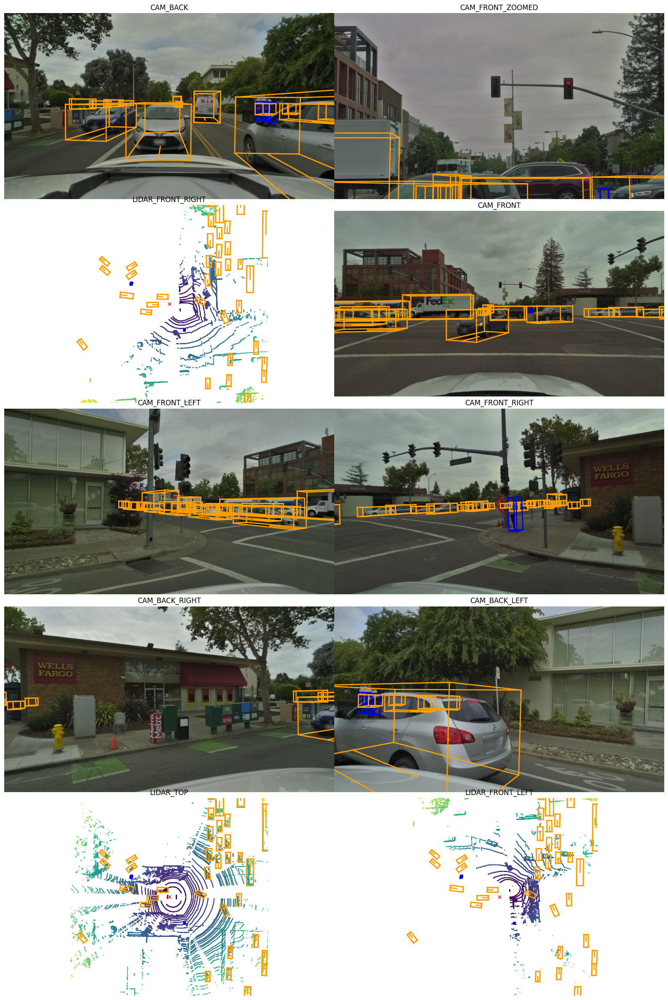

In [17]:
#retrieving the first token of the first sample in my_scene
my_sample_token = my_scene["first_sample_token"]
#my_sample_token = lyft_data.get("sample", my_sample_token)["next"]  # proceed to next sample

#Rendors sensor data and annotated objects associated with that specific sample
lyft_data.render_sample(my_sample_token)

In [18]:
#Placing the above code in a re-usable function (sourced from Tarun Paparaju)
#We can now change the scene; the function still only takes the first sample of the respective scene

def render_scene(index):
    my_scene = lyft_data.scene[index]
    my_sample_token = my_scene["first_sample_token"]
    lyft_data.render_sample(my_sample_token)

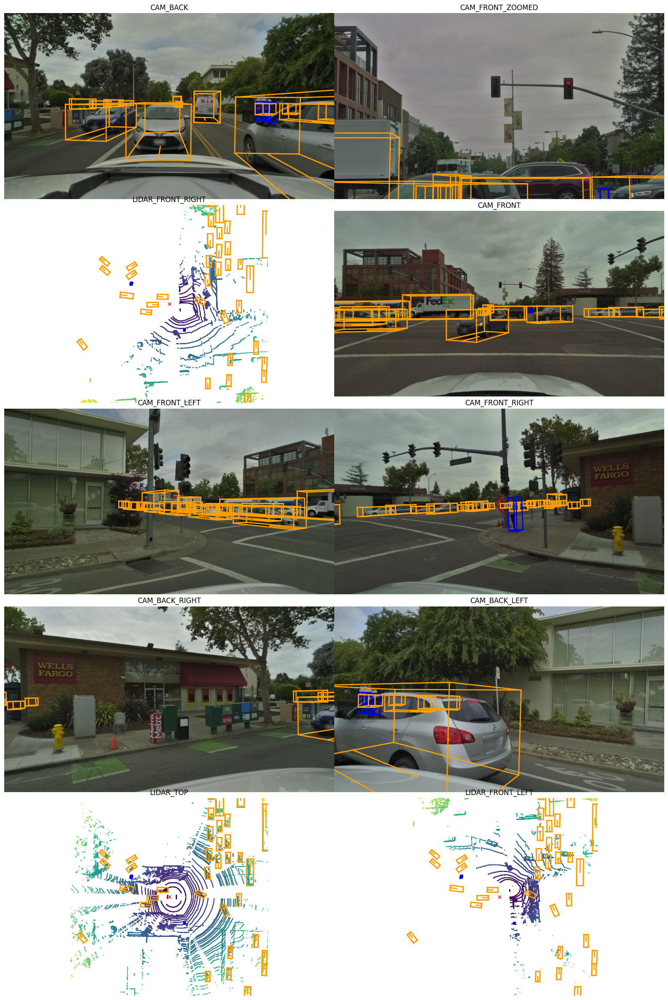

In [19]:
render_scene(0)

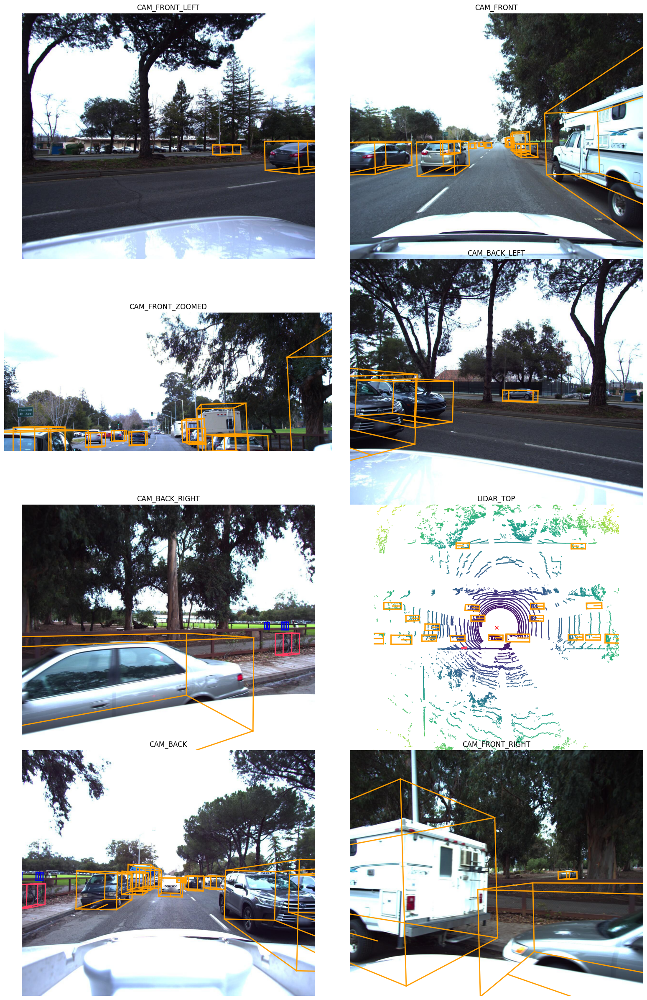

In [20]:
render_scene(1)

In [21]:
#Examine the metadata
#next - token of the next sample
#prev - previous token of the sample
#token - specific sample's token
#timestamp - sample's timestamp (used for time between samples and velocity)
#scene_token - token of the sample's scene
#data - dictionary with various sensor tokens (CAM_BACK, LIDAR_TOP, CAM_FRONT_LEFT_, etc.)
#anns - list of annotation tokens

#This line retrieves the details of a specific sample (my_sample_taken) defined above
#A sample in this dataset represents a snapshot in time within a scene; it contains images, lidar data, and annotations
my_sample = lyft_data.get('sample', my_sample_token)
my_sample

{'next': 'c2ba18e4414ce9038ad52efab44e1a0a211ff1e6b297a632805000510756174d',
 'prev': '',
 'token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'timestamp': 1557858039302414.8,
 'scene_token': 'da4ed9e02f64c544f4f1f10c6738216dcb0e6b0d50952e158e5589854af9f100',
 'data': {'CAM_BACK': '542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4',
  'CAM_FRONT_ZOOMED': '9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e',
  'LIDAR_FRONT_RIGHT': '8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff',
  'CAM_FRONT': 'fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0',
  'CAM_FRONT_LEFT': 'f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c',
  'CAM_FRONT_RIGHT': '5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40',
  'CAM_BACK_RIGHT': 'ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d',
  'CAM_BACK_LEFT': '01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23c8b4b',
  'LIDAR

In [22]:
#Sourced from nuscenes-devkit - tutorial_lyft.ipynb
#Listing all related sample_data keyframes and sample_annotations associated with a sample
lyft_data.list_sample(my_sample['token'])

Sample: 24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8

sample_data_token: 542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4, mod: camera, channel: CAM_BACK
sample_data_token: 9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e, mod: camera, channel: CAM_FRONT_ZOOMED
sample_data_token: 8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff, mod: lidar, channel: LIDAR_FRONT_RIGHT
sample_data_token: fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0, mod: camera, channel: CAM_FRONT
sample_data_token: f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c, mod: camera, channel: CAM_FRONT_LEFT
sample_data_token: 5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40, mod: camera, channel: CAM_FRONT_RIGHT
sample_data_token: ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d, mod: camera, channel: CAM_BACK_RIGHT
sample_data_token: 01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23

In [23]:
# Starting with the first sample token
current_sample_token = my_sample["token"]

# Iterate through a few consecutive samples (let's say 5 samples for example)
num_samples = 5
for _ in range(num_samples):
    current_sample = lyft_data.get("sample", current_sample_token)
    next_sample_token = current_sample["next"]

    if next_sample_token:
        next_sample = lyft_data.get("sample", next_sample_token)
        time_diff = (next_sample["timestamp"] - current_sample["timestamp"]) * 1e-6  # Convert to seconds
        print(f"Current Sample: {current_sample['token']}")
        print(f"Next Sample: {next_sample['token']}")
        print(f"Time Difference: {time_diff:.3f} seconds\n")

        # Move to the next sample
        current_sample_token = next_sample_token
    else:
        print("No more samples available.")
        break



Current Sample: 24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8
Next Sample: c2ba18e4414ce9038ad52efab44e1a0a211ff1e6b297a632805000510756174d
Time Difference: 0.200 seconds

Current Sample: c2ba18e4414ce9038ad52efab44e1a0a211ff1e6b297a632805000510756174d
Next Sample: 57c823209ea714288c2f56a3bf2510a9f02db43310ee3631a7d678b191645e12
Time Difference: 0.200 seconds

Current Sample: 57c823209ea714288c2f56a3bf2510a9f02db43310ee3631a7d678b191645e12
Next Sample: 29fd7d429450b8ac7478323ef9d5eede87fd184d74c3c36cd2e2853281043459
Time Difference: 0.200 seconds

Current Sample: 29fd7d429450b8ac7478323ef9d5eede87fd184d74c3c36cd2e2853281043459
Next Sample: 282b5aec05ed14275e0a7fb3f785c4cb4ad096a0faee0c5bf1d42122c646d194
Time Difference: 0.200 seconds

Current Sample: 282b5aec05ed14275e0a7fb3f785c4cb4ad096a0faee0c5bf1d42122c646d194
Next Sample: 77b06d3bf949065494854130baf017b26bad5644e32a22a47d2b0fea4b2e6202
Time Difference: 0.200 seconds



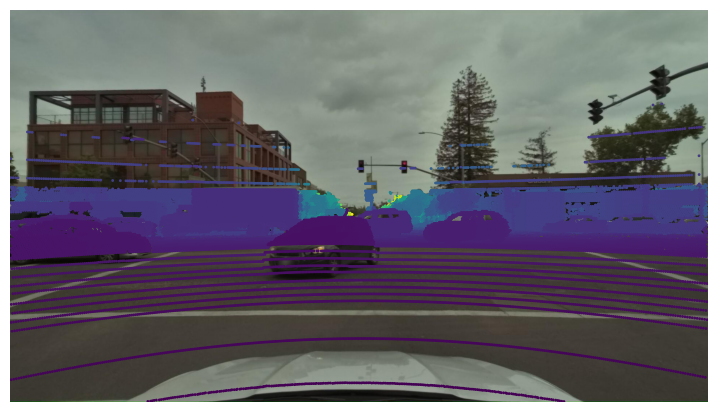

In [24]:
#Sourced from nuscenes-devkit - tutorial_lyft.ipynb
#Projecting lidar pointcloud onto an image. A pointcloud is a set of contours representing object distance. 
#Darker colors (purple/blue) represent closer objects
#Lighter colors (yellow and green) represent farther objects

lyft_data.render_pointcloud_in_image(sample_token = my_sample["token"],
                                      dot_size = 1,
                                      camera_channel = 'CAM_FRONT')

Sourced from nuscenes-devkit - tutorial.ipynb

"The dataset contains data that is collected from a full sensor suite. Hence, for each snapshot of a scene, we provide references to a family of data that is collected from these sensors."

In [25]:
my_sample['data']

{'CAM_BACK': '542a9e44f2e26221a6aa767c2a9b90a9f692c3aee2edb7145256b61e666633a4',
 'CAM_FRONT_ZOOMED': '9c9bc711d93d728666f5d7499703624249919dd1b290a477fcfa39f41b26259e',
 'LIDAR_FRONT_RIGHT': '8cfae06bc3d5d7f9be081f66157909ff18c9f332cc173d962460239990c7a4ff',
 'CAM_FRONT': 'fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0',
 'CAM_FRONT_LEFT': 'f47a5d143bcebb24efc269b1a40ecb09440003df2c381a69e67cd2a726b27a0c',
 'CAM_FRONT_RIGHT': '5dc54375a9e14e8398a538ff97fbbee7543b6f5df082c60fc4477c919ba83a40',
 'CAM_BACK_RIGHT': 'ae8754c733560aa2506166cfaf559aeba670407631badadb065a9ffe7c337a7d',
 'CAM_BACK_LEFT': '01c0eecd4b56668e949143e02a117b5683025766d186920099d1e918c23c8b4b',
 'LIDAR_TOP': 'ec9950f7b5d4ae85ae48d07786e09cebbf4ee771d054353f1e24a95700b4c4af',
 'LIDAR_FRONT_LEFT': '5c3d79e1cf8c8182b2ceefa33af96cbebfc71f92e18bf64eb8d4e0bf162e01d4'}

Examining the metadata of CAM_FRONT for the current sample.
Width/Height - image dimensions, sensor type, timestamp data, etc.

In [26]:
sensor_channel = 'CAM_FRONT'  # also try this e.g. with 'LIDAR_TOP'
my_sample_data = lyft_data.get('sample_data', my_sample['data'][sensor_channel])
my_sample_data

{'width': 1920,
 'height': 1080,
 'calibrated_sensor_token': '8e73e320d1fa9e5af96059e6eb1dd7d28e3271dea04de86ead47fa25fd13fd20',
 'token': 'fb40b3b5b9d289cd0e763bec34e327d3317a7b416f787feac0d387363b4d00f0',
 'sample_token': '24b0962e44420e6322de3f25d9e4e5cc3c7a348ec00bfa69db21517e4ca92cc8',
 'is_key_frame': True,
 'prev': '',
 'fileformat': 'jpeg',
 'ego_pose_token': '0c257254dad346c9d90f7970ce2c0b8142f7c6e6a90716f4c0538cd2d2ef77d5',
 'timestamp': 1557858039250000.0,
 'next': '00ba71deb97524b5d9be9b677962b74bb32f89284ad7838462250218786b903e',
 'filename': 'images/host-a101_cam0_1241893239250000006.jpeg',
 'sensor_modality': 'camera',
 'channel': 'CAM_FRONT'}

Creating an image that uses the above defined 'my_sample_data'. This output will show the image provided by the specified sensor channel

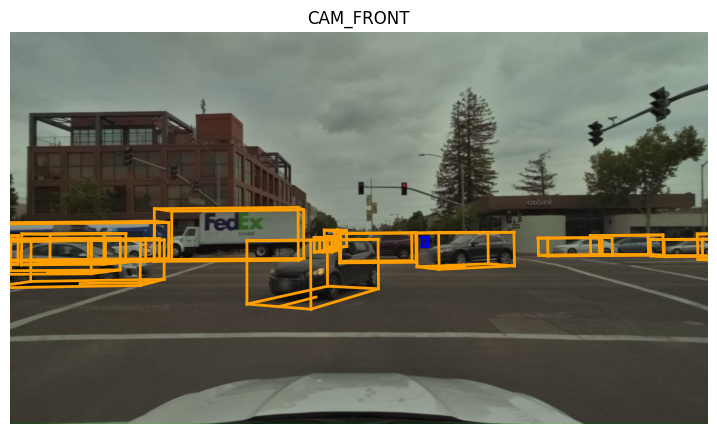

In [27]:
lyft_data.render_sample_data(my_sample_data['token'])

Instances - "Object instances are instances that need to be detected or tracked by an AV... We generally track an instance across different frames in a particular scene. However, we do not track them across different scenes. In this example, we have 16 annotated samples for this instance across a particular scene.

In [28]:
my_instance = lyft_data.instance[100]
my_instance

{'last_annotation_token': '17be5c0175d3f4e36b9829d4789a6174d531637587107a0bfa1f3668d1ed9a57',
 'category_token': '8eccddb83fa7f8f992b2500f2ad658f65c9095588f3bc0ae338d97aff2dbcb9c',
 'token': '0984d7f7d64a8a03523e43ea01c7292488bd73ae745514077b28a9dc240b9f95',
 'first_annotation_token': 'b1f924cb04786ef4d46810ef8c3e7fe17597d4464507267dc56dcfbe1faa6581',
 'nbr_annotations': 56}

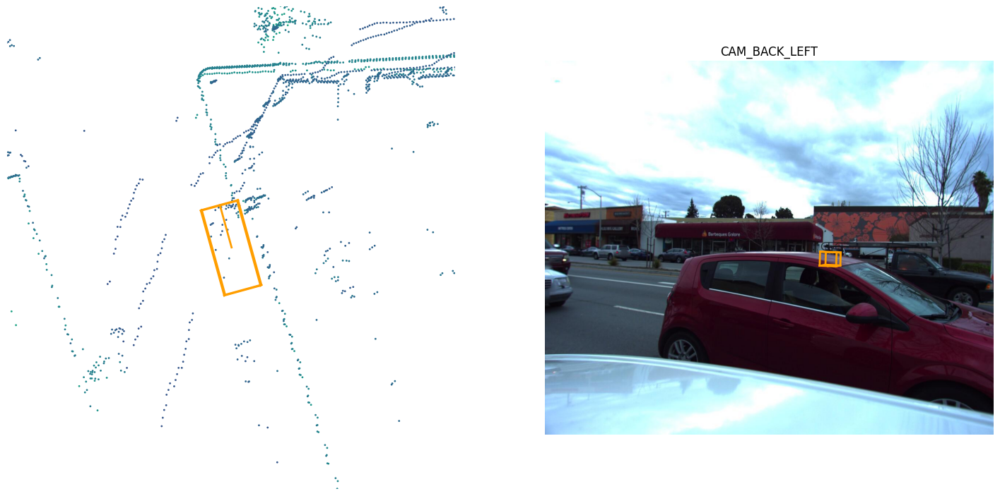

In [29]:
instance_token = my_instance['token']
lyft_data.render_instance(instance_token)

First annotated sample of this instance:
Last annotated sample of this instance


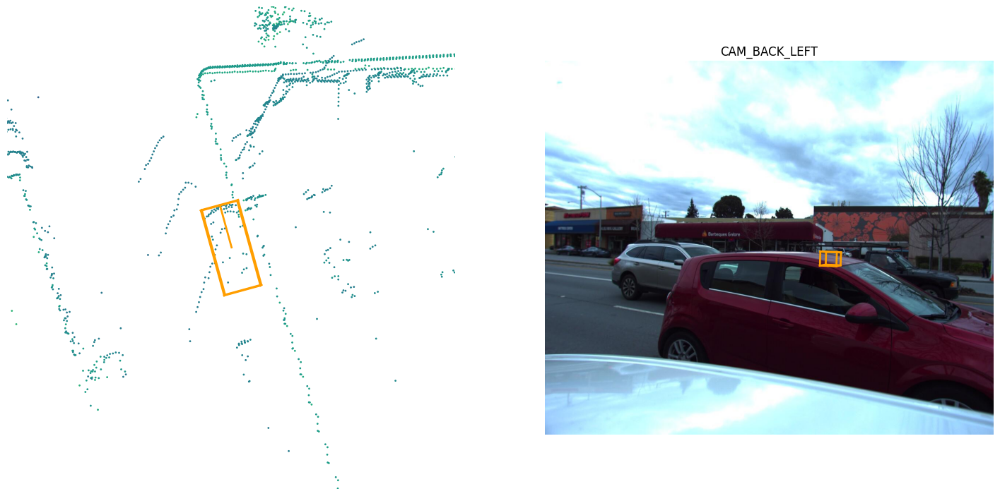

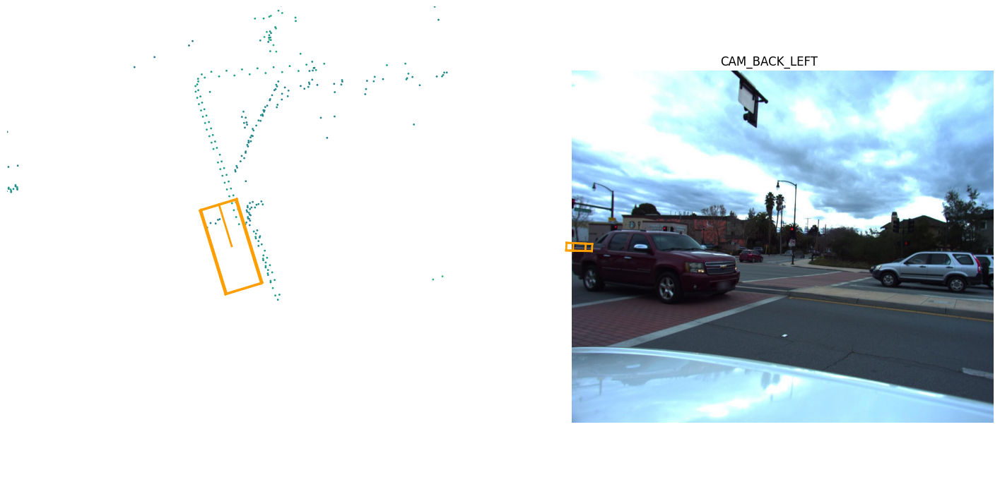

In [30]:
#Instance record takes first and last annotation token.

print("First annotated sample of this instance:")
lyft_data.render_annotation(my_instance['first_annotation_token'])

print("Last annotated sample of this instance")
lyft_data.render_annotation(my_instance['last_annotation_token'])

---------------------------- COME BACK TO THE TUTORIAL SCRIPT --------------------------------

OTHER EDA - HISTOGRAMS, NUMERICAL DATA, DISTRIBUTIONS
Sources: Beluga "EDA - 3D Object Detection Challenge"
         Tarun Paparaju "Lyft Competition: Understanding the Data"

In [31]:
#Create an augmented dataframe
print(f'train_df: {train_df.shape}')
train_df.head(2)

train_df: (22680, 2)


,Id,PredictionString
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2680.2830359778527 698.1969292852777 -18.04776...
1,edf37c1fb1024ba0c1f53ebbf10b6797f781199a9f0e4e...,1208.642684768659 1585.1812946970927 -23.56236...


As we can see, the train csv contains 22,680 train samples.

The chunk below parses the parameters into seperate columns in a dataframe for further feature analysis (EDA). 

In [32]:
#Define column names
object_columns = ['sample_id', 'object_id', 'center_x', 'center_y', 'center_z',
                  'width', 'length', 'height', 'yaw', 'class_name']


#Creates an empty list to store object details
objects = []

#Looping through the training data
for sample_id, ps in tqdm(train_df.values[:]):
    object_params = ps.split()              #splits parameter string inot a list of individual values (x,y,z,w,l,h,yaw,class_name)
    n_objects = len(object_params)          #Calculates total number of parameters in the sample
    for i in range(n_objects // 8):         #Divdes total parameters by 8 (each object represented by 8 parameters)
        x, y, z, w, l, h, yaw, c = tuple(object_params[i * 8: (i + 1) * 8])
        objects.append([sample_id, i, x, y, z, w, l, h, yaw, c])           #Appends extracted parameters, sample id, and object id to the objects list
train_objects = pd.DataFrame(                                #Turning the objects list into a DataFrame
    objects,
    columns = object_columns
)

#Converting columns to float data type for computations (center_x, center_y, center_z, width, length, height)
#Adding 'confidence' column and sets default value at 1.0 for every object
for col in object_columns[2:-1]:
    train_objects[col] = train_objects[col].astype('float')
train_objects['confidence'] = 1.0

  0%|          | 0/22680 [00:00<?, ?it/s]

In [33]:
train_objects.head()

,sample_id,object_id,center_x,center_y,center_z,width,length,height,yaw,class_name,confidence
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,0,2680.283036,698.196929,-18.047767,2.064,5.488,2.053,2.604164,car,1.0
1,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,1,2691.997462,660.801654,-18.674259,1.818,4.570,1.608,-0.335176,car,1.0
2,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2,2713.607501,694.403481,-18.589972,1.779,4.992,1.620,2.579456,car,1.0
3,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,3,2679.986917,706.910150,-18.349594,1.798,3.903,1.722,2.586166,car,1.0
4,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,4,2659.352096,719.417462,-18.442999,1.936,4.427,1.921,2.601799,car,1.0


In [34]:
print(f"DataFrame shape: {train_objects.shape}")
print(train_objects.dtypes)

DataFrame shape: (638179, 11)
sample_id      object
object_id       int64
center_x      float64
center_y      float64
center_z      float64
width         float64
length        float64
height        float64
yaw           float64
class_name     object
confidence    float64
dtype: object


In [35]:
# List column names
print(train_objects.columns)

Index(['sample_id', 'object_id', 'center_x', 'center_y', 'center_z', 'width',
       'length', 'height', 'yaw', 'class_name', 'confidence'],
      dtype='object')


In [36]:
print(train_objects.describe())


           object_id       center_x       center_y       center_z  \
count  638179.000000  638179.000000  638179.000000  638179.000000   
mean       18.897229    1715.069665    1372.186384     -20.369027   
std        14.524981     640.835671     560.929774       2.843186   
min         0.000000     366.763064     309.814266     -24.985069   
25%         7.000000    1161.721817     926.375533     -22.694964   
50%        16.000000    1554.106494    1383.464471     -20.140146   
75%        28.000000    2315.286364    1646.055137     -18.649414   
max       129.000000    3205.812665    3642.478804       6.136931   

               width         length         height            yaw  confidence  
count  638179.000000  638179.000000  638179.000000  638179.000000    638179.0  
mean        1.915676       4.905273       1.851623       0.829982         1.0  
std         0.461967       1.973170       0.536324       1.709260         0.0  
min         0.223000       0.261000       0.333000      -3

          center_x  center_y  center_z     width    length    height       yaw
center_x  1.000000 -0.915485  0.432386  0.151324  0.136732  0.087091  0.093070
center_y -0.915485  1.000000 -0.142457 -0.135843 -0.123597 -0.059317 -0.108269
center_z  0.432386 -0.142457  1.000000  0.140108  0.143586  0.165326  0.013547
width     0.151324 -0.135843  0.140108  1.000000  0.835988  0.675244  0.119748
length    0.136732 -0.123597  0.143586  0.835988  1.000000  0.742597  0.145861
height    0.087091 -0.059317  0.165326  0.675244  0.742597  1.000000  0.156779
yaw       0.093070 -0.108269  0.013547  0.119748  0.145861  0.156779  1.000000


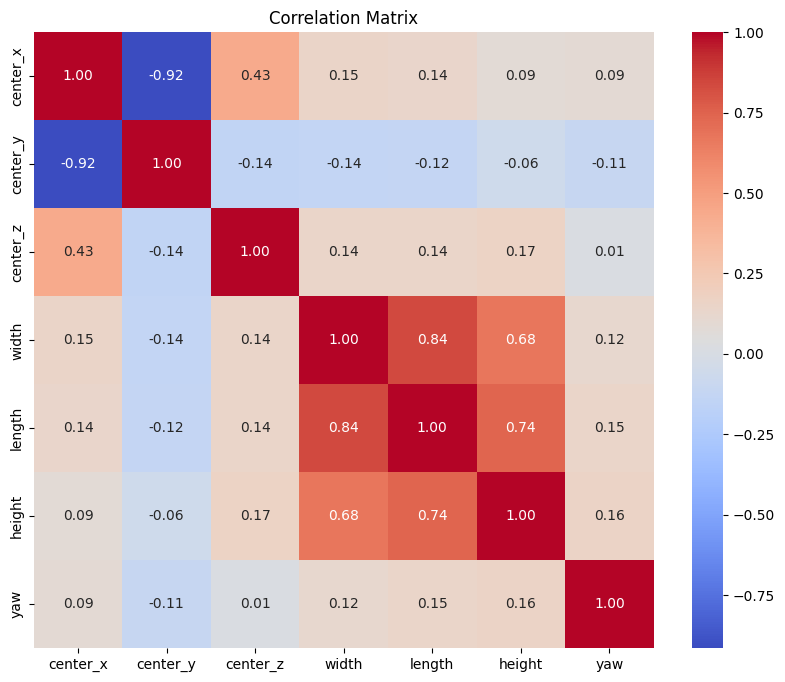

In [37]:
columns_of_interest = ['center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']
correlation_matrix = train_objects[columns_of_interest].corr()
print(correlation_matrix)

# Generate a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()



The correlation matrix above shows strong insights about some of the data. 
1. center_x vs center_y: -.915 (strong negative correlation): shows the trend that as center_x increases, center_y decreases. In other words; the cameras and sensors on the car can measure objects far ahead but not as far left and right (wide) or objects far to the left or right, but not too far ahead. There is a tradeoff.
2. width vs length: .836 (positive correlation): Objects with large widths tend to have large lengths... objects with small widths tend to have small lengths. Positive correlation for each with height, but weaker.

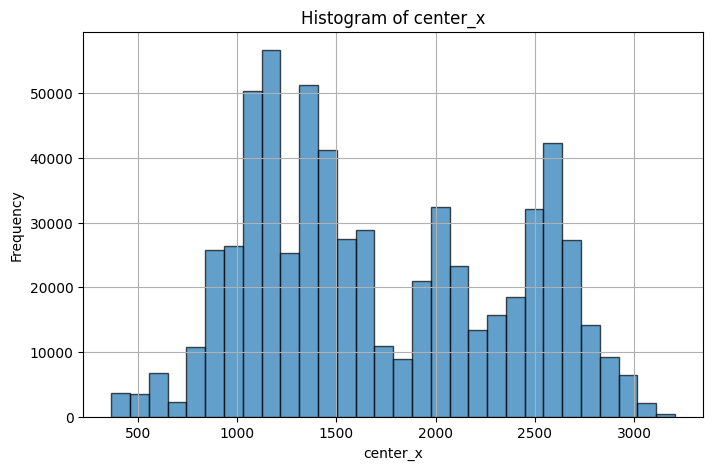

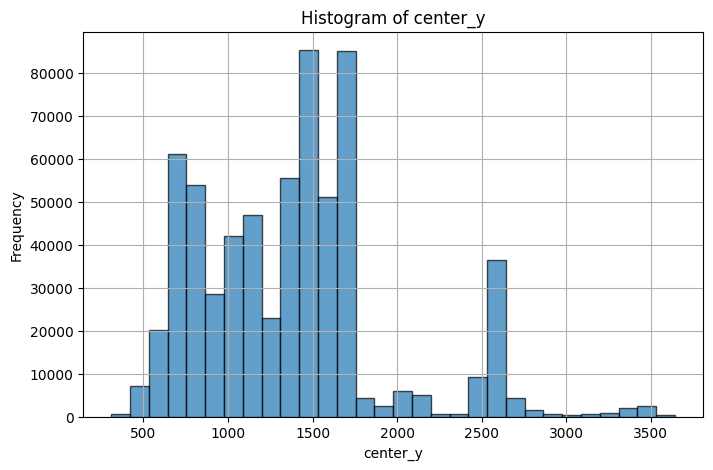

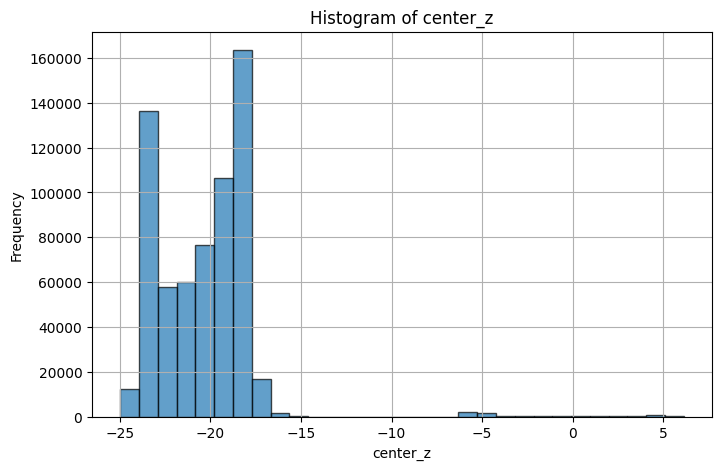

<Figure size 1000x600 with 0 Axes>

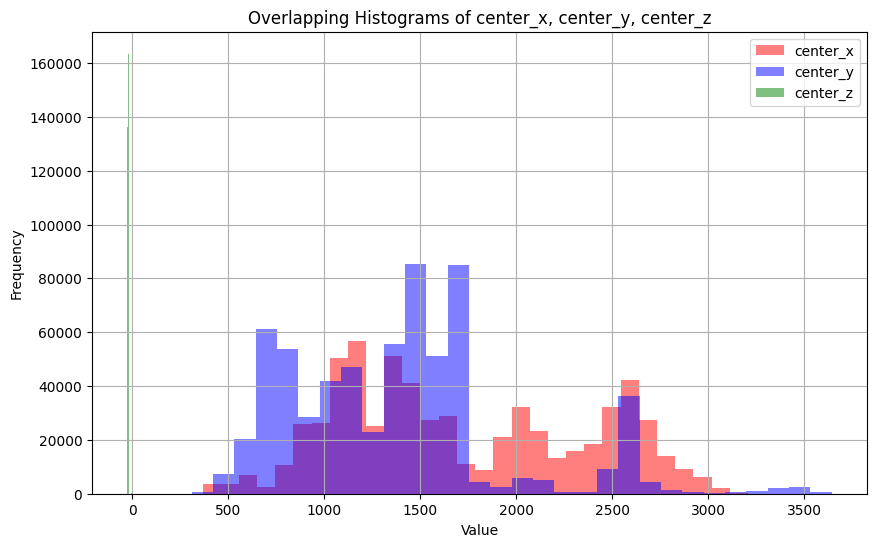

In [38]:
# Separate histograms
columns = ['center_x', 'center_y', 'center_z']

for col in columns:
    plt.figure(figsize=(8, 5))
    plt.hist(train_objects[col], bins=30, edgecolor='black', alpha=0.7)
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

plt.figure(figsize=(10, 6))

plt.figure(figsize=(10, 6))

# Define colors for each histogram
colors = ['red', 'blue', 'green']
columns = ['center_x', 'center_y', 'center_z']

# Plot all histograms with slightly higher opacity
for col, color in zip(columns, colors):
    plt.hist(train_objects[col], bins=30, alpha=0.5, label=col, color=color)

plt.title('Overlapping Histograms of center_x, center_y, center_z')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

1. Center_x: The histogram of center_x is multimodal with at 1100-1200, 2100, and 2600. The distribution has a right skew. The center_x distribution is the most spread out or uniform among the three axes (x, y, and z). This means objects are most spread evenly across the x-axis more so than the other two axes.
2. Center_y: The histogram of of center_y is multimodal with peaks at 700-800 and 1500-1700. There is, what appears to be, an outlier peak at about 2600 that is causing a heavy right skew in the distribution. This is evidence that objects are not as uniformly spread out across the y-axis and tend to be concentrated between 700-1700.
3. Center_z: The distribution of center_z appears to be bimodal with peaks at -24 and -18, with most of the distribution falling between that range. The data is has a right skew with some outliers at -5,-4, 5, and 6. This suggests most of the detected object lie below the LiDAR sensors on top of the vehicle. This makes sense from the higher vantage point of the z-axis. There is less variation in the distribution of center_z values, implying that most of the detected objects lie within a similar height range (most likely close to or on the road/ground surface). There are not as many objects being detected at high elevations. 

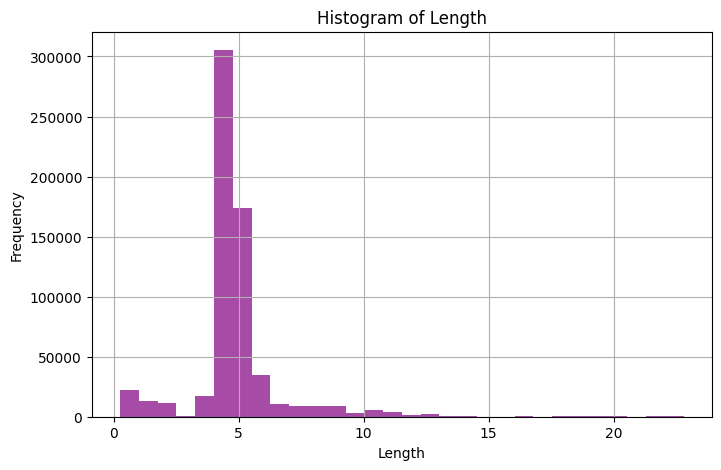

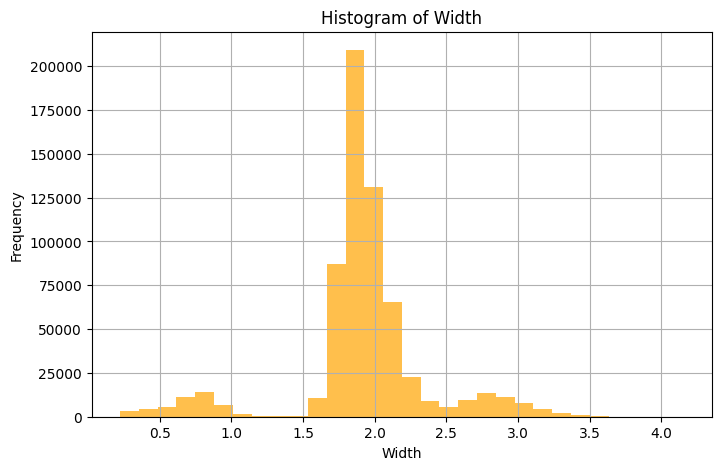

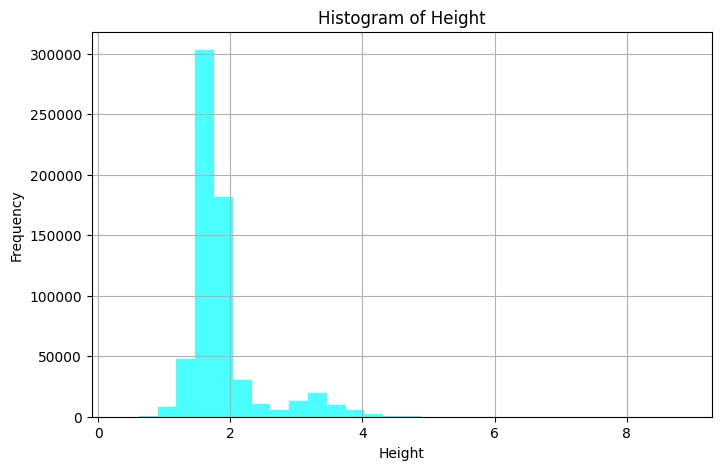

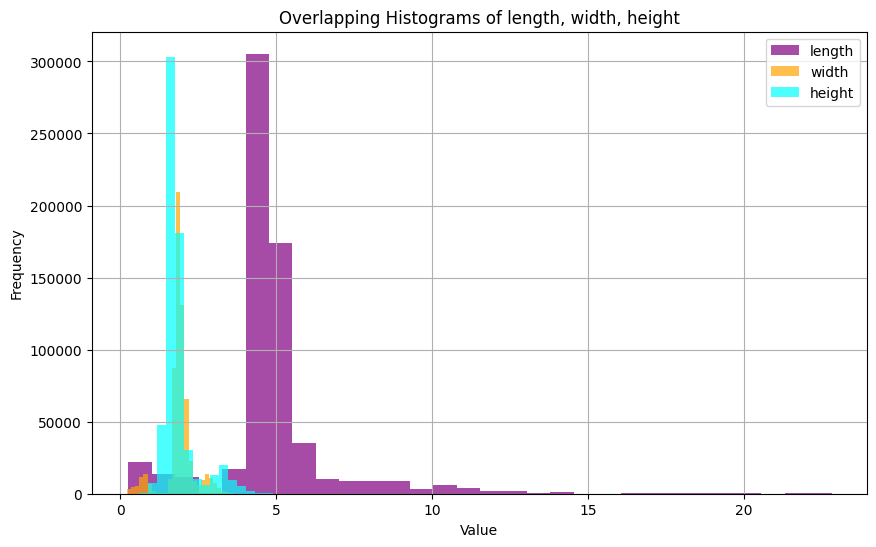

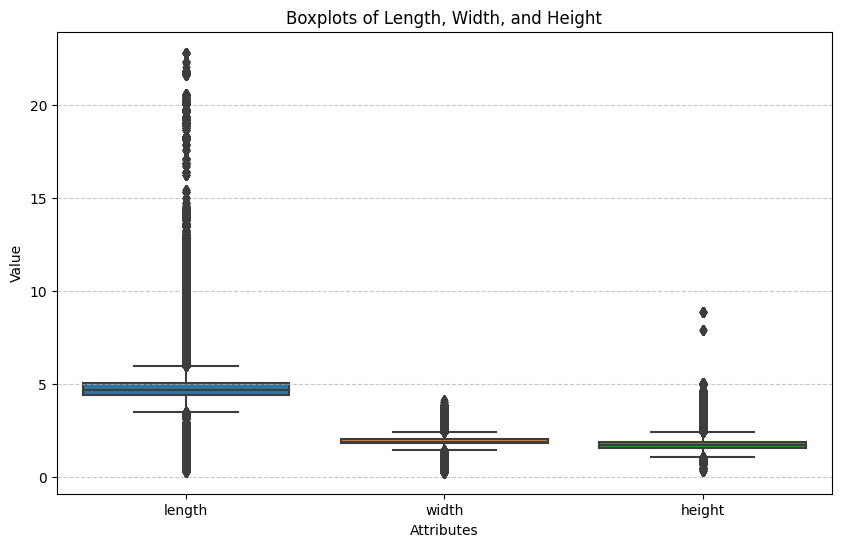

In [39]:
# Plot for 'length'
plt.figure(figsize=(8, 5))
plt.hist(train_objects['length'], bins=30, color='purple', alpha=0.7)
plt.title('Histogram of Length')
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Plot for 'width'
plt.figure(figsize=(8, 5))
plt.hist(train_objects['width'], bins=30, color='orange', alpha=0.7)
plt.title('Histogram of Width')
plt.xlabel('Width')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Plot for 'height'
plt.figure(figsize=(8, 5))
plt.hist(train_objects['height'], bins=30, color='cyan', alpha=0.7)
plt.title('Histogram of Height')
plt.xlabel('Height')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

plt.figure(figsize=(10, 6))
# Define colors for each histogram
colors = ['purple', 'orange', 'cyan']
columns = ['length', 'width', 'height']

# Plot all histograms with slightly higher opacity
for col, color in zip(columns, colors):
    plt.hist(train_objects[col], bins=30, alpha=0.7, label=col, color=color)

plt.title('Overlapping Histograms of length, width, height')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.legend()
plt.grid(True)
plt.show()

# Create a boxplot for length, width, and height side by side
plt.figure(figsize=(10, 6))
sns.boxplot(data=train_objects[['length', 'width', 'height']])
plt.title('Boxplots of Length, Width, and Height')
plt.ylabel('Value')
plt.xlabel('Attributes')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



1. Histogram of Length: The distribution of length shows a normal distribution with a mean of about 5 meters with a right skew (although there are outliers on each side of the mean). This makes sense as most of the objects detected on the road are cars (as seen below) and a length of about 5 meters (about 16.5 feet). The average car length is estimated to be 14.7 feet (carparts.com). Longer vehicles such as trucks will pull the average slightly higher and large objects such as buildings and houses may account for some of the high value outliers.
2. Width Histogram: The distrution of width shows a normal distribution with a mean of about 1.9 meters. Similar to length, there are outliers on each side of the distribution. However, there are even amounts of outliers on both sides of the distribution. Lower values will represent objects with smaller widths such as bikers and pedestrians. Values with larger widths will be vans, trucks, and other larger road objects. Cars represent the peak with an average width of around 2 meters.
3. Height Histogram: The height distribution shows a heavy right skewed normal distribution with a mean of about 1.8 meters. There are outliers on both sides of the distribution, but many more on the right side. Similar to width; smaller height objects are going to represent bikes and pedestrians, the mean will represent mostly cars, and the larger outliers will represent taller vehicles like trucks.  

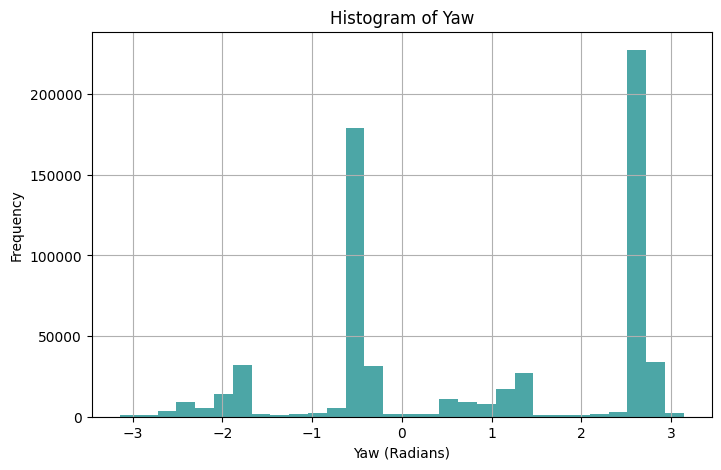

In [40]:
plt.figure(figsize=(8, 5))
plt.hist(train_objects['yaw'], bins=30, color='teal', alpha=0.7)
plt.title('Histogram of Yaw')
plt.xlabel('Yaw (Radians)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()


The above histogram of yaw represents the distribution of orientation angles of objects. A yaw of 0 represents objects that are aligned with the world's x-axis. Positive valies represent clockwise rotation of the x-axis (in radians), where negative values represent a counterclockwise rotation. The histogram shows a bimodal distribution with peaks at about -.5 and 2.7, indicating two dominant orientations of detected objects. These could represent objects coming towards teh ego vehicle and away (objects in the left and right driving lanes). 

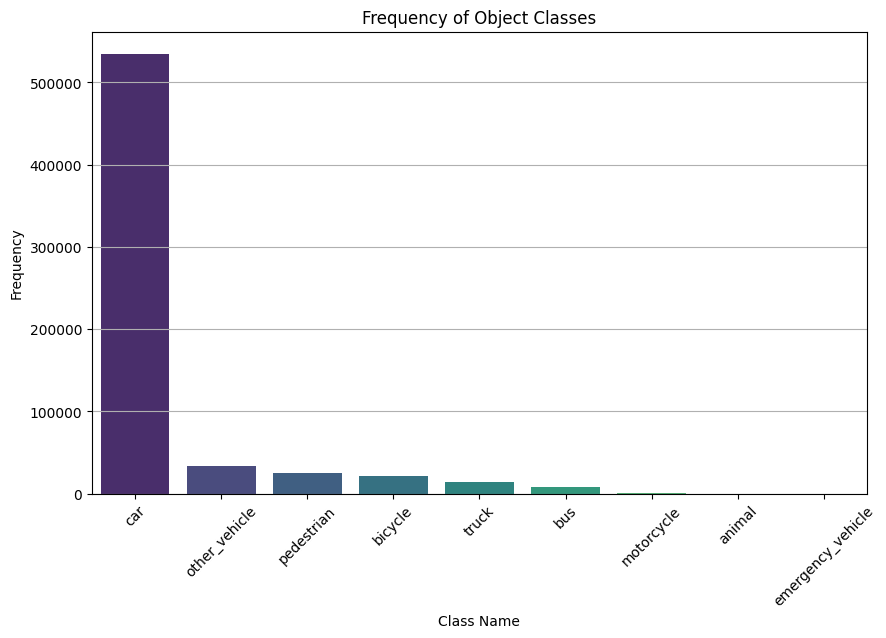

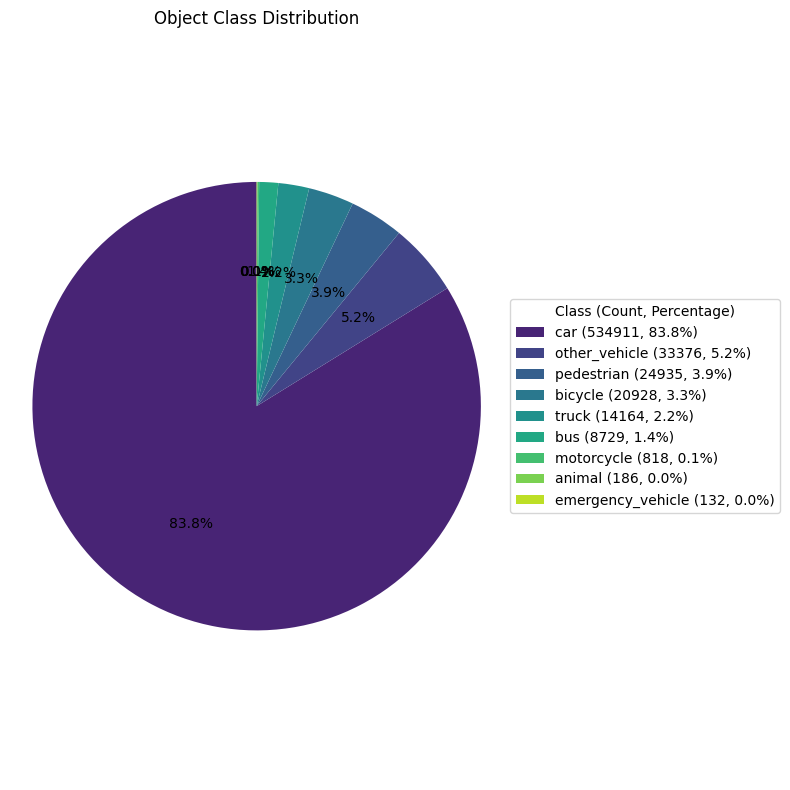

In [41]:
# Frequency table for object classes
class_frequency = train_objects['class_name'].value_counts()

# Plotting the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x=class_frequency.index, y=class_frequency.values, palette='viridis')
plt.title('Frequency of Object Classes')
plt.xlabel('Class Name')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()



#Pie Chart
# Calculate percentages
class_percentages = (class_frequency / class_frequency.sum()) * 100
# Prepare legend labels with counts and percentages
legend_labels = [f"{cls} ({count}, {percent:.1f}%)" for cls, count, percent in zip(class_frequency.index, class_frequency.values, class_percentages)]

# Plot the pie chart
plt.figure(figsize=(8, 8))
plt.pie(class_frequency.values, labels=None, autopct='%1.1f%%', startangle=90, colors=sns.color_palette('viridis', len(class_frequency)))
plt.title('Object Class Distribution')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

# Add legend outside the plot
plt.legend(legend_labels, title="Class (Count, Percentage)", loc='center left', bbox_to_anchor=(1, 0.5))
# Show the plot
plt.tight_layout()
plt.show()


As we can see from the bar and pie chart, 'car' is by far the most frequent object class detected in the dataset representing almost 84% of the detected objects (535,000+ detections). The second most is 'other_vehicle' at just 5.2% or 33,000 observations. The lowest detected class was "emergency_vehicle" at just .1% or 132 observations. 

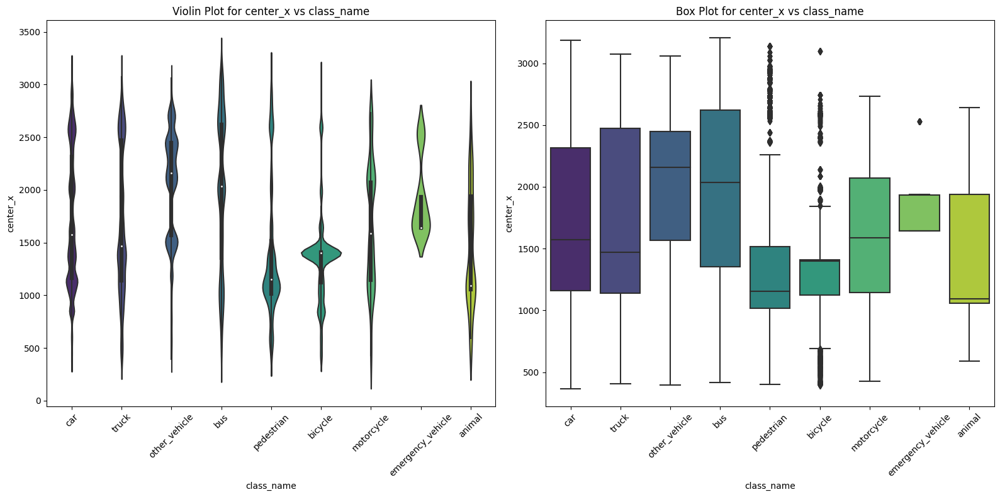

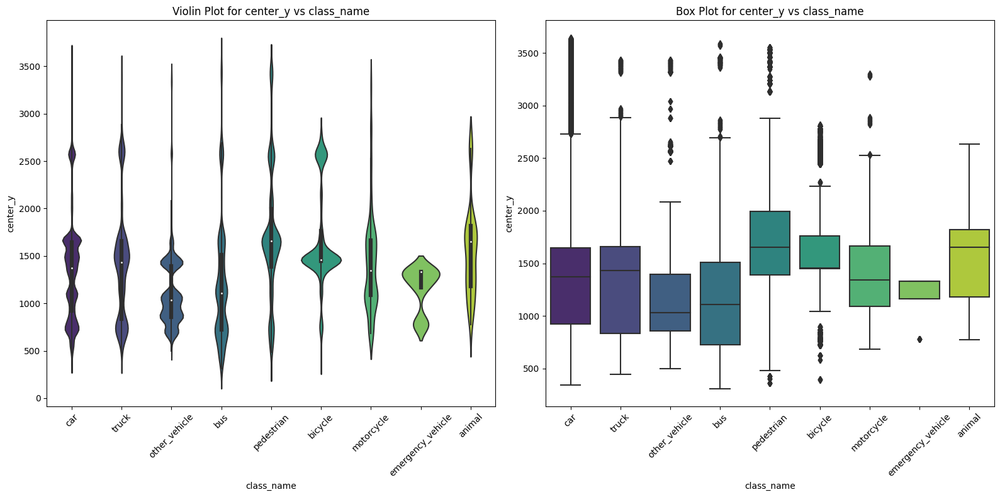

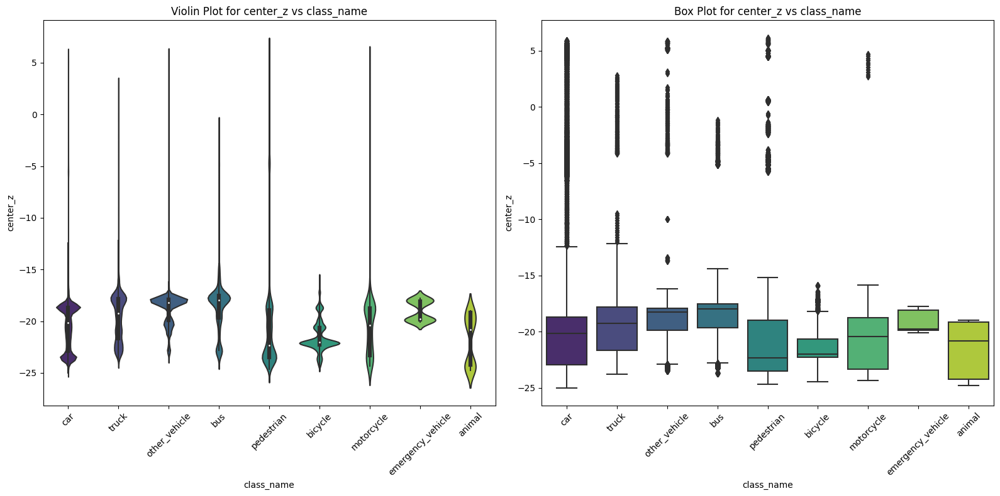

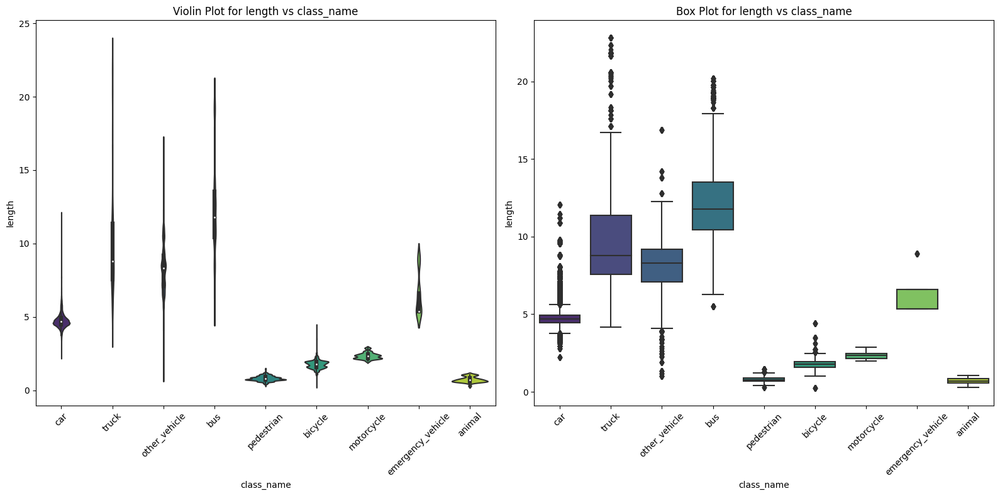

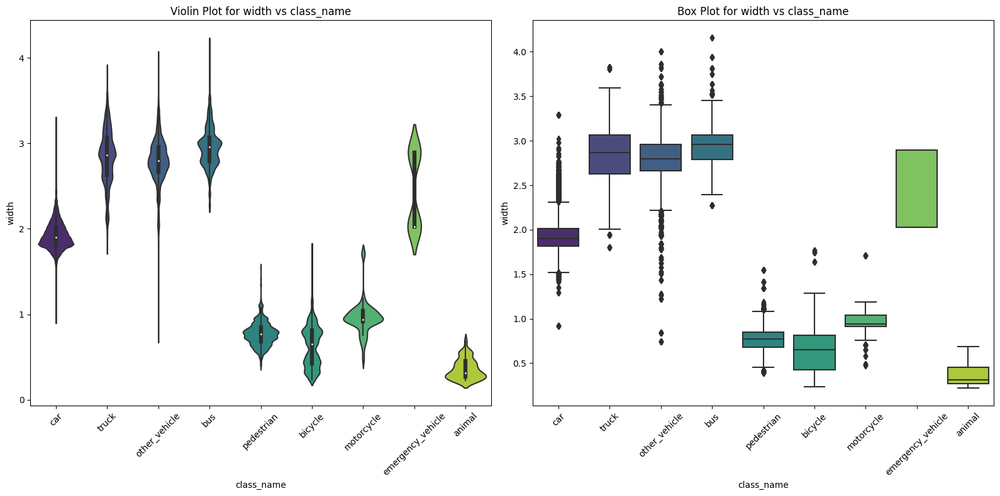

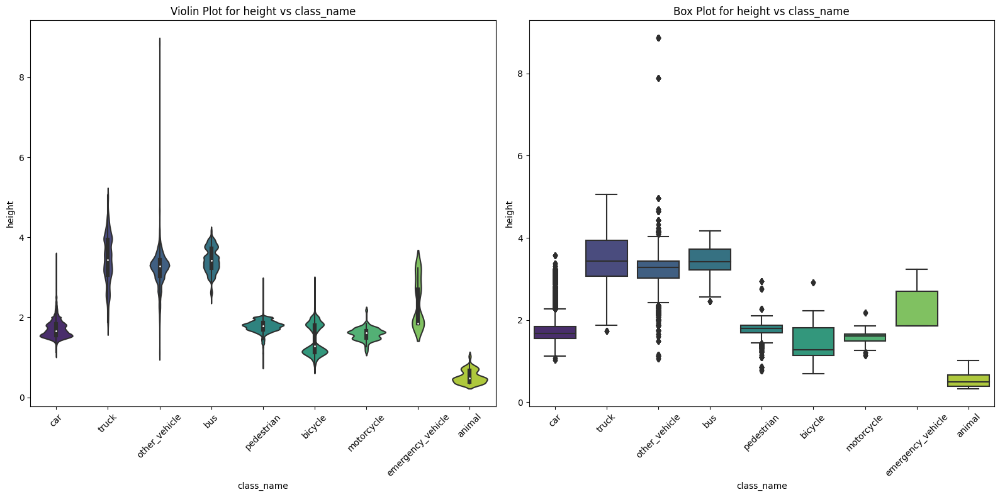

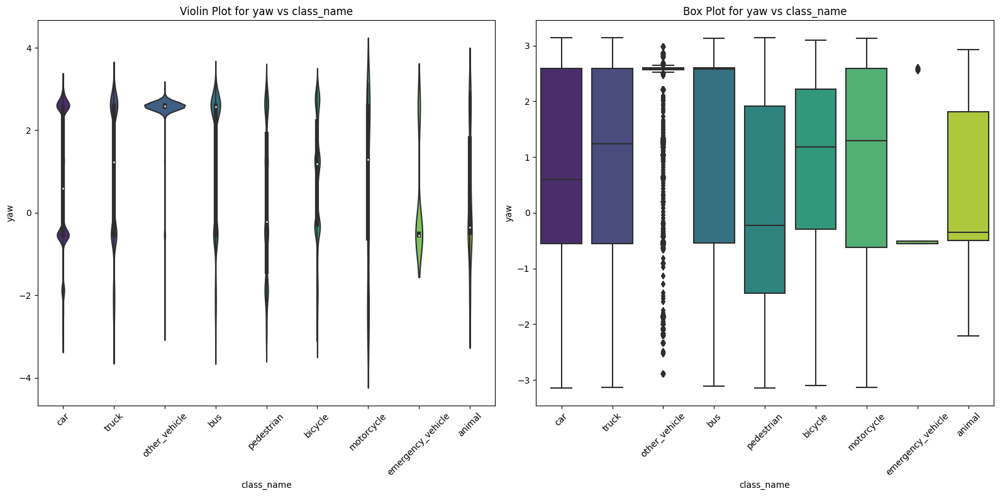

In [42]:
# List of numerical features to visualize
numerical_features = ['center_x', 'center_y', 'center_z', 'length', 'width', 'height', 'yaw']

# Create subplots for each feature, placing violin and box plots side by side
for i, feature in enumerate(numerical_features):
    fig, ax = plt.subplots(1, 2, figsize=(16, 8))  # 1 row, 2 columns for each feature
    
    # Violin plot
    sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
    ax[0].set_title(f'Violin Plot for {feature} vs class_name')
    ax[0].tick_params(axis='x', rotation=45)
    
    # Box plot
    sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
    ax[1].set_title(f'Box Plot for {feature} vs class_name')
    ax[1].tick_params(axis='x', rotation=45)
    
    plt.tight_layout()  # Adjust layout for neatness
    plt.show()


The below plots are a violin and box plots of class_name vs center_x, y, and z, length, width, height, and yaw. Voilin plots is a modification of a boxplot; showing data density at each point.

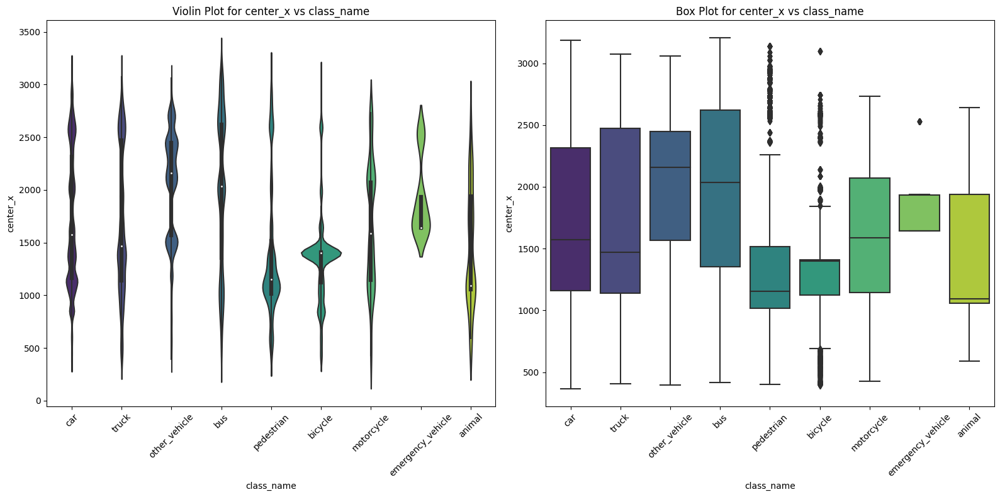

In [43]:
# Visualizing center_x
feature = 'center_x'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))  # 1 row, 2 columns for center_x

# Violin plot
sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

# Box plot
sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()  # Adjust layout for neatness
plt.show()

Center_x represents the forward-backward position of the detected objects. 

As seen from the voilin plot, the distribution of center_x across motor vehicles is fairly uniform with no outliers (it is important to note the observsation number between classes differs). This observation is most likely attributed to vehicles keeping their distance from one another on the road to avoid accidents. Cars generally avoid driving "on top" of each other/tailgating and driving in blind spots of other cars going the same way. Oncoming vehicles will be in the frame at a distance for more samples then the one or two samples the object will be in as it passes the ego vehicle. Buses have the max x_center value, most likely becuase it is the largest class of detected class. The pedestrian and bicycle class has a large spread, like motor vehicles. But unlike motor vehicles, those two classes contain many outliers; pedestrian only right skewed and bycle both left and right skewed. The pedestrian and bicyle classes have a more unimodal and concentrated distribution around the median (bulge in violin chart). Most detections in that object class are being detected around 1200-1500 mark (middle ground), a lower mean than the motor vehicles classes suggesting pedestrians and bicycles keep less forward-backward distance to the ego car. This could be caused in part by bike lanes, sidewalks, and crosswalks (pedestrians/bicycles generally have the right of way over moror vehicles).  

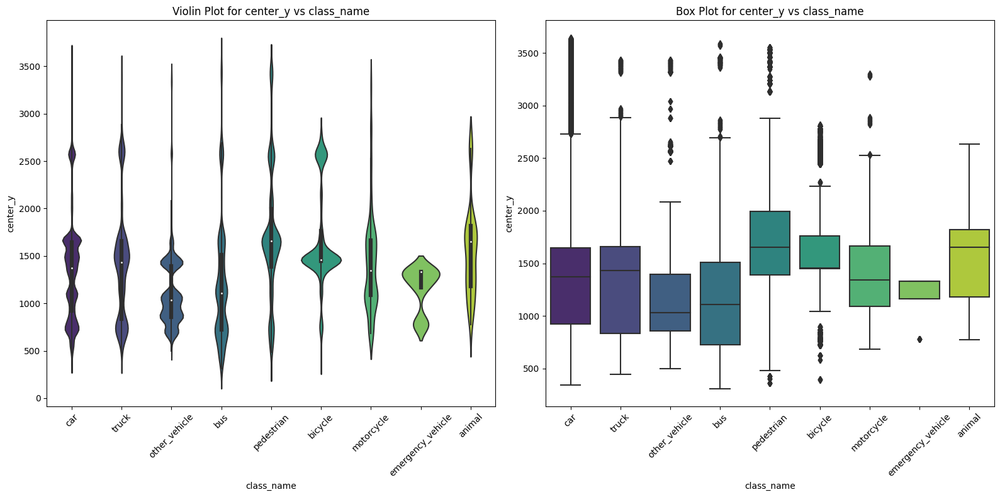

In [44]:
# Visulizing center_y
feature = 'center_y'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))  # 1 row, 2 columns for center_y

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Center-y represents the left-right position of the detected object.

The distribution for motor vehicles is concentrated at values less than 2000, with high value outliers for each motor vehicle. Smaller object classes like pedestrians and bicycles have a higher average center_y values and tend to be a bit more clustered (around 1600). This suggests that smaller object classes have larger center_y values (lateral position). This could be because pedestrians and bicycles are never directly infront of the vehicle. Smaller objects may also be harder to detect the closer they are to the ego vehicle. There are many more outliers across the whole dataset compared to the center_x distribution.  

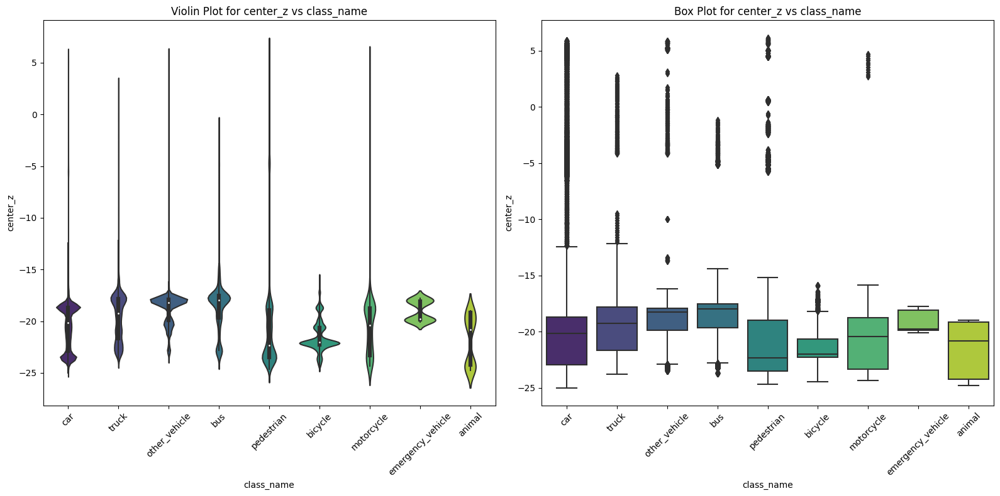

In [45]:
# Visualizing center_z
feature = 'center_z'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Center-z represents the up-down position of the detected objects (height). 

From the violin plots we can see, all classes tend to have relatively small center_z values compared to center_x and center_y, showing less variation in the height of objects than the forward-backwards or left-right location of objects. Smaller object classes like pedestrians and bicycles have a lower meadian and IQR than larger motor vehicles (median of about -23, -22). This suggests that pedestrians and bicyles have a smaller height than motor vehicles which is consistent with observations in real life. From the center_x distribution, we also know that those two classes are detected closer to the car in a front-back direction on average. The closer a pedestrian is to a car in that direction, the smaller height it will have in relation to the overhead LiDAR and cameras being used. Biclycle has the most data concentrated median, where pedestrian is more spread out. Motor vehicle classes have slightly higher center_z values, suggesting they have greater height (median values aroud -20). The fact almost all the data points for center_z are negative suggest the vantage point of the cameras and sensors is high up (on top of the car). In relation to the sensor, most objects around the ego car will look as if the height is smaller. Each class (other than emergency vehicle and animal who had less than .1% of the data), have outliers on the right side of the distribution. 

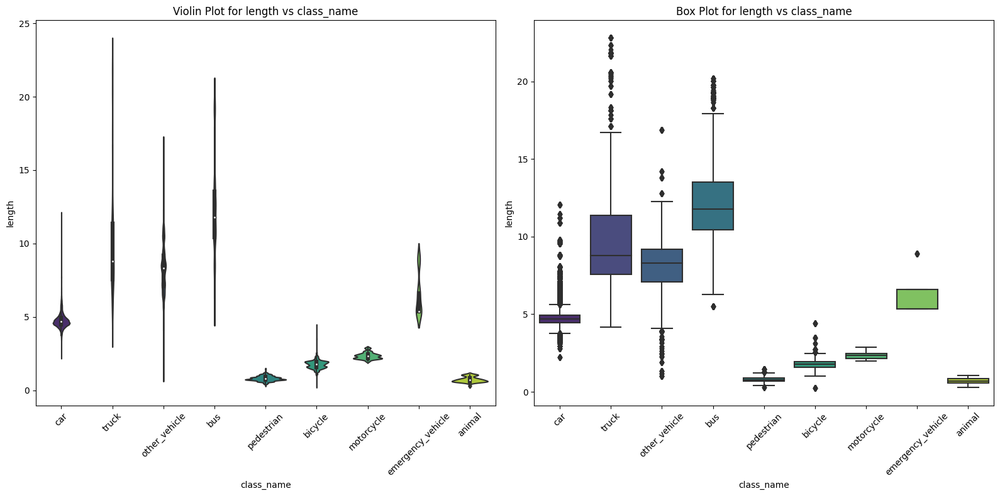

In [46]:
# Visualizing length
feature = 'length'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Length represents the length of detected objects in meters. 

Motor vehicle classes tend to have much larger length values than pedestrian classes (exception is motorcycles which are closer to bicyles in physical form). This is expected, as cars, other vehicles (vans), trucks, and busses all have greater lengths than one another respectively and have greater lengths than pedestrians and bikes. Cars median length is about 5 meters, truck: 8m, other: 7m, and bus: 12m. All of these numbers are around the true median value for these vehicle classes. The motor vehicle classes have less dense spreads and contain many more outliers than the pedestrian classes do. The pedestrian and bicyle classes have a much denser median (most of the data points are falling in that area) and therefore a much narrower IQR with less outliers. The pedestrian median lies at about 1 meter and bicyle is slightly higher at 2 meters. 


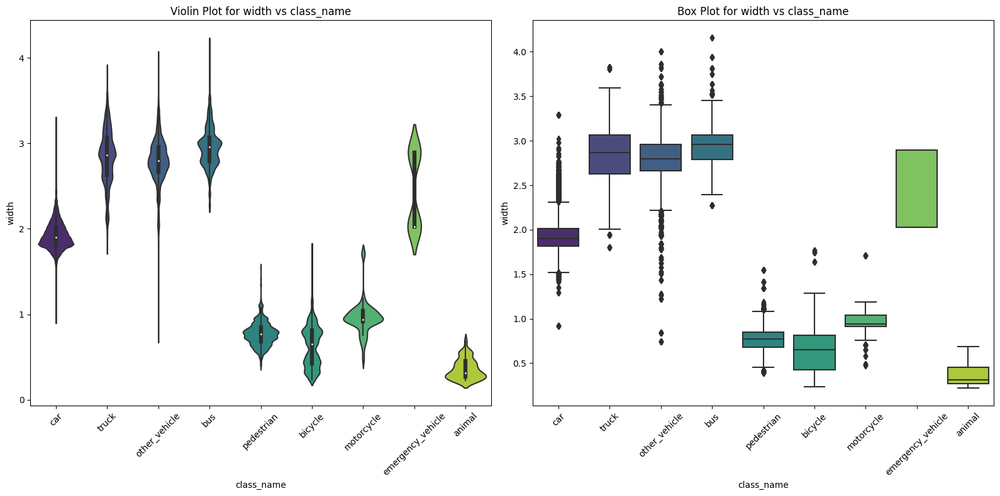

In [47]:
# Visualizing width
feature = 'width'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Width represents the width of detected objects in meters. 

This feature shows very similar trends to the length feature. Larger object classes and vehicles show a much larger median and IQR values than smaller class objects (pedestrians, biclyes, and motorcyles (close to bicycles in makeup)). Larger motor vehicles have many outliers on both the left and right sides of the IQR. Cars have a median width of about 2.0 meters, trucks 2.9 meters, other 2.8 meters, and bus 3.0 meters. This does not come as a suprise as those values line up nice to true world observations. Pedestrians, bicycles, and motorcycles carried much smaller width values having medians of about .7 and .6 respectively. This does not come as a shock either as people and bicycles are thin in comparison to vehicles that need to have the capacity to hold mutiple people inside.  

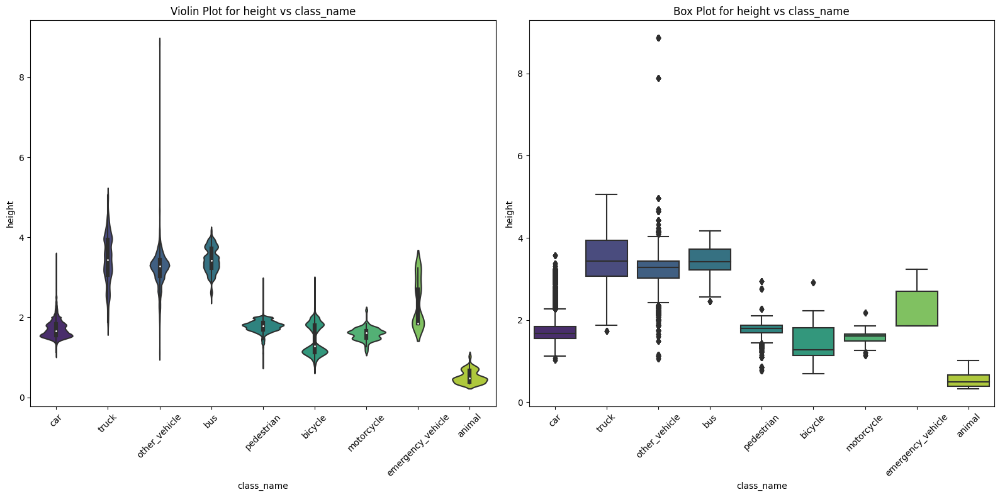

In [48]:
#Visualizing height
feature = 'height'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Height represents the height of detected objects in meters. 

Larger vehicles tend to have a larger height. This includes trucks, other_vehicle, and bus (excludes car). The IQR is widest in truck and bicyle. Only the other_vehicle class contains a lot of outliers from the larger vehicle category. Pedestrian, bicyles, motorcyles, and cars tend to have similar heights just under 2 meters tall. Cars and pedestrians have a lot of outliers, with biclycles having only a few. All categories for height cluster around the median, suggesting less variation between the height metric within classes than there were with other features of center_x, center_y, center_z, width, and length. 

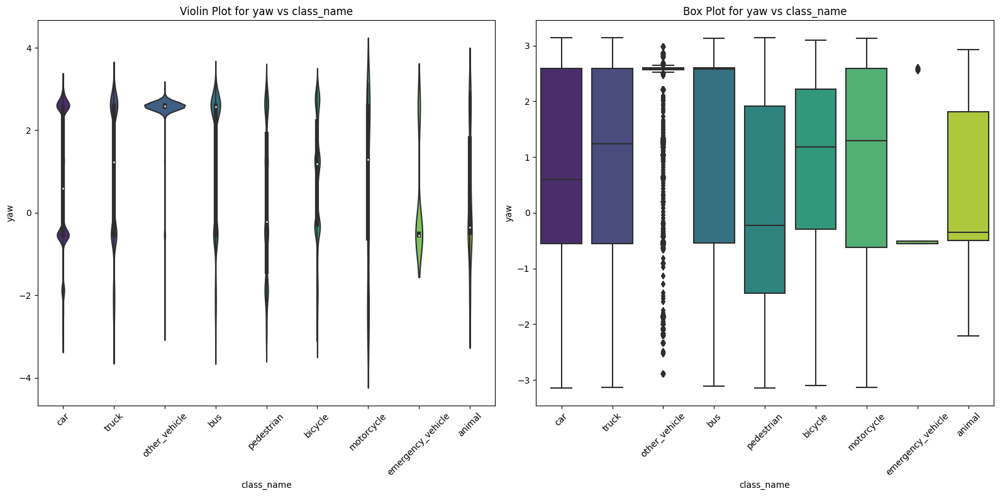

In [49]:
#Visulaizing yaw
feature = 'yaw'
fig, ax = plt.subplots(1, 2, figsize=(16, 8))

sns.violinplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[0])
ax[0].set_title(f'Violin Plot for {feature} vs class_name')
ax[0].tick_params(axis='x', rotation=45)

sns.boxplot(x='class_name', y=feature, data=train_objects, palette='viridis', ax=ax[1])
ax[1].set_title(f'Box Plot for {feature} vs class_name')
ax[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

Yaw represents the rotational orientation of objects around the vertical axis (Z) in 3D space. A yaw of 0 typically means the object is facing forward. Yaw is measured in radians. 

From the boxpots we can see for most categories the distribution is similar. Two exceptions are other_vehicle and emergency_vehicle. Emergency vehicle will be ignored as it represents less than .1% of all the detected objects and this is not a great sample size in relation to the other categories. The other vehicle case is interesting, and it is the most clustered category on the voilin plot. Other than emergency_vehicle it is the only other class to contain outliers. 

The voilin and box plots suggust there are not many unique trends in respect to yaw, as all classes generally follow the same patterns. This is not suprising as roads have orientations that users must follow. For the most part all traffic is traveling towards or away from the ego vehicle; with the rare occation of going across the view (crosswalk/intersection). 

--------------------------------------------------------------------- above code and inspriation from Tarun Paparaju-------------------------------------------------------------------------

Below code is sourced and inspired by Reference Model.ipynb authored by Guido Zuidhof and ternaus (Lyft competition holders)

This chunk creates a dataframe containing metadata about the scenes in lyft_data. The dataframe contains host, scene name, data, scene token, and first sample token (sorted by timestamp). 

In [50]:
#Records contains timestamp of the first sample in a scene and the metadata from that scene
records = [(lyft_data.get('sample', record['first_sample_token'])['timestamp'], record) for record in
        lyft_data.scene]

entries = []

#sorted by start_time and append metadata to 'entries'
for start_time, record in sorted(records):
    start_time = lyft_data.get('sample', record['first_sample_token'])['timestamp'] / 1000000

    token = record['token']
    name = record['name']
    date = datetime.utcfromtimestamp(start_time)
    host = "-".join(record['name'].split("-")[:2])
    first_sample_token = record["first_sample_token"]

    entries.append((host, name, date, token, first_sample_token))
            
df = pd.DataFrame(entries, columns=["host", "scene_name", "date", "scene_token", "first_sample_token"])

df.head()

,host,scene_name,date,scene_token,first_sample_token
0,host-a007,host-a007-lidar0-1230485630199365106-123048565...,2019-01-02 17:33:50.301987,473093b48a7cb78d05e36245fd2dbd12d66ded7dab1ecb...,c7f7de87ec90c8993d4e7d5463208d2aa9f5ecde671960...
1,host-a007,host-a007-lidar0-1230672860198383106-123067288...,2019-01-04 21:34:20.301189,c62b89d6ae60528c00b8a520bfa16799147f5c2dccbe1e...,07889e50d51717e829cbcb4800e6cb2ce08bdabe92440c...
2,host-a007,host-a007-lidar0-1230936221299185986-123093624...,2019-01-07 22:43:41.402021,694dc7b4629151745d3e1b228b1d6653b0fc1ded12aa8d...,83ce1da2c4b37ca88a102928f01512acf8f55ac7207d04...
3,host-a007,host-a007-lidar0-1231093036199514746-123109306...,2019-01-09 18:17:16.302257,8ed3a2f8cf6e01e0d2c0df7db77839f468ed2aa48b6511...,dddda3940f002b0fa6c495a5ad6d5c4a4c8253aa5ed189...
4,host-a009,host-a009-lidar0-1231200854198312986-123120087...,2019-01-11 00:14:14.301261,a05a48966fbc46666be116a79222374c6c79e6fa930c2f...,8990abea0a146b047a04bc6ed303b16cb1c62cca49bf58...


In [51]:
#Counting how many scenes are associated with each host
#This data will be used to construct a validation scene set
host_count_df = df.groupby("host")['scene_token'].count()
print(host_count_df)

host
host-a004    42
host-a005     1
host-a006     3
host-a007    26
host-a008     5
host-a009     9
host-a011    51
host-a012     2
host-a015     6
host-a017     3
host-a101    20
host-a102    12
Name: scene_token, dtype: int64


Validation Split

In [52]:
#splitting df into training and validation sets. host-a007, host-a008, and host-a009 were selected
#due to them adding to be 40/180 scenes (about 22% of the data) - traditional val split is 80-20.


validation_hosts = ["host-a007", "host-a008", "host-a009"]

validation_df = df[df["host"].isin(validation_hosts)]
vi = validation_df.index
#invert filter - select rows NOT in validation indicies
train_df = df[~df.index.isin(vi)]


In [53]:
len(train_df)

140

In [54]:
len(validation_df)

40

In [55]:
#Print unique class names to make a list
# List unique classes
classes = train_objects['class_name'].unique()
print("Unique Classes:")
print(classes)



Unique Classes:
['car' 'truck' 'other_vehicle' 'bus' 'pedestrian' 'bicycle' 'motorcycle'
 'emergency_vehicle' 'animal']


In [56]:
classes = ["car", "motorcycle", "bus", "bicycle", "truck", "pedestrian", "other_vehicle", "animal", "emergency_vehicle"]

"CREATING INPUT AND TARGETS"

This chunk of code extracts LiDAR data and applies transformations. The transformations map the sensor coordingates onto the global coordinate system.

In [57]:
#Maps raw LiDAR data to a global coordinate system.
#Two transformations: 1. sensor coordinates to ego vehicle coordinates, 2. vehicle coordinates to global coordinates

#Retrieves metadata from the sample token
sample_token = train_df.first_sample_token.values[0]
sample = lyft_data.get("sample", sample_token)

#Retrieves LiDAR data token and path to LiDAR binary file
sample_lidar_token = sample["data"]["LIDAR_TOP"]
lidar_data = lyft_data.get("sample_data", sample_lidar_token)
lidar_filepath = lyft_data.get_sample_data_path(sample_lidar_token)

#Retrieves postition of the vehicle and the sensor's calibration
ego_pose = lyft_data.get("ego_pose", lidar_data["ego_pose_token"])
calibrated_sensor = lyft_data.get("calibrated_sensor", lidar_data["calibrated_sensor_token"])

# Homogeneous transformation matrix from car frame to world frame.
global_from_car = transform_matrix(ego_pose['translation'],
                                   Quaternion(ego_pose['rotation']), inverse=False)

# Homogeneous transformation matrix from sensor coordinate frame to ego car frame.
car_from_sensor = transform_matrix(calibrated_sensor['translation'], Quaternion(calibrated_sensor['rotation']),
                                    inverse=False)

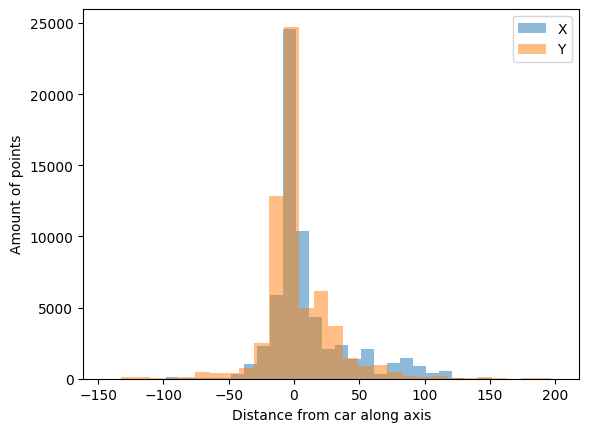

In [58]:
#Loading LiDAR pointcloud, transforms to car's reference frame, and visualizes X and Y coordinates' distributions

#Loads LiDAR data and creates a LiDAR pointcloud object
lidar_pointcloud = LidarPointCloud.from_file(lidar_filepath)

# The lidar pointcloud is defined in the sensor's reference frame.
# We want it in the car's reference frame, so we transform each point
lidar_pointcloud.transform(car_from_sensor)

# A sanity check, the points should be centered around 0 in car space.
plt.hist(lidar_pointcloud.points[0], alpha=0.5, bins=30, label="X")
plt.hist(lidar_pointcloud.points[1], alpha=0.5, bins=30, label="Y")
plt.legend()
plt.xlabel("Distance from car along axis")
plt.ylabel("Amount of points")
plt.show()

As we can see the distribution of points along the X/Y axis is clustering around 0 for both X and Y. This is good; it implies that the car is being treated as the origin.

In [59]:
map_mask = lyft_data.map[0]["mask"]

"A semantic map is a representation of the environment where each element or region in the map is labeled with its semantic meaning. Unlike traditional maps that only capture geometry (such as boundaries or shapes), semantic maps include information about what each object or area represents, such as roads, buildings, lanes, pedestrians, vehicles, etc." - chatGPT

Each pixel in a semantic map is labeled to a specific class. For autonomous vehicles, these maps help determine objects (such as pedestrians), traffic lanes, signals, sidewalks, etc. 

The function below generates a semantic map centered around the vehicle's ego position (vehicle's global coordinate system). 

/tmp/ipykernel_149/2338160806.py:8: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x_min = int(x_px - axes_limit_px)
/tmp/ipykernel_149/2338160806.py:9: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x_max = int(x_px + axes_limit_px)
/tmp/ipykernel_149/2338160806.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_min = int(y_px - axes_limit_px)
/tmp/ipykernel_149/2338160806.py:11: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated,

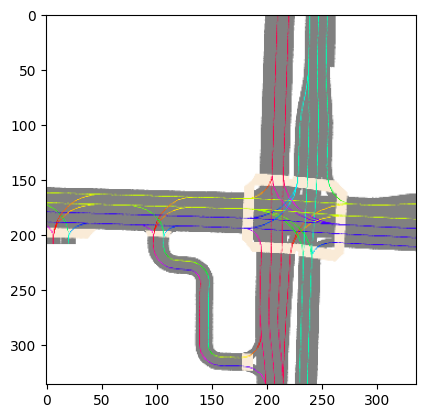

In [60]:
def get_semantic_map_around_ego(map_mask, ego_pose, voxel_size, output_shape):

    #Crops image around (x_px, y_px) with a defined pixel limit: extracts region of the map centered around ego vehicle.
    def crop_image(image: np.array,
                           x_px: int,
                           y_px: int,
                           axes_limit_px: int) -> np.array:
                x_min = int(x_px - axes_limit_px)
                x_max = int(x_px + axes_limit_px)
                y_min = int(y_px - axes_limit_px)
                y_max = int(y_px + axes_limit_px)

                cropped_image = image[y_min:y_max, x_min:x_max]

                return cropped_image
    #Converts ego coordintes (global) into pixel coordintes on the map
    pixel_coords = map_mask.to_pixel_coords(ego_pose['translation'][0], ego_pose['translation'][1])

    #Calculates extent of the cropped area and scales the pixel limits
    extent = voxel_size*output_shape[0]*0.5
    scaled_limit_px = int(extent * (1.0 / (map_mask.resolution)))
    mask_raster = map_mask.mask()

    #crops the semantic map around ego vehicle's pixel coordinates
    cropped = crop_image(mask_raster, pixel_coords[0], pixel_coords[1], int(scaled_limit_px * np.sqrt(2)))

    #Rotates cropped mapped according to yaw of ego vehicle
    ypr_rad = Quaternion(ego_pose['rotation']).yaw_pitch_roll
    yaw_deg = -np.degrees(ypr_rad[0])

    rotated_cropped = np.array(Image.fromarray(cropped).rotate(yaw_deg))
    ego_centric_map = crop_image(rotated_cropped, rotated_cropped.shape[1] / 2, rotated_cropped.shape[0] / 2,
                                 scaled_limit_px)[::-1]

    #Crops the rotated map to center the ego vehicle and resizes to desired output
    ego_centric_map = cv2.resize(ego_centric_map, output_shape[:2], cv2.INTER_NEAREST)
    return ego_centric_map.astype(np.float32)/255 #normalize pixels
    
ego_centric_map = get_semantic_map_around_ego(map_mask, ego_pose, voxel_size=0.4, output_shape=(336,336)) 
plt.imshow(ego_centric_map)
plt.show()

The first function creates a transformation matrix that transforms world coordinates to voxel grid space. Voxel (volumetric pixel) is a unit of a 3D grid (synonomous to a pixel in a 2D image).

The second funtion applies the transformation matrix to a set of 3D points, mapping them into voxel grid space. 

Voxels carry many benefits including reduced storage space compared to 3D images and easier to perform spatial operations.

In [61]:
#shape = dimenstions of voxel grid
#voxel_size = size of each voxel;  (.5,.5,.5) means each voxel is .5 meters across
#offset = shift in world coordinates

def create_transformation_matrix_to_voxel_space(shape, voxel_size, offset):
    """
    Constructs a transformation matrix given an output voxel shape such that (0,0,0) ends up in the center.
    Voxel_size defines how large every voxel is in world coordinate, (1,1,1) would be the same as Minecraft voxels.
    
    An offset per axis in world coordinates (metric) can be provided, this is useful for Z (up-down) in lidar points.
    """
    
    shape, voxel_size, offset = np.array(shape), np.array(voxel_size), np.array(offset)
    
    tm = np.eye(4, dtype=np.float32)
    translation = shape/2 + offset/voxel_size
    
    tm = tm * np.array(np.hstack((1/voxel_size, [1])))

    tm[:3, 3] = np.transpose(translation)
    return tm

def transform_points(points, transf_matrix):
    """
    Transform (3,N) or (4,N) points using transformation matrix.
    """
    if points.shape[0] not in [3,4]:
        raise Exception("Points input should be (3,N) or (4,N) shape, received {}".format(points.shape))
    return transf_matrix.dot(np.vstack((points[:3, :], np.ones(points.shape[1]))))[:3, :]

# Let's try it with some example values
tm = create_transformation_matrix_to_voxel_space(shape=(100,100,4), voxel_size=(0.5,0.5,0.5), offset=(0,0,0.5))
p = transform_points(np.array([[10, 10, 0, 0, 0], [10, 5, 0, 0, 0],[0, 0, 0, 2, 0]], dtype=np.float32), tm)
print(p)

[[70. 70. 50. 50. 50.]
 [70. 60. 50. 50. 50.]
 [ 3.  3.  3.  7.  3.]]


In [62]:
def car_to_voxel_coords(points, shape, voxel_size, z_offset=0):
    if len(shape) != 3:
        raise Exception("Voxel volume shape should be 3 dimensions (x,y,z)")
        
    if len(points.shape) != 2 or points.shape[0] not in [3, 4]:
        raise Exception("Input points should be (3,N) or (4,N) in shape, found {}".format(points.shape))

    tm = create_transformation_matrix_to_voxel_space(shape, voxel_size, (0, 0, z_offset))
    p = transform_points(points, tm)
    return p

def create_voxel_pointcloud(points, shape, voxel_size=(0.5,0.5,1), z_offset=0):

    points_voxel_coords = car_to_voxel_coords(points.copy(), shape, voxel_size, z_offset)
    points_voxel_coords = points_voxel_coords[:3].transpose(1,0)
    points_voxel_coords = np.int0(points_voxel_coords)
    
    bev = np.zeros(shape, dtype=np.float32)
    bev_shape = np.array(shape)

    within_bounds = (np.all(points_voxel_coords >= 0, axis=1) * np.all(points_voxel_coords < bev_shape, axis=1))
    
    points_voxel_coords = points_voxel_coords[within_bounds]
    coord, count = np.unique(points_voxel_coords, axis=0, return_counts=True)
        
    # Note X and Y are flipped:
    bev[coord[:,1], coord[:,0], coord[:,2]] = count
    
    return bev
    
def normalize_voxel_intensities(bev, max_intensity=16):
    return (bev/max_intensity).clip(0,1)


voxel_size = (0.4,0.4,1.5)
z_offset = -2.0
#output size
bev_shape = (336, 336, 3)

bev = create_voxel_pointcloud(lidar_pointcloud.points, bev_shape, voxel_size=voxel_size, z_offset=z_offset)

# So that the values in the voxels range from 0,1 we set a maximum intensity.
bev = normalize_voxel_intensities(bev)

/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)


The below code plots the voxel grid image we created above. Here the images are called "bev" images which stands for "Bird's Eye View". 

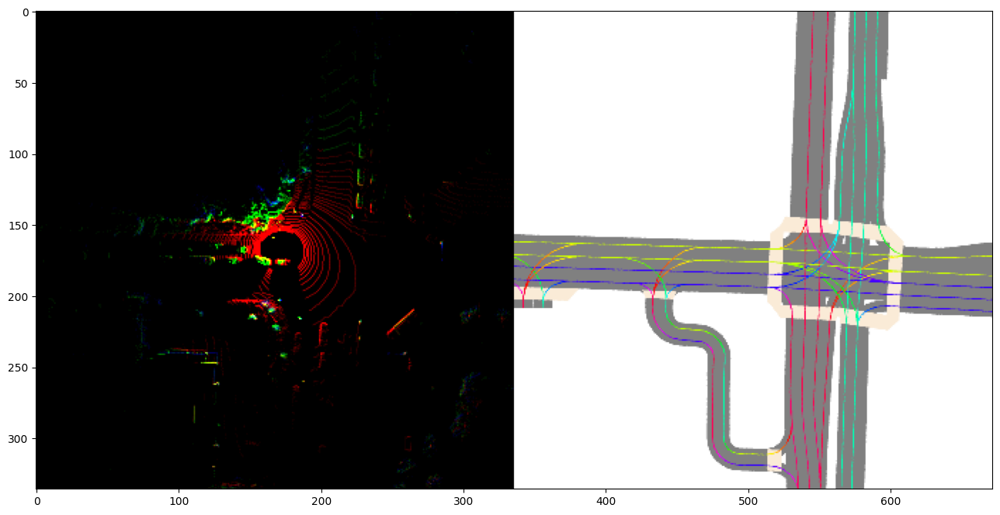

In [63]:
plt.figure(figsize=(16,8))
plt.imshow(np.hstack((bev, ego_centric_map)))
plt.show()

The image created is a Bird's Eye View voxel grid. It is a 2D image that represents a 3D space/environment. This image will be the input for our neural network. 

X-axis is width, Y-axis is depth, and Z-axis (3 layers) is height. The height information is stored in three channels (similar to RGB channels) where R = low height, G = mid height, and B = high height. 

Overall, color channel represents height and pixel brightness represents how many LiDAR points are in that location (density). 

The code below processes bounding boxes. First, bounding boxes are moved into the car's coordinate system. They are then scaled and drawn on a BEV (Bird's Eye View) grid.

The resulting image contains filled rectangles (bounding boxes) representing objects around the car drawn with a colormap to distinguish between different object classes.

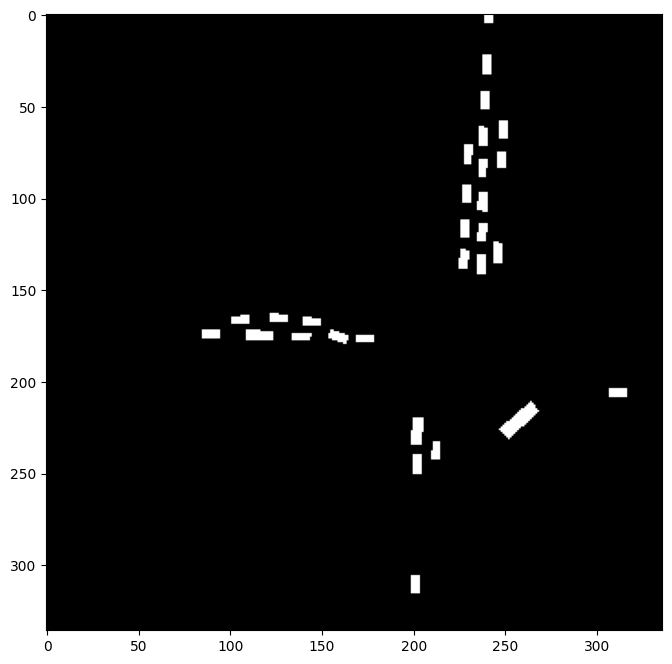

In [64]:
boxes = lyft_data.get_boxes(sample_lidar_token)

target_im = np.zeros(bev.shape[:3], dtype=np.uint8)


#Transforms 3D bounding boxes from global to car's local coordinates
def move_boxes_to_car_space(boxes, ego_pose):
    """
    Move boxes from world space to car space.
    Note: mutates input boxes.
    """

    #subtracts car's position -- shifts bounding boxes relative to car's origin
    translation = -np.array(ego_pose['translation'])
    #Inverse of the car's orientation to align boxes and car frame
    rotation = Quaternion(ego_pose['rotation']).inverse
    
    for box in boxes:
        # Bring box to car space
        box.translate(translation)
        box.rotate(rotation)

#scales bounding boxes to fit resolution
def scale_boxes(boxes, factor):
    """
    Note: mutates input boxes
    """
    for box in boxes:
        box.wlh = box.wlh * factor

#Draws bottom corners of 3D bounding box onto BEV grid/image
def draw_boxes(im, voxel_size, boxes, classes, z_offset=0.0):
    for box in boxes:
        # We only care about the bottom corners
        corners = box.bottom_corners()
        #Converts corner coordinates from car to voxel space
        corners_voxel = car_to_voxel_coords(corners, im.shape, voxel_size, z_offset).transpose(1,0)
        corners_voxel = corners_voxel[:,:2] # Drop z coord

        class_color = classes.index(box.name) + 1
        
        if class_color == 0:
            raise Exception("Unknown class: {}".format(box.name))
            
        #Filling box area in BEV image. Intensity/color corresponds to its class
        cv2.drawContours(im, np.intp([corners_voxel]), 0, (class_color, class_color, class_color), -1)



#Produces an image with bounding boxes represented as filled white rectangles.
#The image is a 2D representation of the 3D space around the car.
move_boxes_to_car_space(boxes, ego_pose)
scale_boxes(boxes, 0.8)
draw_boxes(target_im, voxel_size, boxes, classes, z_offset=z_offset)

plt.figure(figsize=(8,8))
plt.imshow((target_im > 0).astype(np.float32), cmap='Set2')
plt.show()

The below code plots LiDAR pointcloud data in 3D space and shows points in relation to the ego vehicle (at the center). The image is color based on intensity or height.

Each point represents a LiDAR return point in 3D. Areas with clusters of points represent solid objects (cars, buildings, ground, etc.). Areas with more scattered points are smaller objects, noise, or very far objects.

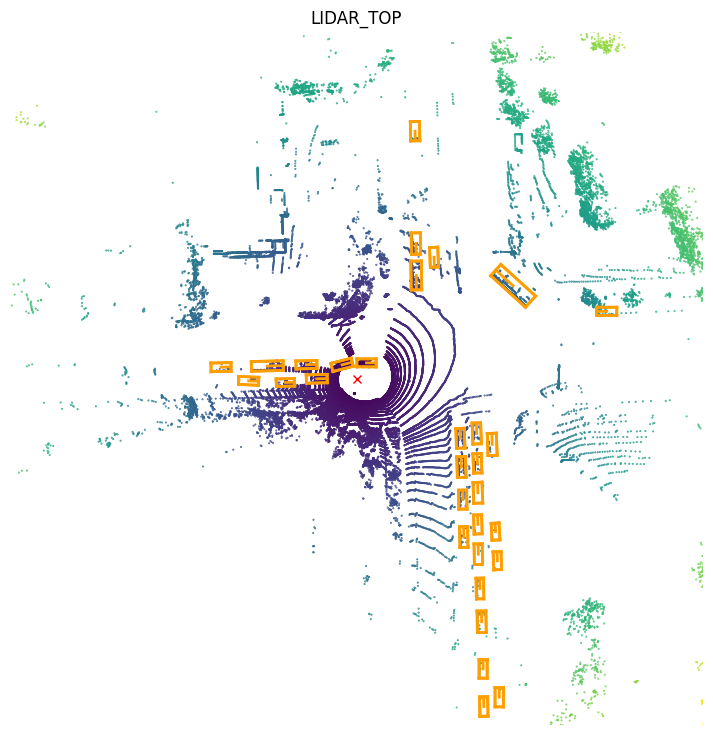

In [65]:

def visualize_lidar_of_sample(sample_token, axes_limit=80):
    sample = lyft_data.get("sample", sample_token)
    sample_lidar_token = sample["data"]["LIDAR_TOP"]
    lyft_data.render_sample_data(sample_lidar_token, axes_limit=axes_limit)
visualize_lidar_of_sample(sample_token)

In this next section, we follow the same process as above on all the samples in train and validation sets. 

In [66]:

# Some hyperparameters we'll need to define for the system

#Defines size of each voxel or 3D pixel in meters x,y,z axes
voxel_size = (0.4, 0.4, 1.5)
#offset applied to height axis. It adjusts the ground level in the voxel space
z_offset = -2.0
#Defines shape of BEV grid: 336x336 grid cells with 3 channcel representing height slices
bev_shape = (336, 336, 3)

# We scale down each box so they are more separated when projected into our coarse voxel space.
box_scale = 0.8

In [67]:
#Defining paths to BEV data directories
train_data_folder = os.path.join(ARTIFACTS_FOLDER, "bev_train_data")
validation_data_folder = os.path.join(ARTIFACTS_FOLDER, "./bev_validation_data")

This code prepairs the training data for a scene, transforming LiDAR data into BEV and creating images, target maps, and semantic maps as outputs.

1. input.png - this output is the BEV (Bird's Eye View) of the LiDAR pointcloud data transformed on a voxel grid. This is the same output as chunk 52. This output is the input to the neural network.
2. target.png - Segmentation mask that highlights bounding boxes for objects detected in LiDAR. This output serves as the ground truth for training.
Boxes for target.png are transformed to car's local coordinates and fitted to the voxel grid.
3. map.png - semantic map providing more model supervision. Enables the model to learn both detection and context of the environment (where things are located).

These are the same 3 image outputs as above.

In [68]:
#setting the number of workers for parallel processing
#Will set the number of workers to the number of CPUs available on the machine/environment
NUM_WORKERS = os.cpu_count()


#Generates three images for each sample: input.png, target.png, and map.png
#Input.png - BEV of LiDAR pointcloud data transformed to voxel grid
#target.png - Segmentation mask image. Highlighting locations of 3D bounding boxes
#map.png - Semantic map of the environment 
def prepare_training_data_for_scene(first_sample_token, output_folder, bev_shape, voxel_size, z_offset, box_scale):
    """
    Given a first sample token (in a scene), output rasterized input volumes and targets in birds-eye-view perspective.
    

    """
    sample_token = first_sample_token
    
    while sample_token:
        
        sample = lyft_data.get("sample", sample_token)

        sample_lidar_token = sample["data"]["LIDAR_TOP"]
        lidar_data = lyft_data.get("sample_data", sample_lidar_token)
        lidar_filepath = lyft_data.get_sample_data_path(sample_lidar_token)

        ego_pose = lyft_data.get("ego_pose", lidar_data["ego_pose_token"])
        calibrated_sensor = lyft_data.get("calibrated_sensor", lidar_data["calibrated_sensor_token"])


        global_from_car = transform_matrix(ego_pose['translation'],
                                           Quaternion(ego_pose['rotation']), inverse=False)

        car_from_sensor = transform_matrix(calibrated_sensor['translation'], Quaternion(calibrated_sensor['rotation']),
                                            inverse=False)

        try:
            lidar_pointcloud = LidarPointCloud.from_file(lidar_filepath)
            lidar_pointcloud.transform(car_from_sensor)
        except Exception as e:
            print ("Failed to load Lidar Pointcloud for {}: {}:".format(sample_token, e))
            sample_token = sample["next"]
            continue
        
        bev = create_voxel_pointcloud(lidar_pointcloud.points, bev_shape, voxel_size=voxel_size, z_offset=z_offset)
        bev = normalize_voxel_intensities(bev)

        
        boxes = lyft_data.get_boxes(sample_lidar_token)

        target = np.zeros_like(bev)

        move_boxes_to_car_space(boxes, ego_pose)
        scale_boxes(boxes, box_scale)
        draw_boxes(target, voxel_size, boxes=boxes, classes=classes, z_offset=z_offset)

        bev_im = np.round(bev*255).astype(np.uint8)
        target_im = target[:,:,0] # take one channel only
        
        semantic_im = get_semantic_map_around_ego(map_mask, ego_pose, voxel_size[0], target_im.shape)
        semantic_im = np.round(semantic_im*255).astype(np.uint8)

        cv2.imwrite(os.path.join(output_folder, "{}_input.png".format(sample_token)), bev_im)
        cv2.imwrite(os.path.join(output_folder, "{}_target.png".format(sample_token)), target_im)
        cv2.imwrite(os.path.join(output_folder, "{}_map.png".format(sample_token)), semantic_im)
        
        sample_token = sample["next"]

for df, data_folder in [(train_df, train_data_folder), (validation_df, validation_data_folder)]:
    print("Preparing data into {} using {} workers".format(data_folder, NUM_WORKERS))
    
    first_samples = df.first_sample_token.values
    os.makedirs(data_folder, exist_ok=True)
    
    process_func = partial(prepare_training_data_for_scene,
                           output_folder=data_folder, bev_shape=bev_shape, voxel_size=voxel_size, z_offset=z_offset, box_scale=box_scale)

    with Pool(NUM_WORKERS) as pool:
        # Wrap imap_unordered with tqdm to show the progress bar
        for _ in tqdm(pool.imap_unordered(process_func, first_samples), total=len(first_samples)):
            pass

Preparing data into /kaggle/working/artifacts/bev_train_data using 4 workers


  0%|          | 0/140 [00:00<?, ?it/s]

/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/2338160806.py:8: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x_min = int(x

Failed to load Lidar Pointcloud for 9cb04b1a4d476fd0782431764c7b55e91c6dbcbc6197c3dab3e044f13d058011: cannot reshape array of size 265728 into shape (5):
Preparing data into /kaggle/working/artifacts/./bev_validation_data using 4 workers


  0%|          | 0/40 [00:00<?, ?it/s]

/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/1581971168.py:16: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  points_voxel_coords = np.int0(points_voxel_coords)
/tmp/ipykernel_149/2338160806.py:8: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  x_min = int(x

TRAINING THE MODEL

The code chunk below implements a BEVImageDataset class that loads BEV images, semantic maps, and target masks. It converts them to PyTorch tensors for model training. Other functions it executes is normalizing image pixels, converts masks to int64 data type. 

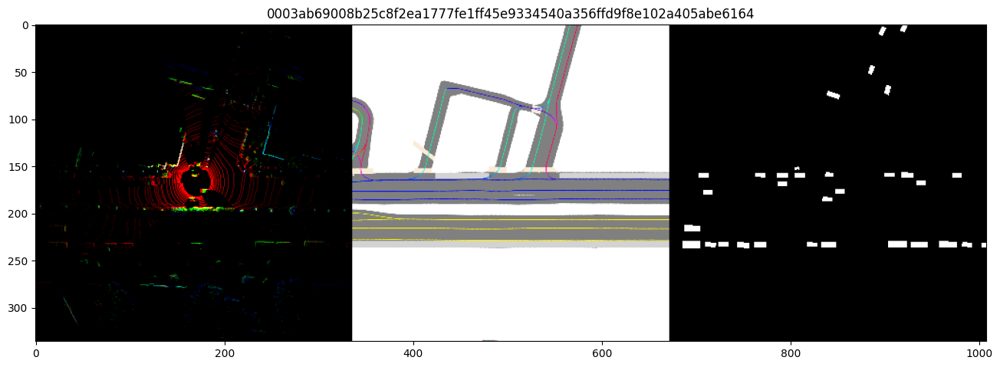

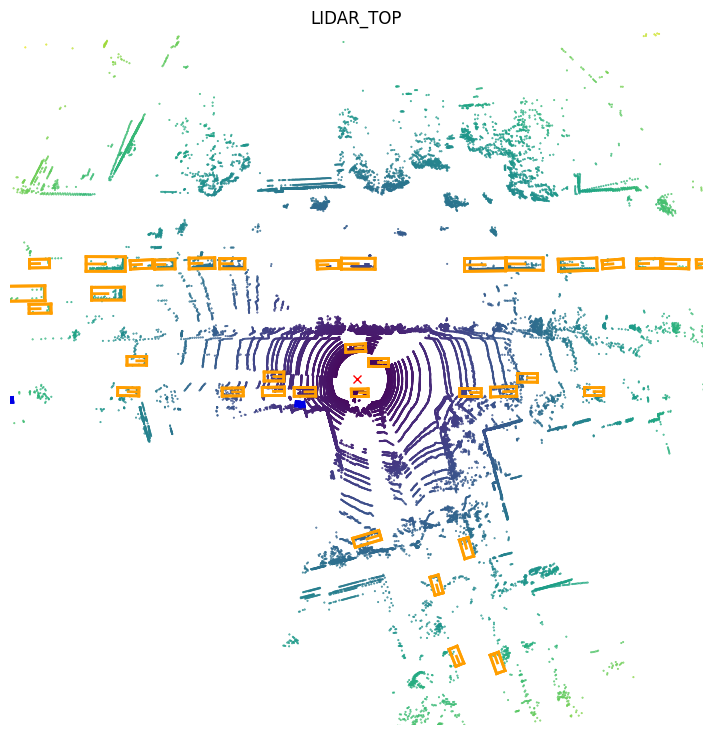

In [69]:

#Dataset class that loads the images from the BEV input paths
#Processes images and returns them as tensors with sample token
class BEVImageDataset(torch.utils.data.Dataset):
    def __init__(self, input_filepaths, target_filepaths, map_filepaths=None):
        self.input_filepaths = input_filepaths
        self.target_filepaths = target_filepaths
        self.map_filepaths = map_filepaths
        
        if map_filepaths is not None:
            assert len(input_filepaths) == len(map_filepaths)
        
        assert len(input_filepaths) == len(target_filepaths)

    def __len__(self):
        return len(self.input_filepaths)
    #reads input, target, map images
    #If map image is present, it is concatenated to the input image on thrid dimension
    def __getitem__(self, idx):
        input_filepath = self.input_filepaths[idx]
        target_filepath = self.target_filepaths[idx]
        
        sample_token = input_filepath.split("/")[-1].replace("_input.png","")
        
        im = cv2.imread(input_filepath, cv2.IMREAD_UNCHANGED)
        
        if self.map_filepaths:
            map_filepath = self.map_filepaths[idx]
            map_im = cv2.imread(map_filepath, cv2.IMREAD_UNCHANGED)
            im = np.concatenate((im, map_im), axis=2)
        
        target = cv2.imread(target_filepath, cv2.IMREAD_UNCHANGED)
        
        im = im.astype(np.float32)/255
        target = target.astype(np.int64)
        
        im = torch.from_numpy(im.transpose(2,0,1))
        target = torch.from_numpy(target)
        
        return im, target, sample_token

input_filepaths = sorted(glob.glob(os.path.join(train_data_folder, "*_input.png")))
target_filepaths = sorted(glob.glob(os.path.join(train_data_folder, "*_target.png")))
map_filepaths = sorted(glob.glob(os.path.join(train_data_folder, "*_map.png")))

train_dataset = BEVImageDataset(input_filepaths, target_filepaths, map_filepaths)
    
im, target, sample_token = train_dataset[1]
im = im.numpy()
target = target.numpy()

plt.figure(figsize=(16,8))

target_as_rgb = np.repeat(target[...,None], 3, 2)
# Transpose the input volume CXY to XYC order, which is what matplotlib requires.
plt.imshow(np.hstack((im.transpose(1,2,0)[...,:3], im.transpose(1,2,0)[...,3:], target_as_rgb)))
plt.title(sample_token)
plt.show()

visualize_lidar_of_sample(sample_token)


Below a UNET model is defined using PyTorch. Code was taken from the competition's github repository: nuscenes-devkit/notebooks/Reference Model.ipynb 

AND https://github.com/jvanvugt/pytorch-unet, it is MIT licensed.

UNET architectures are segmentation models consisting of an encoder (downsampling) and decoder (upsampling). THe encoder extracts features from input images through convolutional layers and max pooling. The decoder recovers spatial resolution using transposed convolutions with skip connections.


In [70]:
# This implementation was copied from https://github.com/jvanvugt/pytorch-unet, it is MIT licensed.


class UNet(nn.Module):
    def __init__(
        self,
        in_channels=1,
        n_classes=2,
        depth=5,
        wf=6,
        padding=False,
        batch_norm=False,
        up_mode='upconv',
    ):
        """
        Implementation of
        U-Net: Convolutional Networks for Biomedical Image Segmentation
        (Ronneberger et al., 2015)
        https://arxiv.org/abs/1505.04597
        Using the default arguments will yield the exact version used
        in the original paper
        Args:
            in_channels (int): number of input channels
            n_classes (int): number of output channels
            depth (int): depth of the network
            wf (int): number of filters in the first layer is 2**wf
            padding (bool): if True, apply padding such that the input shape
                            is the same as the output.
                            This may introduce artifacts
            batch_norm (bool): Use BatchNorm after layers with an
                               activation function
            up_mode (str): one of 'upconv' or 'upsample'.
                           'upconv' will use transposed convolutions for
                           learned upsampling.
                           'upsample' will use bilinear upsampling.
        """
        super(UNet, self).__init__()
        assert up_mode in ('upconv', 'upsample')
        self.padding = padding
        self.depth = depth
        prev_channels = in_channels
        self.down_path = nn.ModuleList()
        for i in range(depth):
            self.down_path.append(
                UNetConvBlock(prev_channels, 2 ** (wf + i), padding, batch_norm)
            )
            prev_channels = 2 ** (wf + i)

        self.up_path = nn.ModuleList()
        for i in reversed(range(depth - 1)):
            self.up_path.append(
                UNetUpBlock(prev_channels, 2 ** (wf + i), up_mode, padding, batch_norm)
            )
            prev_channels = 2 ** (wf + i)

        self.last = nn.Conv2d(prev_channels, n_classes, kernel_size=1)

    def forward(self, x):
        blocks = []
        for i, down in enumerate(self.down_path):
            x = down(x)
            if i != len(self.down_path) - 1:
                blocks.append(x)
                x = F.max_pool2d(x, 2)

        for i, up in enumerate(self.up_path):
            x = up(x, blocks[-i - 1])

        return self.last(x)

#Defines convolutional block - play with this.
class UNetConvBlock(nn.Module):
    def __init__(self, in_size, out_size, padding, batch_norm):
        super(UNetConvBlock, self).__init__()
        block = []

        block.append(nn.Conv2d(in_size, out_size, kernel_size=3, padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        block.append(nn.Conv2d(out_size, out_size, kernel_size=3, padding=int(padding)))
        block.append(nn.ReLU())
        if batch_norm:
            block.append(nn.BatchNorm2d(out_size))

        self.block = nn.Sequential(*block)

    def forward(self, x):
        out = self.block(x)
        return out

#Defines upsampling block
class UNetUpBlock(nn.Module):
    def __init__(self, in_size, out_size, up_mode, padding, batch_norm):
        super(UNetUpBlock, self).__init__()
        if up_mode == 'upconv':
            self.up = nn.ConvTranspose2d(in_size, out_size, kernel_size=2, stride=2)
        elif up_mode == 'upsample':
            self.up = nn.Sequential(
                nn.Upsample(mode='bilinear', scale_factor=2),
                nn.Conv2d(in_size, out_size, kernel_size=1),
            )

        self.conv_block = UNetConvBlock(in_size, out_size, padding, batch_norm)

    def center_crop(self, layer, target_size):
        _, _, layer_height, layer_width = layer.size()
        diff_y = (layer_height - target_size[0]) // 2
        diff_x = (layer_width - target_size[1]) // 2
        return layer[
            :, :, diff_y : (diff_y + target_size[0]), diff_x : (diff_x + target_size[1])
        ]

    def forward(self, x, bridge):
        up = self.up(x)
        crop1 = self.center_crop(bridge, up.shape[2:])
        out = torch.cat([up, crop1], 1)
        out = self.conv_block(out)

        return out          

In [71]:
#Create an instance of the UNET model
def get_unet_model(in_channels=6, num_output_classes=2): #specify input channels and output channels (2 for binary)
    #wf = width factor for filters in the first layer. At 5 the first layer will have 2^5 (32) filters
    #depth - depth of the network
    model = UNet(in_channels=6, n_classes=num_output_classes, wf=5, depth=4, padding=True, up_mode='upsample')
    
    # Optional, for multi GPU training and inference
    model = nn.DataParallel(model)
    return model


The below function displays input, predicted segmentation maps, target segmentation maps, and overlays the prediction on the imput image. 

It can display multi-channel images and semantic maps.

In [72]:
#inputs are images created in the previous steps.
def visualize_predictions(input_image, prediction, target, n_images=2, apply_softmax=True):
    """
    Takes as input 3 PyTorch tensors, plots the input image, predictions and targets.
    """
    # Only select the first n images
    prediction = prediction[:n_images]
    target = target[:n_images]
    input_image = input_image[:n_images]

    prediction = prediction.detach().cpu().numpy()
    if apply_softmax:
        prediction = scipy.special.softmax(prediction, axis=1)
    class_one_preds = np.hstack(1-prediction[:,0])

    target = np.hstack(target.detach().cpu().numpy())

    class_rgb = np.repeat(class_one_preds[..., None], 3, axis=2)
    class_rgb[...,2] = 0
    class_rgb[...,1] = target

    
    input_im = np.hstack(input_image.cpu().numpy().transpose(0,2,3,1))
    
    if input_im.shape[2] == 3: # Without semantic map input
        input_im_grayscale = np.repeat(input_im.mean(axis=2)[..., None], 3, axis=2)
        overlayed_im = (input_im_grayscale*0.6 + class_rgb*0.7).clip(0,1)
    else:
        input_map = input_im[...,3:] #With semantic map input
        overlayed_im = (input_map*0.6 + class_rgb*0.7).clip(0,1)

    thresholded_pred = np.repeat(class_one_preds[..., None] > 0.5, 3, axis=2)

    fig = plt.figure(figsize=(12,26))
    plot_im = np.vstack([class_rgb, input_im[...,:3], overlayed_im, thresholded_pred]).clip(0,1).astype(np.float32)
    plt.imshow(plot_im)
    plt.axis("off")
    plt.show()

This chunk accounts for class imbalance (many more cars than anything else). A lower weight is assigned to the class 0 which represents the background or majority class. Attempts to kill some of the bias towards the majority class. 

In [73]:
# We weigh the loss for the 0 class lower to account for (some of) the big class imbalance.
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
class_weights = torch.from_numpy(np.array([0.2] + [1.0]*len(classes), dtype=np.float32))
class_weights = class_weights.to(device)

The model is implemented and trained for 20 epochs using a batch size of 10. The adam optimizer is used with a learning rate of le-3. 

Shuffle is active to help make a more robust model.

In [74]:
from tqdm.notebook import tqdm
from IPython.display import display, clear_output

In [ ]:
#batch_size = 8
#epochs = 20

#model = get_unet_model(num_output_classes=len(classes)+1)
#model = model.to(device)

#optim = torch.optim.Adam(model.parameters(), lr=1e-3)
#dataloader = torch.utils.data.DataLoader(train_dataset, batch_size, shuffle=True, num_workers=os.cpu_count())

#all_losses = []

#for epoch in range(1, epochs+1):
#    print("Epoch", epoch)
    
#    epoch_losses = []
#    progress_bar = tqdm_notebook(dataloader)
    
#    for ii, (X, target, sample_ids) in enumerate(progress_bar):
#        X = X.to(device)  # [N, 3, H, W]
#        target = target.to(device)  # [N, H, W] with class indices (0, 1)
#        prediction = model(X)  # [N, 2, H, W]
#        loss = F.cross_entropy(prediction, target, weight=class_weights)

#        optim.zero_grad()
#        loss.backward()
#        optim.step()
        
#        epoch_losses.append(loss.detach().cpu().numpy())

#        if ii == 0:
#            visualize_predictions(X, prediction, target)
    
#    print("Loss:", np.mean(epoch_losses))
#    all_losses.extend(epoch_losses)
    
#    checkpoint_filename = "unet_checkpoint_epoch_{}.pth".format(epoch)
#    checkpoint_filepath = os.path.join(ARTIFACTS_FOLDER, checkpoint_filename)
#    torch.save(model.state_dict(), checkpoint_filepath)
    
#plt.figure(figsize=(12,12))
#plt.plot(all_losses, alpha=0.75)
#plt.show()

Epoch 1/20


/opt/conda/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:60: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

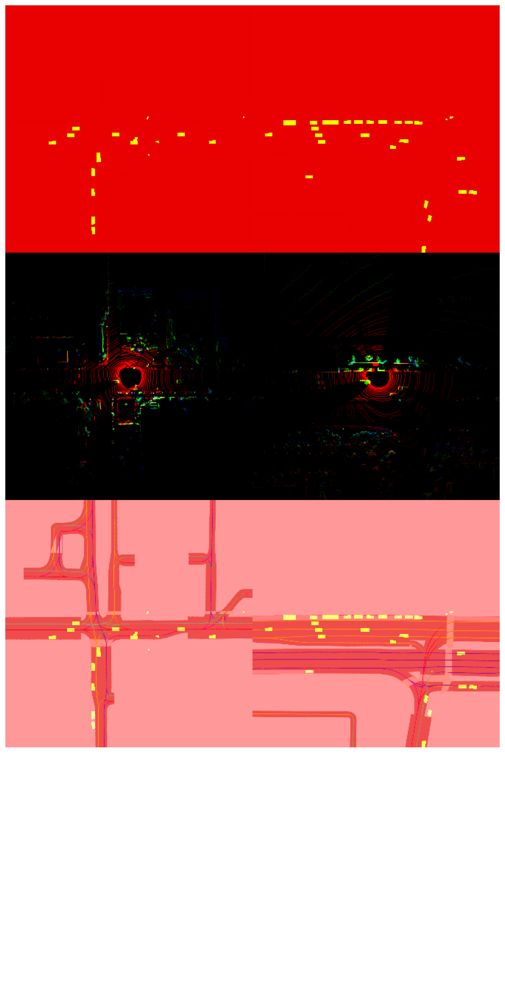

Training Loss: 0.1027


/tmp/ipykernel_149/448135460.py:71: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  progress_bar = tqdm_notebook(val_dataloader, desc="Validation")


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0668
Best model (architecture + weights) saved.
Epoch 2/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

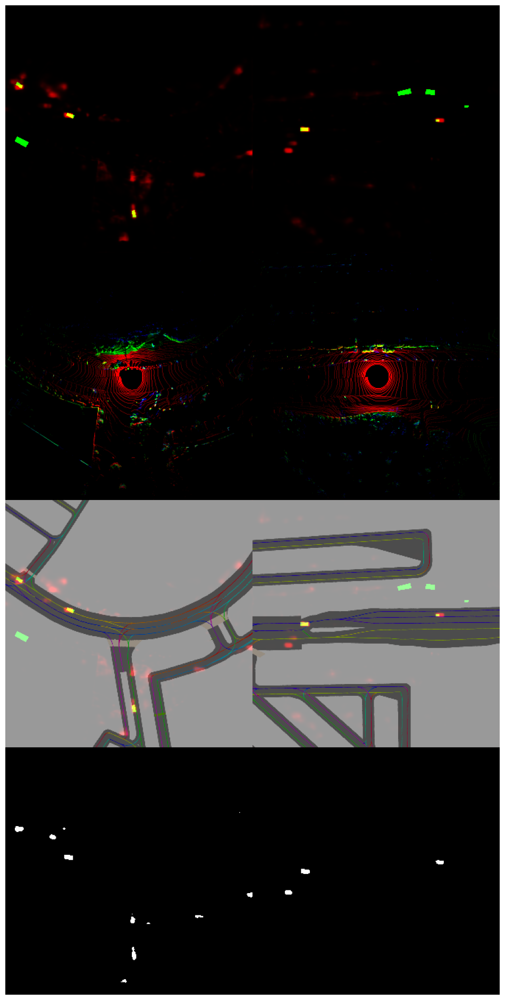

Training Loss: 0.0444


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>
Traceback (most recent call last):
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__
Exception ignored in:   File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__
<function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>
        self._shutdown_workers()
self._shutdown_workers()  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1460, in _shutdown_workers
Traceback (most recent call last):
    
if w.is_alive():  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__

  File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
  File "/opt/conda/lib/python3.10/site-

Validation Loss: 0.0556
Best model (architecture + weights) saved.
Epoch 3/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

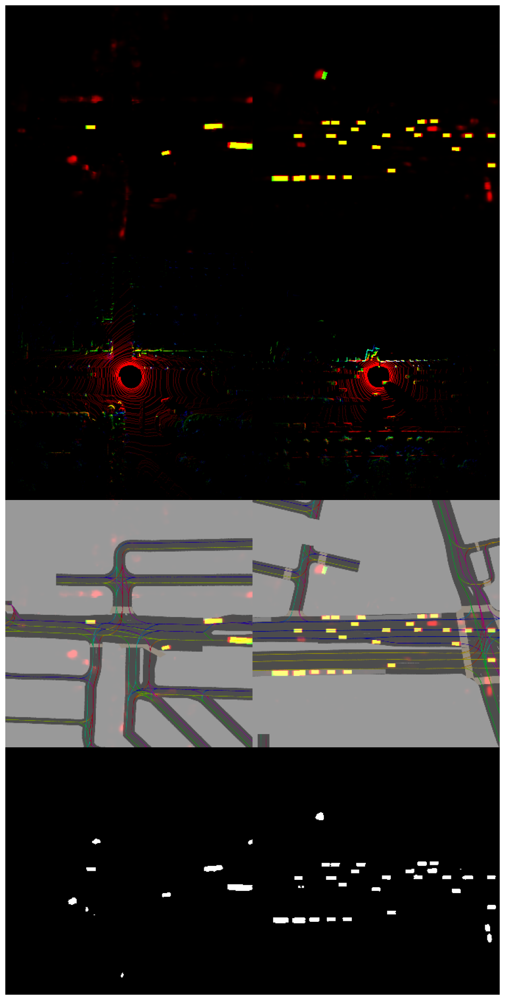

Training Loss: 0.0343


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0566
Epoch 4/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

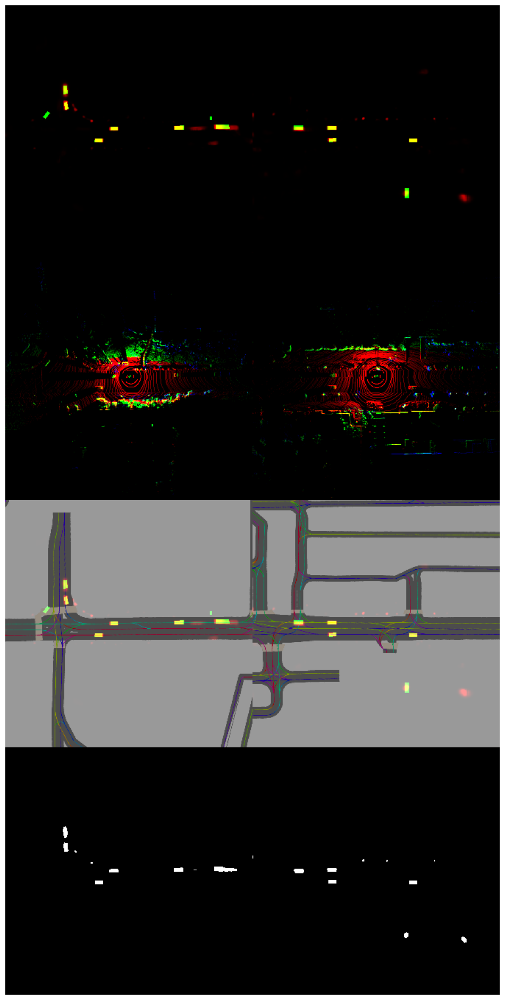

Training Loss: 0.0293


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0578
Epoch 5/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

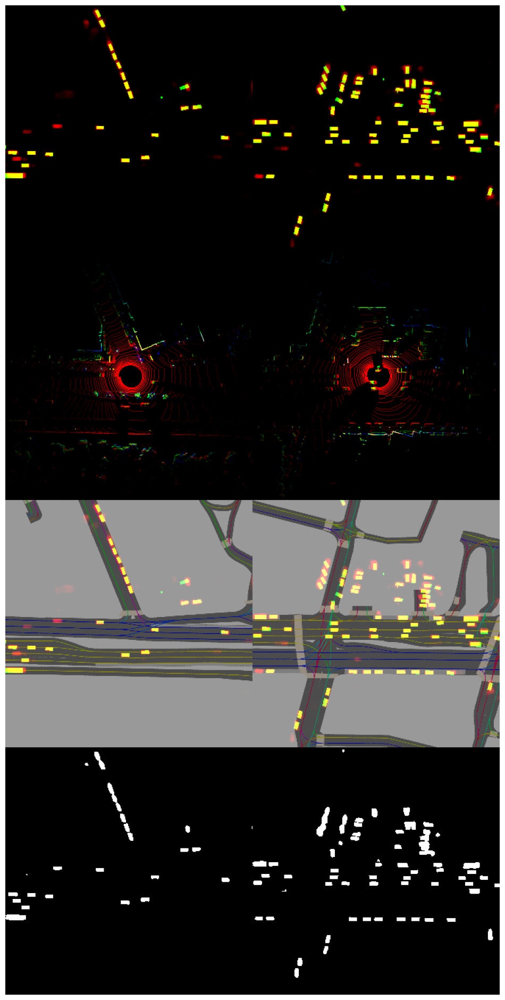

Training Loss: 0.0263


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0624
Epoch 6/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

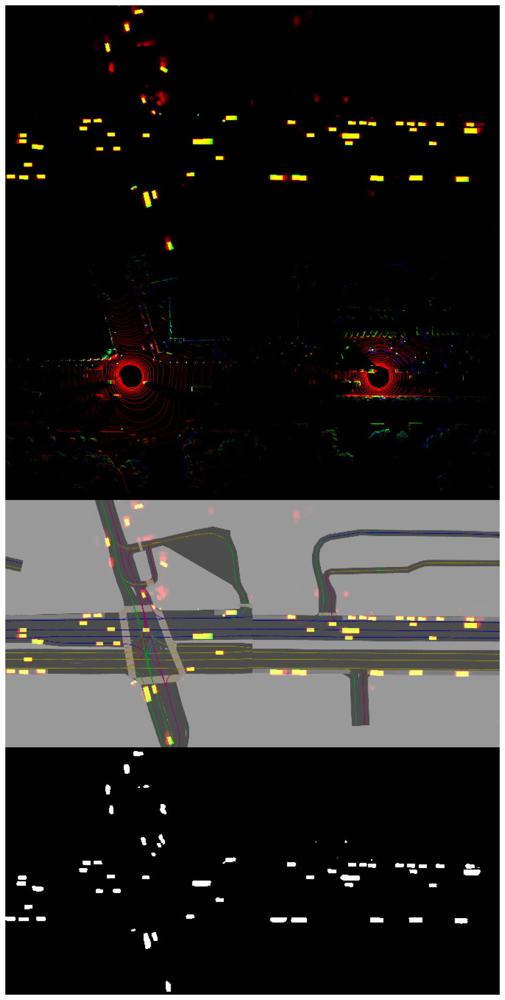

Training Loss: 0.0244


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0546
Best model (architecture + weights) saved.
Epoch 7/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

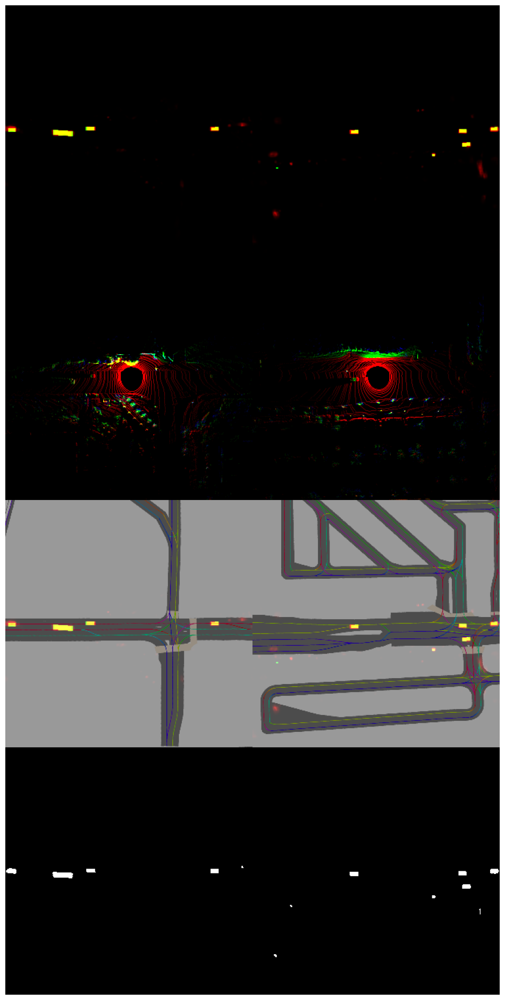

Training Loss: 0.0228


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0565
Epoch 8/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

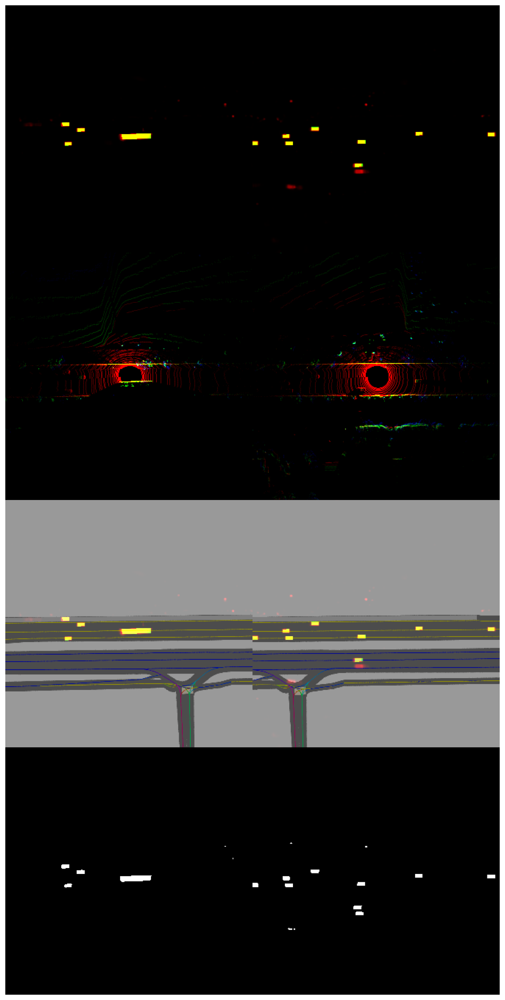

Training Loss: 0.0217


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0590
Epoch 9/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

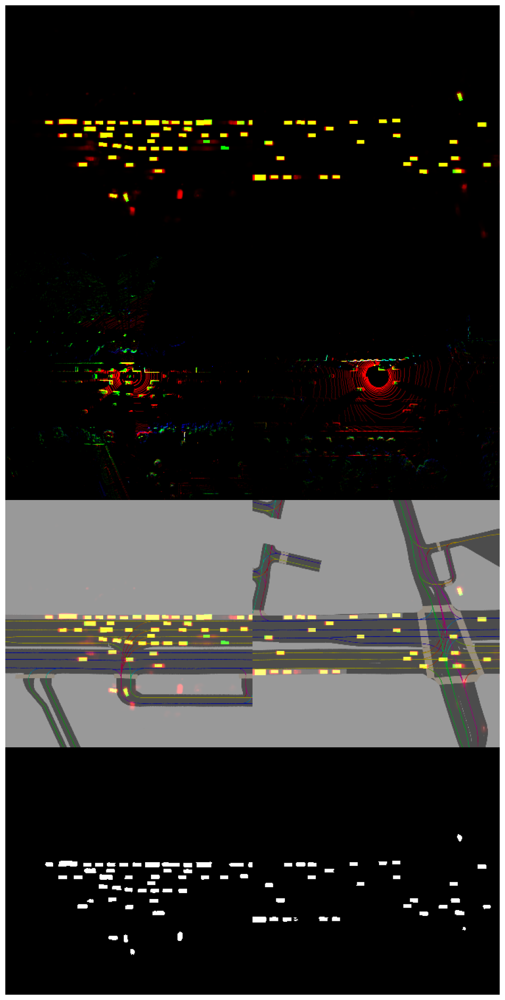

Training Loss: 0.0207


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>
Traceback (most recent call last):
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__
    self._shutdown_workers()Exception ignored in: 
<function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>Exception ignored in:   File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1460, in _shutdown_workers
    
if w.is_alive():<function _MultiProcessingDataLoaderIter.__del__ at 0x7a8eb9b12950>
Traceback (most recent call last):
Traceback (most recent call last):

  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__
  File "/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py", line 1477, in __del__
      File "/opt/conda/lib/python3.10/multiprocessing/process.py", line 160, in is_alive
self._shutdown_workers()    
    self._shutdown_workers()assert 

Validation Loss: 0.0572
Epoch 10/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

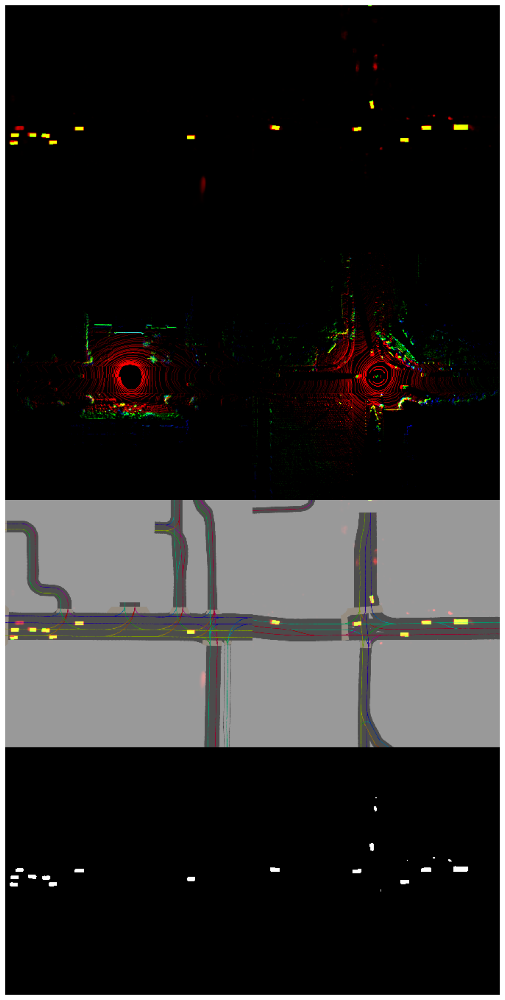

Training Loss: 0.0197


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0592
Epoch 11/20


Training:   0%|          | 0/2205 [00:00<?, ?it/s]

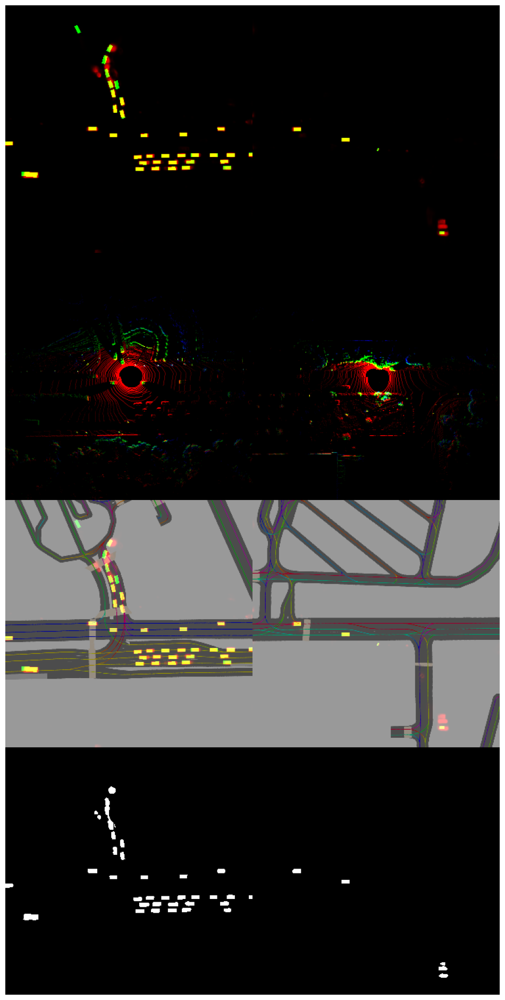

Training Loss: 0.0161


Validation:   0%|          | 0/630 [00:00<?, ?it/s]

Validation Loss: 0.0647
Early stopping triggered after 5 epochs without improvement.


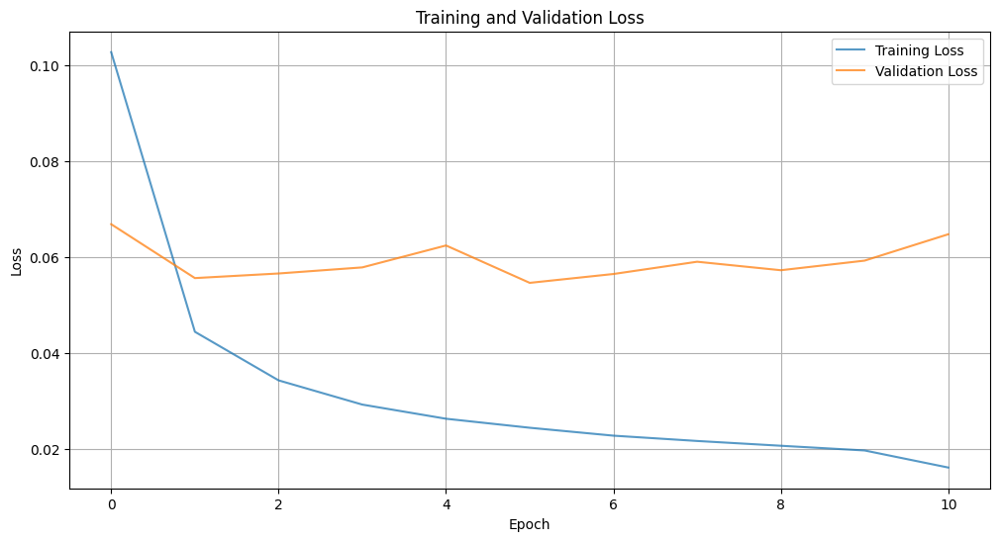

In [75]:
#Adjustments made to the above (commented out) implementation:
#1. validation set testing after each epoch 
#2. Early Stopping - will stop model training if validation loss does not improve over 5 epochs
#3. Saving best model - The best model will be saved in addition to the model after each epoch for later retrieval
from tqdm.auto import tqdm

from torch.optim.lr_scheduler import ReduceLROnPlateau

batch_size = 8
epochs = 20
patience = 5  # Number of epochs to wait for improvement before stopping
best_val_loss = float('inf')
early_stop_counter = 0
#Validation step on the best saved model.

# Define file paths for validation data
val_input_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_input.png")))
val_target_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_target.png")))
val_map_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_map.png")))

# Create the validation dataset
val_dataset = BEVImageDataset(val_input_filepaths, val_target_filepaths, val_map_filepaths)

# Define the validation DataLoader
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size, shuffle=False, num_workers=os.cpu_count())


model = get_unet_model(num_output_classes=len(classes) + 1)
model = model.to(device)

optim = torch.optim.Adam(model.parameters(), lr=1e-3)
scheduler = ReduceLROnPlateau(optim, mode='min', patience=3, factor=0.5, verbose=True)

# Dataloaders for training and validation
train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size, shuffle=True, num_workers=os.cpu_count())
val_dataloader = torch.utils.data.DataLoader(val_dataset, batch_size, shuffle=False, num_workers=os.cpu_count())

all_train_losses = []
all_val_losses = []

for epoch in range(1, epochs + 1):
    print(f"Epoch {epoch}/{epochs}")

    # Training phase
    model.train()
    train_losses = []
    progress_bar = tqdm(train_dataloader, desc="Training")

    for ii, (X, target, sample_ids) in enumerate(progress_bar):
        X = X.to(device)  # [N, C, H, W]
        target = target.to(device)  # [N, H, W] with class indices (0, 1)
        prediction = model(X)  # [N, 2, H, W]
        loss = F.cross_entropy(prediction, target, weight=class_weights)

        optim.zero_grad()
        loss.backward()
        optim.step()

        train_losses.append(loss.item())

        if ii == 0:
            visualize_predictions(X, prediction, target)

    avg_train_loss = np.mean(train_losses)
    all_train_losses.append(avg_train_loss)
    print(f"Training Loss: {avg_train_loss:.4f}")

    # Validation phase
    model.eval()
    val_losses = []
    progress_bar = tqdm_notebook(val_dataloader, desc="Validation")

    with torch.no_grad():
        for X_val, target_val, sample_ids in progress_bar:
            X_val = X_val.to(device)
            target_val = target_val.to(device)

            prediction_val = model(X_val)
            val_loss = F.cross_entropy(prediction_val, target_val, weight=class_weights)
            val_losses.append(val_loss.item())

    avg_val_loss = np.mean(val_losses)
    all_val_losses.append(avg_val_loss)
    print(f"Validation Loss: {avg_val_loss:.4f}")

    # Learning rate scheduling
    scheduler.step(avg_val_loss)

    # Save best model (architecture + weights)
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        best_model_filename = "unet_best_model.pth"
        best_model_filepath = os.path.join(ARTIFACTS_FOLDER, best_model_filename)
    
        torch.save(model, best_model_filepath)  # Save entire model (architecture + weights)
        print("Best model (architecture + weights) saved.")

        early_stop_counter = 0  # Reset counter if validation improves
    else:
        early_stop_counter += 1


    # Save model after each epoch
    #checkpoint_filename = f"unet_checkpoint_epoch_{epoch}.pth"
    #checkpoint_filepath = os.path.join(ARTIFACTS_FOLDER, checkpoint_filename)
    #torch.save(model.state_dict(), checkpoint_filepath)
    #print(f"Model saved after epoch {epoch}.")

    # Early stopping
    if early_stop_counter >= patience:
        print(f"Early stopping triggered after {patience} epochs without improvement.")
        break

# Plot training and validation losses
plt.figure(figsize=(12, 6))
plt.plot(all_train_losses, label="Training Loss", alpha=0.75)
plt.plot(all_val_losses, label="Validation Loss", alpha=0.75)
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training and Validation Loss")
plt.legend()
plt.grid(True)
plt.show()


In [77]:
#Validation step on the best saved model.

input_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_input.png")))
target_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_target.png")))
map_filepaths = sorted(glob.glob(os.path.join(validation_data_folder, "*_map.png")))

batch_size=16
validation_dataset = BEVImageDataset(input_filepaths, target_filepaths, map_filepaths)
validation_dataloader = torch.utils.data.DataLoader(validation_dataset, batch_size, shuffle=False, num_workers=os.cpu_count())


device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = get_unet_model(num_output_classes=1+len(classes))
model = model.to(device)

# Load the best saved model - adjustment from original code.
best_model_filename = "unet_best_model.pth"  # Name of the best saved model file
best_model_filepath = os.path.join(ARTIFACTS_FOLDER, best_model_filename)
model = torch.load(best_model_filepath)
model = model.to(device)


/tmp/ipykernel_149/2092883755.py:19: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(best_model_filepath)


/tmp/ipykernel_149/3475475154.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  progress_bar = tqdm_notebook(validation_dataloader)


  0%|          | 0/315 [00:00<?, ?it/s]

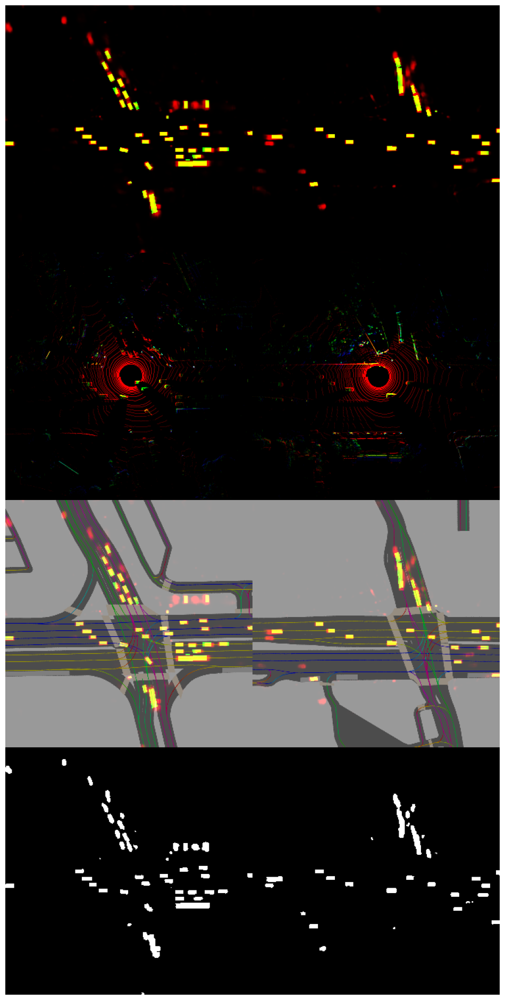

Mean loss: 0.05466253


In [78]:
#This code is executing the validation loss, gives a prediction array and target array for all validation samples. 

progress_bar = tqdm_notebook(validation_dataloader)

targets = np.zeros((len(target_filepaths), 336, 336), dtype=np.uint8)

# We quantize to uint8 here to conserve memory. We're allocating >20GB of memory otherwise.
predictions = np.zeros((len(target_filepaths), 1+len(classes), 336, 336), dtype=np.uint8)

sample_tokens = []
all_losses = []

with torch.no_grad():
    model.eval()
    for ii, (X, target, batch_sample_tokens) in enumerate(progress_bar):

        offset = ii*batch_size
        targets[offset:offset+batch_size] = target.numpy()
        sample_tokens.extend(batch_sample_tokens)
        
        X = X.to(device)  # [N, 1, H, W]
        target = target.to(device)  # [N, H, W] with class indices (0, 1)
        prediction = model(X)  # [N, 2, H, W]
        loss = F.cross_entropy(prediction, target, weight=class_weights)
        all_losses.append(loss.detach().cpu().numpy())
        
        prediction = F.softmax(prediction, dim=1)
        
        prediction_cpu = prediction.cpu().numpy()
        predictions[offset:offset+batch_size] = np.round(prediction_cpu*255).astype(np.uint8)
        
        # Visualize the first prediction
        if ii == 0:
            visualize_predictions(X, prediction, target, apply_softmax=False)
            
print("Mean loss:", np.mean(all_losses))

  0%|          | 0/315 [00:00<?, ?it/s]

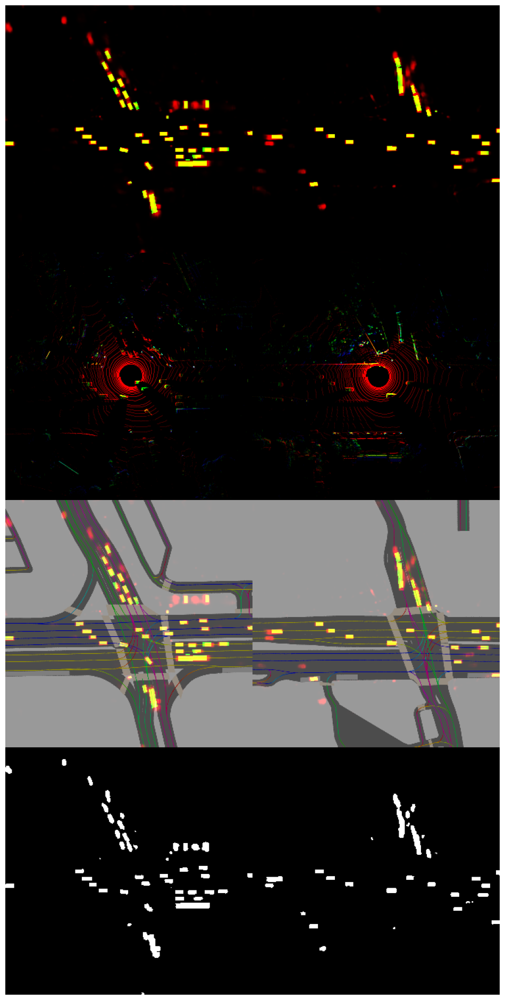

Mean Loss: 0.05466253
Mean IoU: 0.3668823746527085
Mean Dice Score: 0.3872881789889868


In [79]:
#Try modified script to include other metrics

def calculate_iou(pred, target, num_classes):
    """
    Calculates the Intersection over Union (IoU) for each class.
    """
    ious = []
    for cls in range(num_classes):
        pred_cls = (pred == cls)
        target_cls = (target == cls)
        intersection = (pred_cls & target_cls).sum()
        union = (pred_cls | target_cls).sum()
        if union == 0:
            ious.append(float('nan'))  # Handle cases with no ground truth or prediction
        else:
            ious.append(intersection / union)
    return np.nanmean(ious)  # Ignore NaNs for classes not present

def calculate_dice(pred, target, num_classes):
    """
    Calculates the Dice Coefficient for each class.
    """
    dices = []
    for cls in range(num_classes):
        pred_cls = (pred == cls)
        target_cls = (target == cls)
        intersection = (pred_cls & target_cls).sum()
        dice = (2 * intersection) / (pred_cls.sum() + target_cls.sum() + 1e-6)  # Add small value to avoid division by zero
        dices.append(dice)
    return np.mean(dices)

# Initialize storage
progress_bar = tqdm(validation_dataloader)

targets = np.zeros((len(target_filepaths), 336, 336), dtype=np.uint8)
predictions = np.zeros((len(target_filepaths), 1+len(classes), 336, 336), dtype=np.uint8)
sample_tokens = []
all_losses = []
ious = []
dice_scores = []

# Perform validation
with torch.no_grad():
    model.eval()
    for ii, (X, target, batch_sample_tokens) in enumerate(progress_bar):

        offset = ii * batch_size
        targets[offset:offset+batch_size] = target.numpy()
        sample_tokens.extend(batch_sample_tokens)
        
        X = X.to(device)
        target = target.to(device)
        prediction = model(X)
        
        # Loss
        loss = F.cross_entropy(prediction, target, weight=class_weights)
        all_losses.append(loss.detach().cpu().numpy())
        
        # Prediction
        prediction = F.softmax(prediction, dim=1)
        prediction_cpu = prediction.cpu().numpy()
        predictions[offset:offset+batch_size] = np.round(prediction_cpu * 255).astype(np.uint8)

        # Metrics
        pred_classes = np.argmax(prediction_cpu, axis=1)
        ious.append(calculate_iou(pred_classes, target.cpu().numpy(), len(classes)+1))
        dice_scores.append(calculate_dice(pred_classes, target.cpu().numpy(), len(classes)+1))
        
        # Visualization for the first batch
        if ii == 0:
            visualize_predictions(X, prediction, target, apply_softmax=False)

# Results
print("Mean Loss:", np.mean(all_losses))
print("Mean IoU:", np.nanmean(ious))
print("Mean Dice Score:", np.mean(dice_scores))


In [80]:
# Get probabilities for non-background
predictions_non_class0 = 255 - predictions[:,0]

The chunk below visualizes the predictions and compares them to the ground truth.

The first subplot displays predictions as confidence scores (colors).
The second subplot displays the binary threshold version of predictions. 
The third subplot displays the ground truth binary mask.

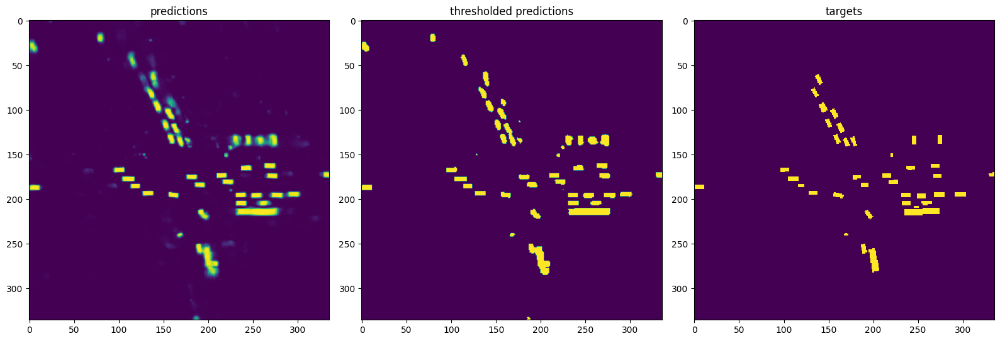

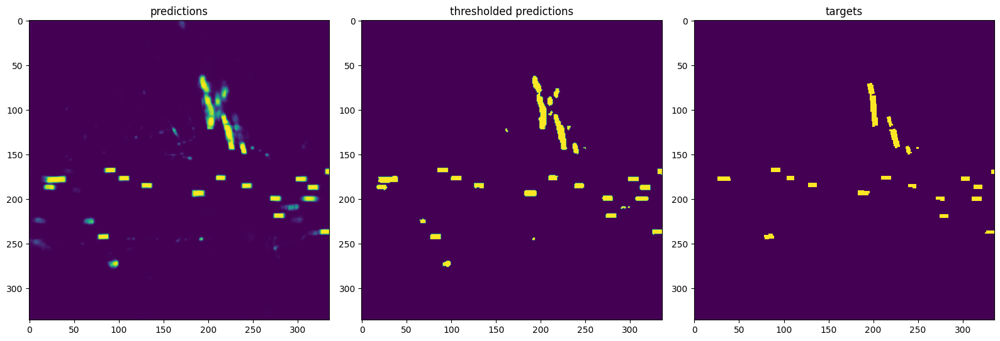

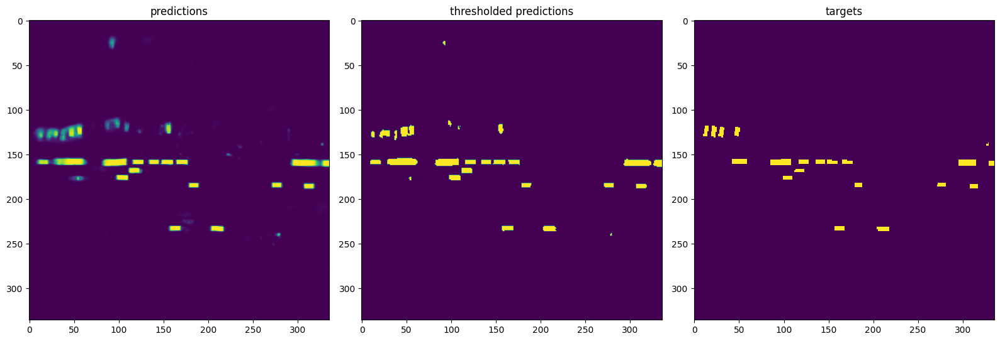

In [81]:
# Arbitrary threshold in our system to create a binary image to fit boxes around.
background_threshold = 255//2

for i in range(3):
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(16, 6))
    axes[0].imshow(predictions_non_class0[i])
    axes[0].set_title("predictions")
    axes[1].imshow(predictions_non_class0[i] > background_threshold)
    axes[1].set_title("thresholded predictions")
    axes[2].imshow((targets[i] > 0).astype(np.uint8), interpolation="nearest")
    axes[2].set_title("targets")
    fig.tight_layout()
    fig.show()

  0%|          | 0/5040 [00:00<?, ?it/s]

<Figure size 1200x1200 with 0 Axes>

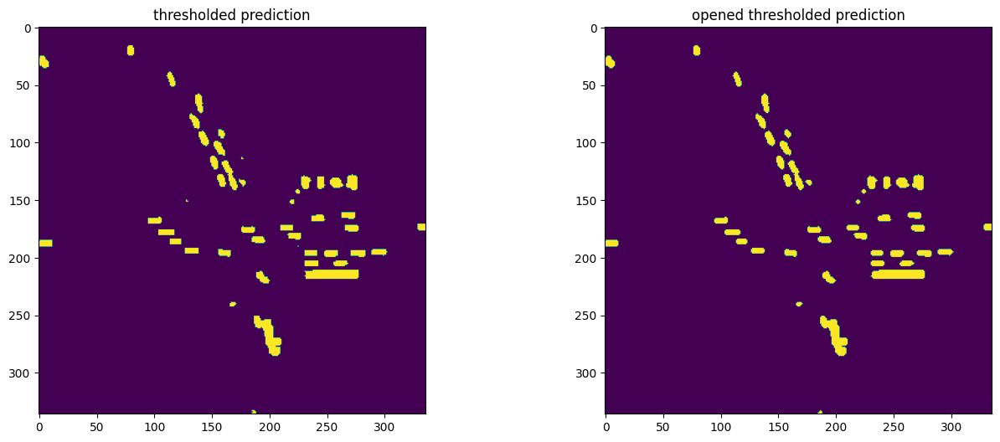

In [82]:
# We perform an opening morphological operation to filter tiny, isolated detections - designed to remove noise
# Note that this may be problematic for classes that are inherently small (e.g. pedestrians)..
#The left plot shows the raw prediction, the right shows the cleaned prediction - look just below 150 marker on the leftside axis to see the effect.
#Purpose: Reduce false positives
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
predictions_opened = np.zeros((predictions_non_class0.shape), dtype=np.uint8)

for i, p in enumerate(tqdm(predictions_non_class0)):
    thresholded_p = (p > background_threshold).astype(np.uint8)
    predictions_opened[i] = cv2.morphologyEx(thresholded_p, cv2.MORPH_OPEN, kernel)

plt.figure(figsize=(12,12))
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))
axes[0].imshow(predictions_non_class0[0] > 255//2)
axes[0].set_title("thresholded prediction")
axes[1].imshow(predictions_opened[0])
axes[1].set_title("opened thresholded prediction")
fig.show()

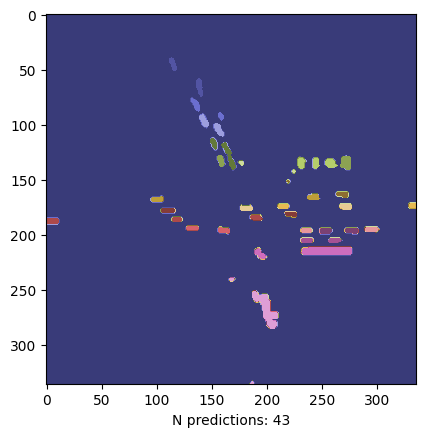

In [83]:
# Sanity check: let's count the amount of connected components in an image
#Each unique object detected will have a unique color in the below graph. 
labels, n = scipy.ndimage.label(predictions_opened[0])
plt.imshow(labels, cmap="tab20b")
plt.xlabel("N predictions: {}".format(n))
plt.show()

The code below extracts the predicted bounding boxes from the prediction maps and assigns confidence scores and classes to each box. Boxes with low confidence scores are ignored (less than .01 confidence). Note that the confidence scores are on a scale of 0-255 for visualization purposes, rather than the 0-1 softmax scale. The distribution is bimodal with peaks around 0 (probability near 0) and 250 (almost a 1.0 probability). 

/tmp/ipykernel_149/790364554.py:5: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm_notebook(range(len(predictions))):


  0%|          | 0/5040 [00:00<?, ?it/s]

/tmp/ipykernel_149/790364554.py:22: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box_center_index = np.int0(np.mean(box, axis=0))


Total amount of boxes: 207539


/tmp/ipykernel_149/790364554.py:48: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  box_pix = np.int0(sample_boxes)


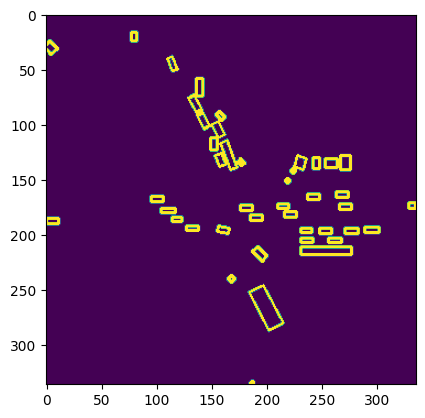

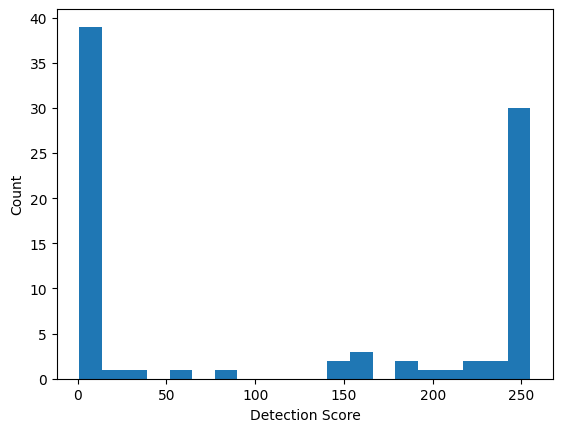

In [84]:
detection_boxes = []
detection_scores = []
detection_classes = []

for i in tqdm_notebook(range(len(predictions))):
    prediction_opened = predictions_opened[i]
    probability_non_class0 = predictions_non_class0[i]
    class_probability = predictions[i]

    sample_boxes = []
    sample_detection_scores = []
    sample_detection_classes = []
    
    contours, hierarchy = cv2.findContours(prediction_opened, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
 
    
    for cnt in contours:
        rect = cv2.minAreaRect(cnt)
        box = cv2.boxPoints(rect)
        
        # Let's take the center pixel value as the confidence value
        box_center_index = np.int0(np.mean(box, axis=0))
        
        for class_index in range(len(classes)):
            box_center_value = class_probability[class_index+1, box_center_index[1], box_center_index[0]]
            
            # Let's remove candidates with very low probability
            if box_center_value < 0.01:
                continue
            
            box_center_class = classes[class_index]

            box_detection_score = box_center_value
            sample_detection_classes.append(box_center_class)
            sample_detection_scores.append(box_detection_score)
            sample_boxes.append(box)
        
    
    detection_boxes.append(np.array(sample_boxes))
    detection_scores.append(sample_detection_scores)
    detection_classes.append(sample_detection_classes)
    
print("Total amount of boxes:", np.sum([len(x) for x in detection_boxes]))

# Visualize the boxes in the first sample
t = np.zeros_like(predictions_opened[0])
for sample_boxes in detection_boxes[0]:
    box_pix = np.int0(sample_boxes)
    cv2.drawContours(t,[box_pix],0,(255),2)
plt.imshow(t)
plt.show()

# Visualize their probabilities
plt.hist(detection_scores[0], bins=20)
plt.xlabel("Detection Score")
plt.ylabel("Count")
plt.show()


In [85]:
#Retrieves annotation tokens from each sample and extracts groung truth bounding boxes. 
#Returns a list of 3D object containing ground truth boxes and annotations


from lyft_dataset_sdk.eval.detection.mAP_evaluation import Box3D, recall_precision

def load_groundtruth_boxes(nuscenes, sample_tokens):
    gt_box3ds = []

    # Load annotations and filter predictions and annotations.
    for sample_token in tqdm_notebook(sample_tokens):

        sample = nuscenes.get('sample', sample_token)
        sample_annotation_tokens = sample['anns']

        sample_lidar_token = sample["data"]["LIDAR_TOP"]
        lidar_data = lyft_data.get("sample_data", sample_lidar_token)
        ego_pose = lyft_data.get("ego_pose", lidar_data["ego_pose_token"])
        ego_translation = np.array(ego_pose['translation'])
        
        for sample_annotation_token in sample_annotation_tokens:
            sample_annotation = nuscenes.get('sample_annotation', sample_annotation_token)
            sample_annotation_translation = sample_annotation['translation']
            
            class_name = sample_annotation['category_name']
            
            box3d = Box3D(
                sample_token=sample_token,
                translation=sample_annotation_translation,
                size=sample_annotation['size'],
                rotation=sample_annotation['rotation'],
                name=class_name
            )
            gt_box3ds.append(box3d)
            
    return gt_box3ds

gt_box3ds = load_groundtruth_boxes(lyft_data, sample_tokens)

/tmp/ipykernel_149/3558599109.py:11: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for sample_token in tqdm_notebook(sample_tokens):


  0%|          | 0/5040 [00:00<?, ?it/s]

In [86]:
#Generate 3D bounding boxes for detected objects based on predictions from the model.
#Iterating through predictions and transforming them to 3D objects (assumes ground level for all boxes)
#Moving the 3D boxes from voxel space to global coordinates
#Calculating 3D bounding box dimensions (l,w)
#Assigns class
#Appends created objects to pred_box3ds list


from scipy.spatial.transform import Rotation as R
pred_box3ds = []

# This could use some refactoring..
for (sample_token, sample_boxes, sample_detection_scores, sample_detection_class) in tqdm_notebook(zip(sample_tokens, detection_boxes, detection_scores, detection_classes), total=len(sample_tokens)):
    sample_boxes = sample_boxes.reshape(-1, 2) # (N, 4, 2) -> (N*4, 2)
    sample_boxes = sample_boxes.transpose(1,0) # (N*4, 2) -> (2, N*4)

    # Add Z dimension
    sample_boxes = np.vstack((sample_boxes, np.zeros(sample_boxes.shape[1]),)) # (2, N*4) -> (3, N*4)

    sample = lyft_data.get("sample", sample_token)
    sample_lidar_token = sample["data"]["LIDAR_TOP"]
    lidar_data = lyft_data.get("sample_data", sample_lidar_token)
    lidar_filepath = lyft_data.get_sample_data_path(sample_lidar_token)
    ego_pose = lyft_data.get("ego_pose", lidar_data["ego_pose_token"])
    ego_translation = np.array(ego_pose['translation'])

    global_from_car = transform_matrix(ego_pose['translation'],
                                       Quaternion(ego_pose['rotation']), inverse=False)

    car_from_voxel = np.linalg.inv(create_transformation_matrix_to_voxel_space(bev_shape, voxel_size, (0, 0, z_offset)))


    global_from_voxel = np.dot(global_from_car, car_from_voxel)
    sample_boxes = transform_points(sample_boxes, global_from_voxel)

    # We don't know at where the boxes are in the scene on the z-axis (up-down), let's assume all of them are at
    # the same height as the ego vehicle.
    sample_boxes[2,:] = ego_pose["translation"][2]


    # (3, N*4) -> (N, 4, 3)
    sample_boxes = sample_boxes.transpose(1,0).reshape(-1, 4, 3)


    # We don't know the height of our boxes, let's assume every object is the same height.
    box_height = 1.75

    # Note: Each of these boxes describes the ground corners of a 3D box.
    # To get the center of the box in 3D, we'll have to add half the height to it.
    sample_boxes_centers = sample_boxes.mean(axis=1)
    sample_boxes_centers[:,2] += box_height/2

    # Width and height is arbitrary - we don't know what way the vehicles are pointing from our prediction segmentation
    # It doesn't matter for evaluation, so no need to worry about that here.
    # Note: We scaled our targets to be 0.8 the actual size, we need to adjust for that
    sample_lengths = np.linalg.norm(sample_boxes[:,0,:] - sample_boxes[:,1,:], axis=1) * 1/box_scale
    sample_widths = np.linalg.norm(sample_boxes[:,1,:] - sample_boxes[:,2,:], axis=1) * 1/box_scale
    
    sample_boxes_dimensions = np.zeros_like(sample_boxes_centers) 
    sample_boxes_dimensions[:,0] = sample_widths
    sample_boxes_dimensions[:,1] = sample_lengths
    sample_boxes_dimensions[:,2] = box_height

    for i in range(len(sample_boxes)):
        translation = sample_boxes_centers[i]
        size = sample_boxes_dimensions[i]
        class_name = sample_detection_class[i]
        ego_distance = float(np.linalg.norm(ego_translation - translation))
    
        
        # Determine the rotation of the box
        v = (sample_boxes[i,0] - sample_boxes[i,1])
        v /= np.linalg.norm(v)
     

        r = R.from_matrix([
        [v[0], -v[1], 0],
        [v[1],  v[0], 0],
        [   0,     0, 1],
        ])
        
        quat = r.as_quat()
        # XYZW -> WXYZ order of elements
        quat = quat[[3,0,1,2]]
        
        detection_score = float(sample_detection_scores[i])

        
        box3d = Box3D(
            sample_token=sample_token,
            translation=list(translation),
            size=list(size),
            rotation=list(quat),
            name=class_name,
            score=detection_score
        )
        pred_box3ds.append(box3d)

/tmp/ipykernel_149/3276866079.py:13: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for (sample_token, sample_boxes, sample_detection_scores, sample_detection_class) in tqdm_notebook(zip(sample_tokens, detection_boxes, detection_scores, detection_classes), total=len(sample_tokens)):


  0%|          | 0/5040 [00:00<?, ?it/s]

In [88]:
#Serializing prediction boxes and ground truth into a dictionary JSON format
#JSON files can be used to evaluate predictions

import json

gt = [b.serialize() for b in gt_box3ds]

pred = [b.serialize() for b in pred_box3ds]

In [89]:
#Saves the JSON files to ARTIFACTS folder.

with open(os.path.join(ARTIFACTS_FOLDER, "gt.json"), "w") as f:
    json.dump(gt, f)

with open(os.path.join(ARTIFACTS_FOLDER, "pred.json"), "w") as f:
    json.dump(pred, f)

Prepare the Test Data

NEXT STEPS:
1. Download ARTIFACTS.zip to be used in other developmental notebooks. This fodler contains model inputs, ground truth, prediction boxes, and the best UNET model from this script. This script takes a few hours to run on its own, so this saves a lot of time each session.
2. Try ensemble methods with the current working model.